# 2.1

Visualizing mask and image: 02_00_000.png


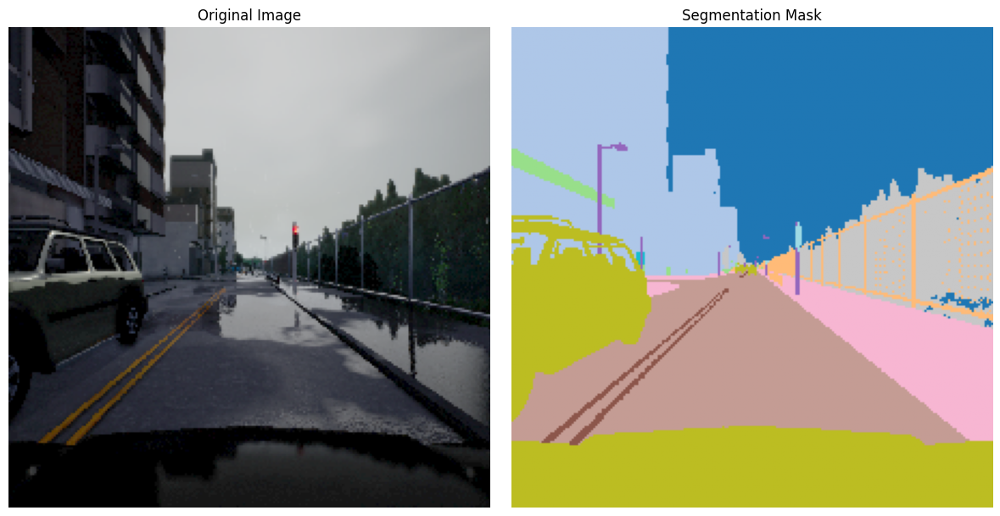

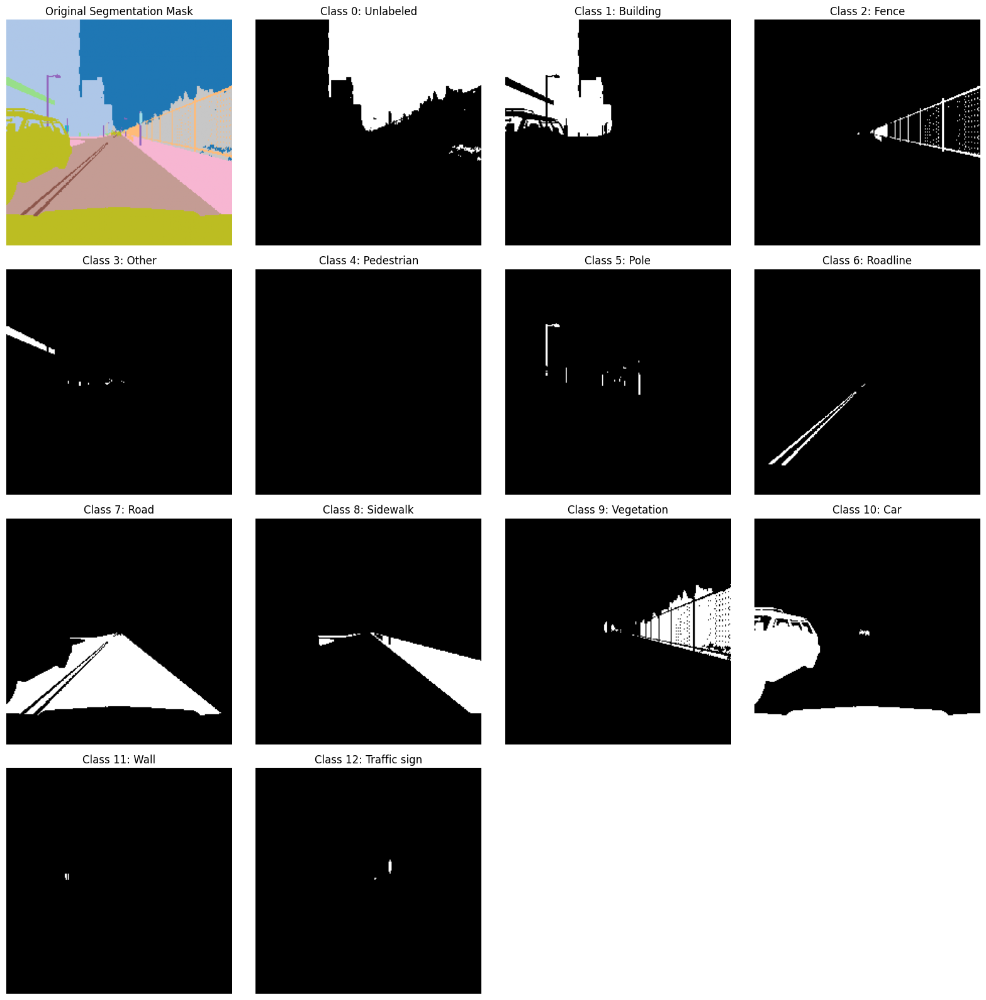

Visualizing mask and image: 02_01_000.png


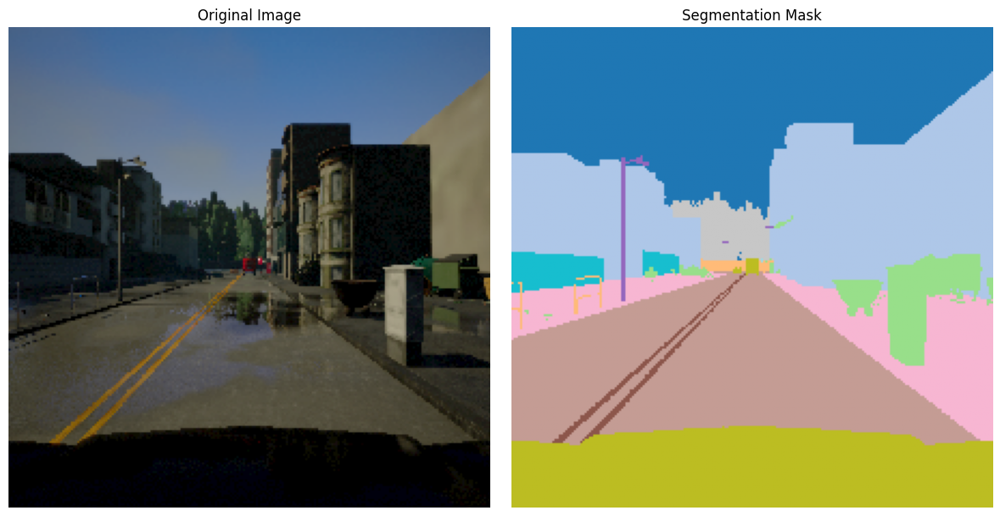

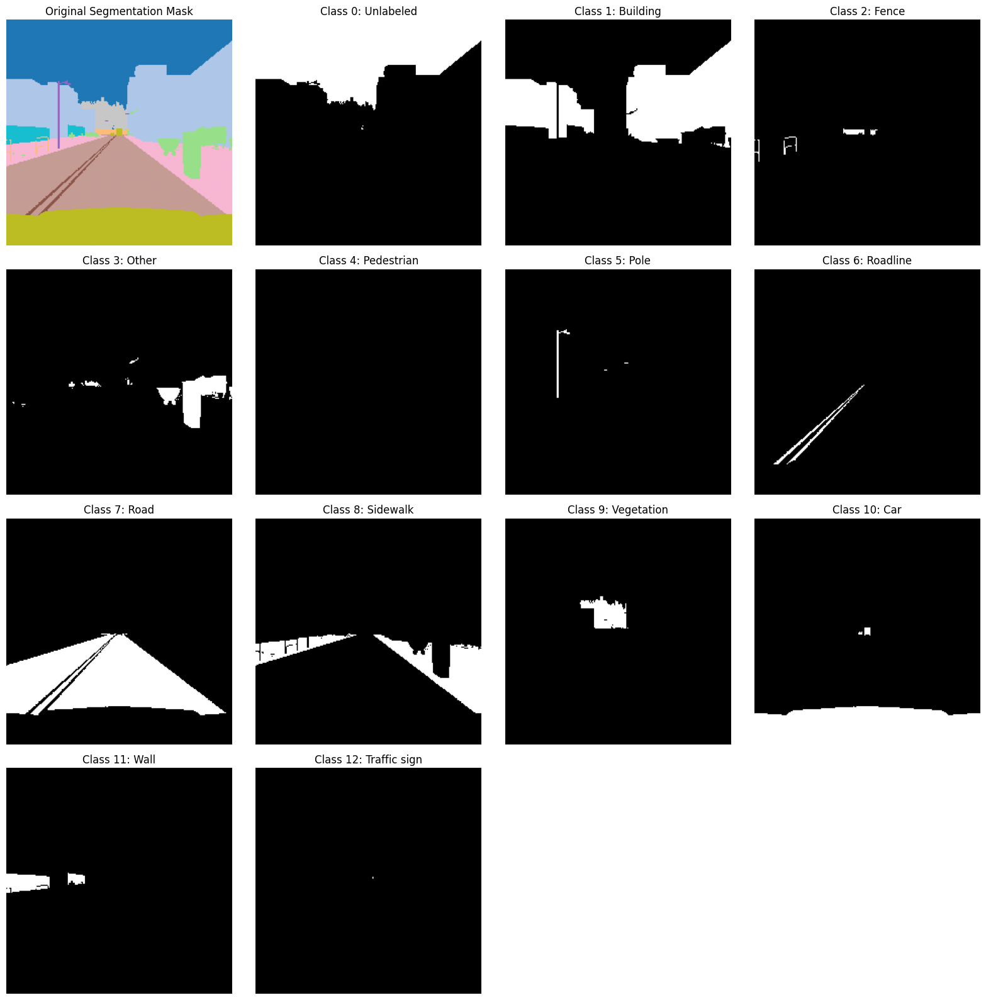

Visualizing mask and image: 02_02_000.png


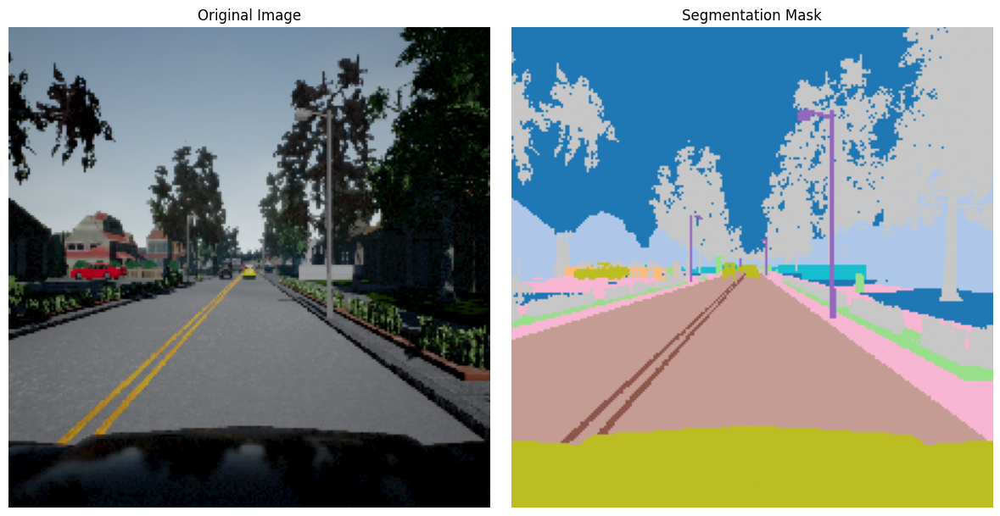

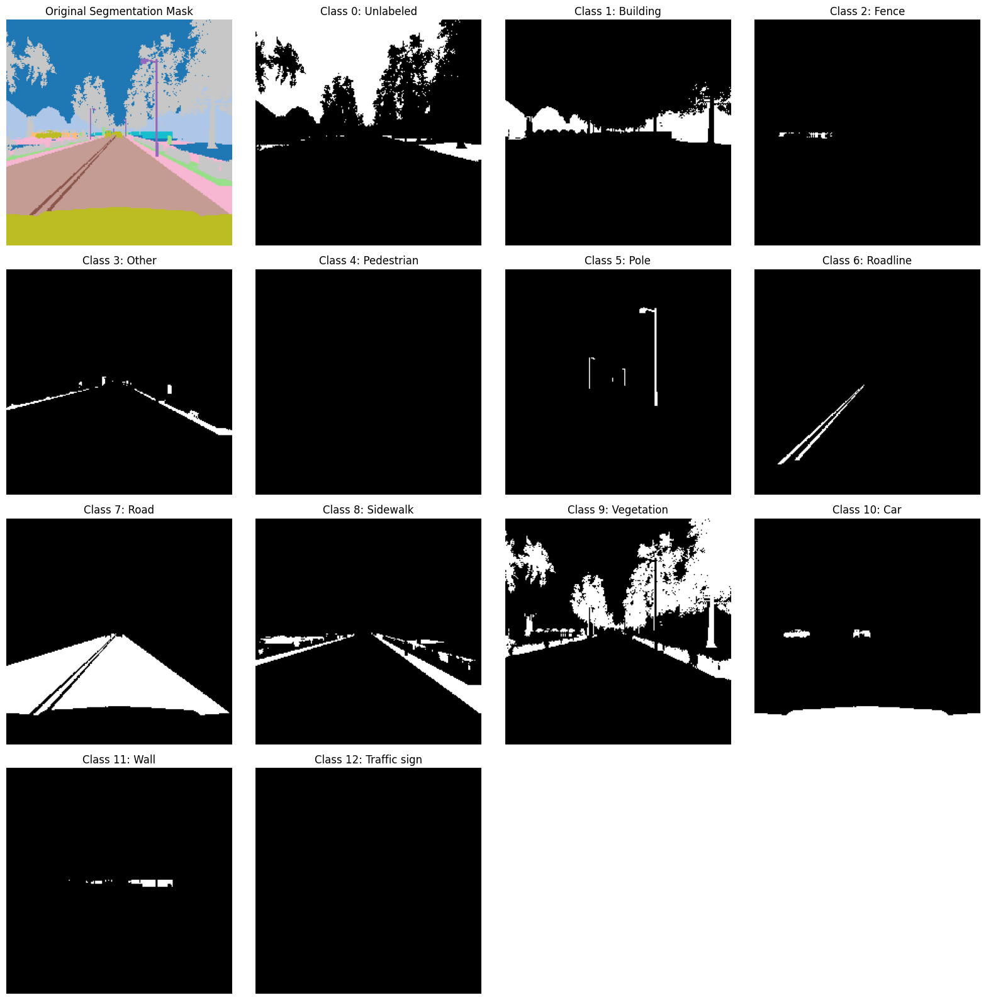

Visualizing mask and image: 03_00_000.png


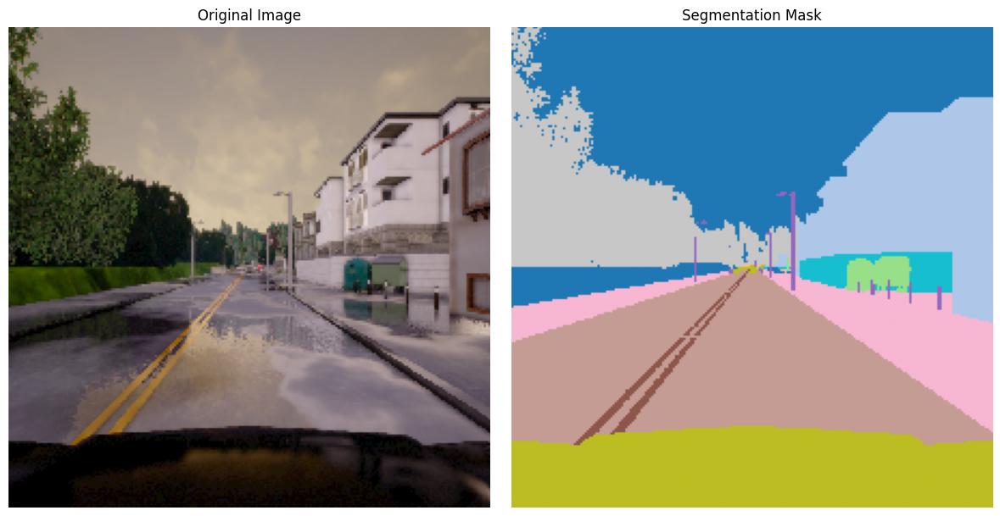

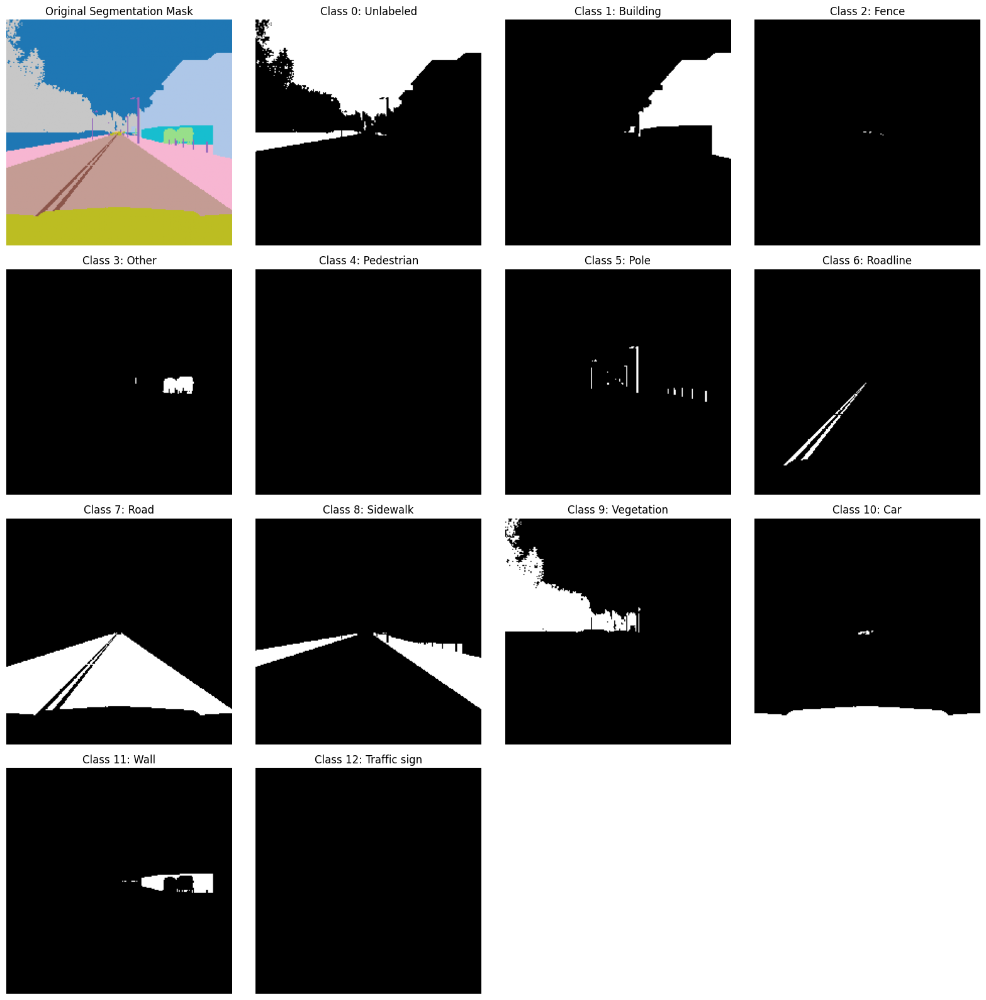

Visualizing mask and image: 03_01_000.png


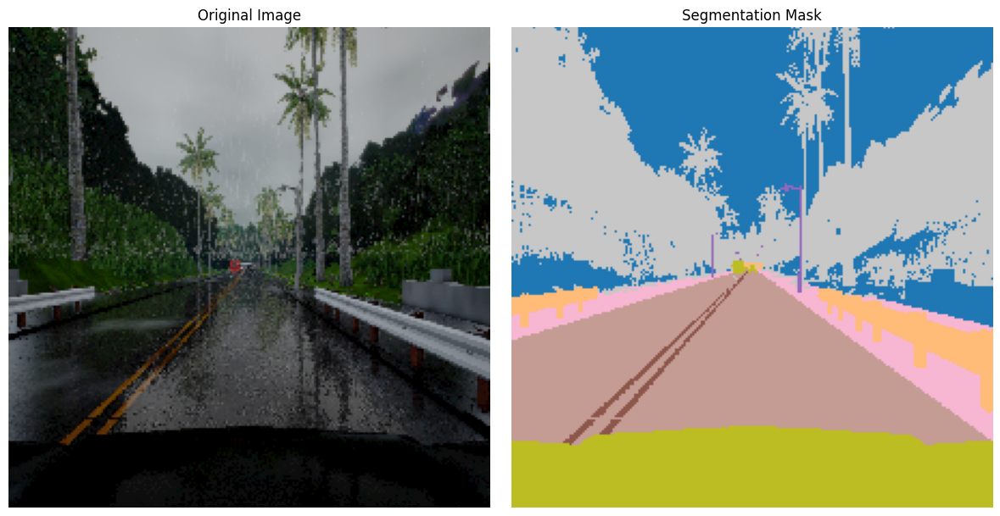

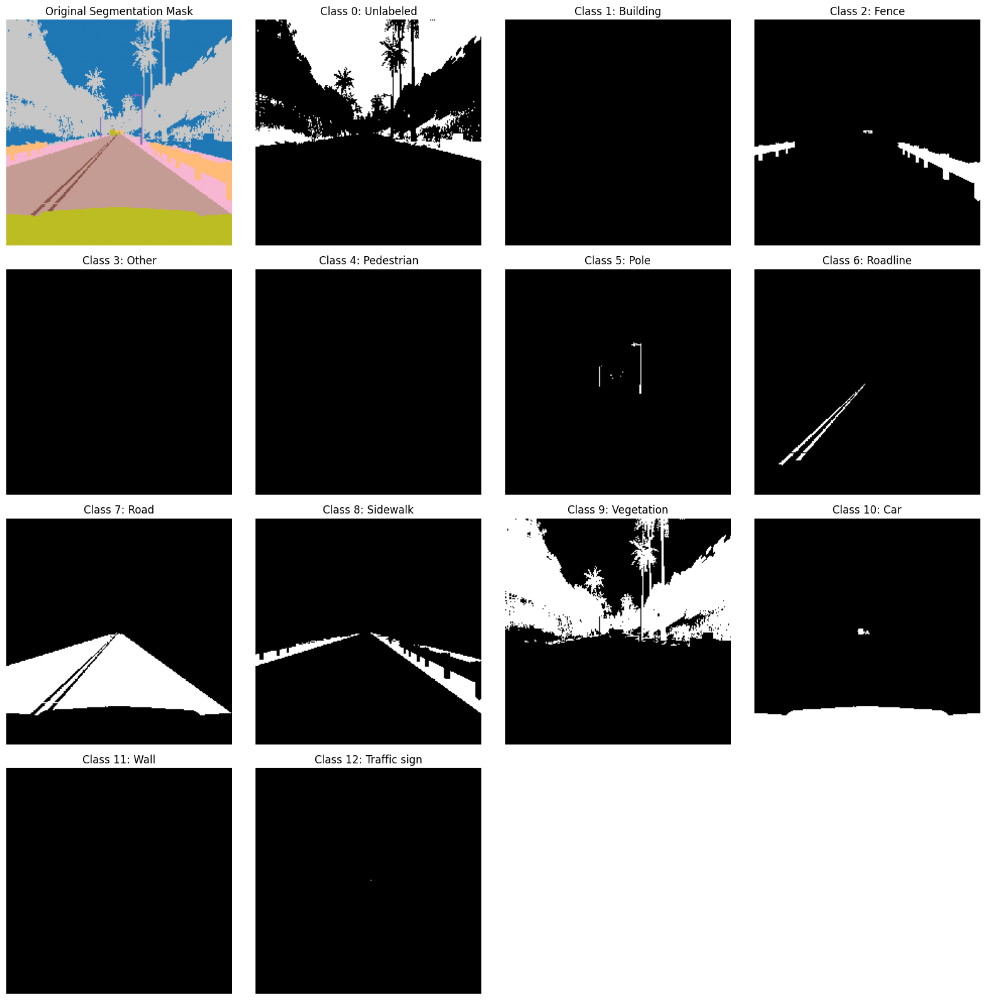

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
import random
import torch
from matplotlib.colors import ListedColormap

# Define class names
class_names = [
    "Unlabeled", "Building", "Fence", "Other", "Pedestrian", "Pole",
    "Roadline", "Road", "Sidewalk", "Vegetation", "Car", "Wall", "Traffic sign"
]

def visualize_segmentation_classes(mask_path):
    """
    Function to visualize each class in a segmentation mask.
    
    Args:
        mask_path (str): Path to the segmentation mask image.
    """
    # Read the mask image
    mask = np.array(Image.open(mask_path))
    
    # Extract the first channel if the mask has multiple channels
    if len(mask.shape) > 2:
        class_ids = mask[:, :, 0]
    else:
        class_ids = mask
    
    # Create a figure for visualization
    num_classes = len(class_names)
    rows = 4
    cols = 4
    fig, axes = plt.subplots(rows, cols, figsize=(16, 16))
    axes = axes.flatten()
    
    # Create a colormap for the mask to visualize the original segmentation
    colors = plt.cm.tab20(np.linspace(0, 1, num_classes))
    custom_cmap = ListedColormap(colors)
    
    # Add original mask to the visualization
    colored_mask = custom_cmap(class_ids)
    axes[0].imshow(colored_mask)
    axes[0].set_title("Original Segmentation Mask")
    axes[0].axis('off')
    
    # Visualize each class as a binary mask
    for class_id in range(num_classes):
        # Create binary mask for this class
        binary_mask = (class_ids == class_id).astype(np.uint8) * 255
        
        # Visualize
        ax_idx = class_id + 1
        if ax_idx < len(axes):
            axes[ax_idx].imshow(binary_mask, cmap='gray')
            axes[ax_idx].set_title(f"Class {class_id}: {class_names[class_id]}")
            axes[ax_idx].axis('off')
    
    # Hide empty subplots
    for i in range(num_classes + 1, len(axes)):
        fig.delaxes(axes[i])
    
    plt.tight_layout()
    plt.show()

def visualize_image_with_mask(image_path, mask_path):
    """
    Function to visualize an image alongside its segmentation mask.
    
    Args:
        image_path (str): Path to the input image.
        mask_path (str): Path to the segmentation mask image.
    """
    # Read the image and mask
    image = np.array(Image.open(image_path))
    mask = np.array(Image.open(mask_path))
    
    # Extract the first channel if the mask has multiple channels
    if len(mask.shape) > 2:
        class_ids = mask[:, :, 0]
    else:
        class_ids = mask
    
    # Create a figure for visualization
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Display image
    axes[0].imshow(image)
    axes[0].set_title("Original Image")
    axes[0].axis('off')
    
    # Create a colormap for the mask
    colors = plt.cm.tab20(np.linspace(0, 1, len(class_names)))
    custom_cmap = ListedColormap(colors)
    
    # Display colored mask
    colored_mask = custom_cmap(class_ids)
    axes[1].imshow(colored_mask)
    axes[1].set_title("Segmentation Mask")
    axes[1].axis('off')
    
    plt.tight_layout()
    plt.show()


# Use a sample from the dataset
dataset_path = "dataset_224"
# dataset_path = "/kaggle/input/q1-data/dataset_224"
train_images_path = os.path.join(dataset_path, "train", "images")
train_labels_path = os.path.join(dataset_path, "train", "labels")

# List all files in the train labels directory
mask_files = sorted(os.listdir(train_labels_path))
if not mask_files:
    print("No mask files found in the directory.")
else:
    # Choose a sample mask file 
    for i in range(5):
        sample_mask_file = mask_files[i*100]
        sample_mask_path = os.path.join(train_labels_path, sample_mask_file)
        

        sample_image_path = os.path.join(train_images_path, sample_mask_file)
        
        print(f"Visualizing mask and image: {sample_mask_file}")
        
        # Display the image alongside its mask
        visualize_image_with_mask(sample_image_path, sample_mask_path)
        
        # Visualize each class in the segmentation mask
        visualize_segmentation_classes(sample_mask_path)

# 2.2

## 2.2.1 and 2.2.2

In [ ]:
import os
import time
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from torchvision import models, transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torch.nn.functional as F
from tqdm import tqdm
from torch.cuda.amp import autocast, GradScaler

# Define constants
NUM_CLASSES = 13
IMAGE_SIZE = 224
BATCH_SIZE = 16
LEARNING_RATE = 0.001
NUM_EPOCHS = 30

if torch.cuda.is_available():
    DEVICE = torch.device("cuda")
    print(f"Using CUDA device: {torch.cuda.get_device_name(0)}")
    print(f"Available GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
else:
    DEVICE = torch.device("cpu")
    print(f"CUDA not available, using CPU")

# Define class names
class_names = [
    "Unlabeled", "Building", "Fence", "Other", "Pedestrian", "Pole",
    "Roadline", "Road", "Sidewalk", "Vegetation", "Car", "Wall", "Traffic sign"
]

# Create a custom dataset class
class SegmentationDataset(Dataset):
    def __init__(self, images_dir, masks_dir, transform=None):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.transform = transform
        self.images = sorted(os.listdir(images_dir))
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        img_name = self.images[idx]
        image_path = os.path.join(self.images_dir, img_name)
        mask_path = os.path.join(self.masks_dir, img_name)
        
        image = Image.open(image_path).convert("RGB")
        mask = Image.open(mask_path)
        
        # Extract the first channel if the mask has multiple channels
        mask_np = np.array(mask)
        if len(mask_np.shape) > 2:
            mask_np = mask_np[:, :, 0]
        
        mask = Image.fromarray(mask_np)
        
        if self.transform:
            image = self.transform(image)
            # Convert mask to tensor manually
            mask = torch.from_numpy(np.array(mask)).long()
        
        return image, mask

# Define transformations
train_transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Load datasets
def get_dataloaders(batch_size=BATCH_SIZE, num_workers=4): 
    dataset_path = "dataset_224"
    # dataset_path = "/kaggle/input/q1-data/dataset_224"
    
    # Create training dataset
    train_images_dir = os.path.join(dataset_path, "train", "images")
    train_masks_dir = os.path.join(dataset_path, "train", "labels")
    train_dataset = SegmentationDataset(train_images_dir, train_masks_dir, transform=train_transform)
    
    # Create test dataset
    test_images_dir = os.path.join(dataset_path, "test", "images")
    test_masks_dir = os.path.join(dataset_path, "test", "labels")
    test_dataset = SegmentationDataset(test_images_dir, test_masks_dir, transform=train_transform)
    
    # Split training dataset into train and validation
    train_size = int(0.8 * len(train_dataset))
    val_size = len(train_dataset) - train_size
    train_dataset, val_dataset = torch.utils.data.random_split(train_dataset, [train_size, val_size])
    
    # Create data loaders 
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=num_workers)
    
    return train_loader, val_loader, test_loader


# Add this function to calculate additional metrics
def compute_metrics(pred, target, num_classes=NUM_CLASSES):
    """
    Compute IoU, pixel accuracy and class accuracy metrics
    """
    pred = pred.view(-1)
    target = target.view(-1)
    
    # IoU calculation (as before)
    ious = []
    # Pixel accuracy
    pixel_acc = (pred == target).sum().float() / target.numel()
    
    # Per-class metrics
    class_metrics = {}
    
    for cls in range(1, num_classes):  # Skip unlabeled class
        pred_inds = pred == cls
        target_inds = target == cls
        
        # Class accuracy - precision
        if pred_inds.sum() > 0:
            class_precision = (pred_inds & target_inds).sum().float() / pred_inds.sum().float()
        else:
            class_precision = torch.tensor(0.0).to(pred.device)
            
        # Class recall
        if target_inds.sum() > 0:
            class_recall = (pred_inds & target_inds).sum().float() / target_inds.sum().float()
        else:
            class_recall = torch.tensor(0.0).to(pred.device)
            
        # IoU for this class
        if (pred_inds | target_inds).sum() > 0:
            class_iou = (pred_inds & target_inds).sum().float() / (pred_inds | target_inds).sum().float()
        else:
            class_iou = torch.tensor(float('nan')).to(pred.device)
            
        class_metrics[cls] = {
            'precision': class_precision.item(),
            'recall': class_recall.item(),
            'iou': class_iou.item() if not torch.isnan(class_iou) else 0.0
        }
    
    # Compute mean IoU (excluding NaN values)
    valid_ious = [m['iou'] for m in class_metrics.values() if not np.isnan(m['iou'])]
    mean_iou = np.mean(valid_ious) if valid_ious else 0.0
    
    # Compute mean accuracy
    mean_acc = np.mean([m['precision'] for m in class_metrics.values()])
    
    return {
        'pixel_acc': pixel_acc.item(),
        'mean_acc': mean_acc,
        'mean_iou': mean_iou,
        'class_metrics': class_metrics
    }


# Custom IoU metric implementation
def compute_iou(pred, target, num_classes=NUM_CLASSES):
    """
    Compute the mean Intersection over Union (mIoU)
    pred: tensor of shape (B, H, W) containing predicted class indices
    target: tensor of shape (B, H, W) containing ground truth class indices
    """
    ious = []
    pred = pred.view(-1)
    target = target.view(-1)
    
    # Ignore unlabeled class (0)
    for cls in range(1, num_classes):
        pred_inds = pred == cls
        target_inds = target == cls
        intersection = (pred_inds & target_inds).sum().float()
        union = (pred_inds | target_inds).sum().float()
        
        if union.item() == 0:
            ious.append(float('nan'))  # Avoid division by zero
        else:
            ious.append((intersection / union).item())
    
    # Filter out NaN values before computing mean
    valid_ious = [iou for iou in ious if not np.isnan(iou)]
    if len(valid_ious) == 0:
        return 0.0
    return np.mean(valid_ious)

# VGG16 weights issue fix for Pytorch 2.0+
def get_vgg16_model(pretrained=True):
    try:
        # Try with new method
        if pretrained:
            vgg16 = models.vgg16(weights=models.VGG16_Weights.DEFAULT)
            print("Downloaded VGG16 weights using new weights parameter")
        else:
            vgg16 = models.vgg16(weights=None)
    except Exception as e:
        # Try with old method
        try:
            vgg16 = models.vgg16(pretrained=pretrained)
            print("Downloaded VGG16 weights using legacy method")
        except Exception as e:
            print(f"Error loading VGG16 weights: {e}")
            print("Using randomly initialized weights")
            vgg16 = models.vgg16(pretrained=False)
    return vgg16

# FCN Models Implementation
class FCN32s(nn.Module):
    def __init__(self, pretrained=True, requires_grad=True, num_classes=NUM_CLASSES):
        super().__init__()
        vgg_model = get_vgg16_model(pretrained=pretrained)
        
        # Extract feature layers from VGG16
        self.features = vgg_model.features
        
        # Freeze or unfreeze backbone based on requires_grad
        for param in self.features.parameters():
            param.requires_grad = requires_grad
            
        # FCN-32s specific layers
        self.classifier = nn.Sequential(
            nn.Conv2d(512, 4096, kernel_size=7, padding=3),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, 4096, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, num_classes, kernel_size=1)
        )
        
        # Upsampling (32x)
        self.upsampling = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=64, stride=32, padding=16)
    
    def forward(self, x):
        # Original input size
        input_size = x.size()[2:]
        
        # Get features
        features = self.features(x)
        
        # Apply classifier
        out = self.classifier(features)
        
        # Upsample to original size
        out = self.upsampling(out)
        
        # Crop to match input size exactly
        out = F.interpolate(out, size=input_size, mode='bilinear', align_corners=False)
        
        return out

class FCN16s(nn.Module):
    def __init__(self, pretrained=True, requires_grad=True, num_classes=NUM_CLASSES):
        super().__init__()
        vgg_model = get_vgg16_model(pretrained=pretrained)
        
        # Extract feature layers from VGG16 and separate pool4
        self.features_low = nn.Sequential(*list(vgg_model.features.children())[:24])  # Before pool4
        self.features_high = nn.Sequential(*list(vgg_model.features.children())[24:])  # After pool4
        
        # Freeze or unfreeze backbone based on requires_grad
        for param in self.features_low.parameters():
            param.requires_grad = requires_grad
        for param in self.features_high.parameters():
            param.requires_grad = requires_grad
            
        # FCN-16s specific layers
        self.classifier = nn.Sequential(
            nn.Conv2d(512, 4096, kernel_size=7, padding=3),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, 4096, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, num_classes, kernel_size=1)
        )
        
        # Score pool4
        self.score_pool4 = nn.Conv2d(512, num_classes, kernel_size=1)
        
        # Upsampling (2x)
        self.upsample_2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
        
        # Upsampling (16x)
        self.upsample_16x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=32, stride=16, padding=8)
    
    def forward(self, x):
        # Original input size
        input_size = x.size()[2:]
        
        # Get features from lower part (before pool4)
        pool4_features = self.features_low(x)
        
        # Get features from higher part (after pool4)
        conv5_features = self.features_high(pool4_features)
        
        # Score from conv5
        score_conv5 = self.classifier(conv5_features)
        
        # Upsample conv5 score
        score_conv5_up = self.upsample_2x(score_conv5)
        
        # Score from pool4
        score_pool4 = self.score_pool4(pool4_features)
        
        # Crop score_pool4 to match score_conv5_up dimensions
        score_pool4_crop = score_pool4[:, :, :score_conv5_up.size()[2], :score_conv5_up.size()[3]]
        
        # Fuse scores
        fused_scores = score_conv5_up + score_pool4_crop
        
        # Upsample fused scores to original size
        out = self.upsample_16x(fused_scores)
        
        # Crop to match input size exactly
        out = F.interpolate(out, size=input_size, mode='bilinear', align_corners=False)
        
        return out

class FCN8s(nn.Module):
    def __init__(self, pretrained=True, requires_grad=True, num_classes=NUM_CLASSES):
        super().__init__()
        vgg_model = get_vgg16_model(pretrained=pretrained)
        
        # Extract feature layers from VGG16 and separate pool3, pool4
        self.features_pool3 = nn.Sequential(*list(vgg_model.features.children())[:17])  # Before pool3
        self.features_pool4 = nn.Sequential(*list(vgg_model.features.children())[17:24])  # Between pool3 and pool4
        self.features_pool5 = nn.Sequential(*list(vgg_model.features.children())[24:])  # After pool4
        
        # Freeze or unfreeze backbone based on requires_grad
        for param in self.features_pool3.parameters():
            param.requires_grad = requires_grad
        for param in self.features_pool4.parameters():
            param.requires_grad = requires_grad
        for param in self.features_pool5.parameters():
            param.requires_grad = requires_grad
            
        # FCN-8s specific layers
        self.classifier = nn.Sequential(
            nn.Conv2d(512, 4096, kernel_size=7, padding=3),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, 4096, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, num_classes, kernel_size=1)
        )
        
        # Score layers for pool3 and pool4
        self.score_pool4 = nn.Conv2d(512, num_classes, kernel_size=1)
        self.score_pool3 = nn.Conv2d(256, num_classes, kernel_size=1)
        
        # Upsampling layers
        self.upsample_2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
        self.upsample_8x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=16, stride=8, padding=4)
    
    def forward(self, x):
        # Original input size
        input_size = x.size()[2:]
        
        # Get features from different pools
        pool3_features = self.features_pool3(x)
        pool4_features = self.features_pool4(pool3_features)
        conv5_features = self.features_pool5(pool4_features)
        
        # Score from conv5
        score_conv5 = self.classifier(conv5_features)
        
        # Upsample conv5 score (2x)
        score_conv5_up = self.upsample_2x(score_conv5)
        
        # Score from pool4
        score_pool4 = self.score_pool4(pool4_features)
        
        # Crop score_pool4 to match score_conv5_up dimensions
        score_pool4_crop = score_pool4[:, :, :score_conv5_up.size()[2], :score_conv5_up.size()[3]]
        
        # Fuse scores from conv5 and pool4
        fused_score_4 = score_conv5_up + score_pool4_crop
        
        # Upsample fused score (2x)
        fused_score_4_up = self.upsample_2x(fused_score_4)
        
        # Score from pool3
        score_pool3 = self.score_pool3(pool3_features)
        
        # Crop score_pool3 to match fused_score_4_up dimensions
        score_pool3_crop = score_pool3[:, :, :fused_score_4_up.size()[2], :fused_score_4_up.size()[3]]
        
        # Fuse scores from conv5+pool4 and pool3
        fused_score_3 = fused_score_4_up + score_pool3_crop
        
        # Upsample to original size (8x)
        out = self.upsample_8x(fused_score_3)
        
        # Crop to match input size exactly
        out = F.interpolate(out, size=input_size, mode='bilinear', align_corners=False)
        
        return out

def count_parameters(model):
    """Count the number of trainable parameters in a model"""
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


# Training and evaluation functions
def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs=NUM_EPOCHS, model_name="FCN_model"):
    model.to(DEVICE)

    scaler = GradScaler()
    
    # Create a log file
    log_file = open(f"{model_name}_training_log.csv", "w")
    log_file.write("epoch,train_loss,val_loss,train_pixel_acc,val_pixel_acc,train_mean_acc,val_mean_acc,train_miou,val_miou\n")
    
    # History for plotting
    history = {
        'train_loss': [],
        'val_loss': [],
        'train_miou': [],
        'val_miou': [],
        'train_pixel_acc': [],
        'val_pixel_acc': [],
        'train_mean_acc': [],
        'val_mean_acc': [],
        'per_class_ious': {i: {'train': [], 'val': []} for i in range(1, NUM_CLASSES)}
    }
    
    best_val_miou = 0.0
    total_training_time = 0
    
    for epoch in range(num_epochs):
        epoch_start_time = time.time()
        
        # Training phase
        model.train()
        train_loss = 0.0
        train_metrics_sum = {'pixel_acc': 0, 'mean_acc': 0, 'mean_iou': 0}
        per_class_train_ious = {i: [] for i in range(1, NUM_CLASSES)}
        
        train_pbar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Train]")
        batch_count = 0
        
        for images, masks in train_pbar:
            batch_count += 1
            images = images.to(DEVICE)
            masks = masks.to(DEVICE)
            
            optimizer.zero_grad()
            
            with autocast():
                outputs = model(images)
                loss = criterion(outputs, masks)
        
            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()
            
            train_loss += loss.item() * images.size(0)
            
            # Calculate metrics
            preds = torch.argmax(outputs, dim=1)
            metrics = compute_metrics(preds, masks)
            
            # Update metrics sum
            train_metrics_sum['pixel_acc'] += metrics['pixel_acc']
            train_metrics_sum['mean_acc'] += metrics['mean_acc']
            train_metrics_sum['mean_iou'] += metrics['mean_iou']
            
            # Update class-wise IoU
            for cls in range(1, NUM_CLASSES):
                if cls in metrics['class_metrics']:
                    per_class_train_ious[cls].append(metrics['class_metrics'][cls]['iou'])
            
            train_pbar.set_postfix({
                "loss": loss.item(), 
                "iou": metrics['mean_iou'],
                "acc": metrics['pixel_acc']
            })
        
        # Calculate average metrics for training
        train_loss /= len(train_loader.dataset)
        train_pixel_acc = train_metrics_sum['pixel_acc'] / batch_count
        train_mean_acc = train_metrics_sum['mean_acc'] / batch_count
        train_miou = train_metrics_sum['mean_iou'] / batch_count
        
        # Calculate per-class IoU averages for training
        per_class_train_iou_avg = {}
        for cls in range(1, NUM_CLASSES):
            ious = per_class_train_ious[cls]
            if ious:
                per_class_train_iou_avg[cls] = np.mean(ious)
            else:
                per_class_train_iou_avg[cls] = 0.0
            history['per_class_ious'][cls]['train'].append(per_class_train_iou_avg[cls])
        
        # Validation phase
        model.eval()
        val_loss = 0.0
        val_metrics_sum = {'pixel_acc': 0, 'mean_acc': 0, 'mean_iou': 0}
        per_class_val_ious = {i: [] for i in range(1, NUM_CLASSES)}
        
        val_pbar = tqdm(val_loader, desc=f"Epoch {epoch+1}/{num_epochs} [Val]")
        batch_count = 0
        
        with torch.no_grad():
            for images, masks in val_pbar:
                batch_count += 1
                images = images.to(DEVICE)
                masks = masks.to(DEVICE)
                
                outputs = model(images)
                loss = criterion(outputs, masks)
                
                val_loss += loss.item() * images.size(0)
                
                # Calculate metrics
                preds = torch.argmax(outputs, dim=1)
                metrics = compute_metrics(preds, masks)
                
                # Update metrics sum
                val_metrics_sum['pixel_acc'] += metrics['pixel_acc']
                val_metrics_sum['mean_acc'] += metrics['mean_acc']
                val_metrics_sum['mean_iou'] += metrics['mean_iou']
                
                # Update class-wise IoU
                for cls in range(1, NUM_CLASSES):
                    if cls in metrics['class_metrics']:
                        per_class_val_ious[cls].append(metrics['class_metrics'][cls]['iou'])
                
                val_pbar.set_postfix({
                    "loss": loss.item(), 
                    "iou": metrics['mean_iou'],
                    "acc": metrics['pixel_acc']
                })
        
        # Calculate average metrics for validation
        val_loss /= len(val_loader.dataset)
        val_pixel_acc = val_metrics_sum['pixel_acc'] / batch_count
        val_mean_acc = val_metrics_sum['mean_acc'] / batch_count
        val_miou = val_metrics_sum['mean_iou'] / batch_count
        
        # Calculate per-class IoU averages for validation
        per_class_val_iou_avg = {}
        for cls in range(1, NUM_CLASSES):
            ious = per_class_val_ious[cls]
            if ious:
                per_class_val_iou_avg[cls] = np.mean(ious)
            else:
                per_class_val_iou_avg[cls] = 0.0
            history['per_class_ious'][cls]['val'].append(per_class_val_iou_avg[cls])
        
        # Save history for plotting
        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_miou'].append(train_miou)
        history['val_miou'].append(val_miou)
        history['train_pixel_acc'].append(train_pixel_acc)
        history['val_pixel_acc'].append(val_pixel_acc)
        history['train_mean_acc'].append(train_mean_acc)
        history['val_mean_acc'].append(val_mean_acc)
        
        # Write to log file
        log_file.write(f"{epoch+1},{train_loss},{val_loss},{train_pixel_acc},{val_pixel_acc},{train_mean_acc},{val_mean_acc},{train_miou},{val_miou}\n")
        log_file.flush()
        
        # Save the best model
        if val_miou > best_val_miou:
            best_val_miou = val_miou
            # Make sure we save the model state dict properly
            torch.save(model.state_dict(), f"{model_name}_best.pth")
            print(f"Saved best model with validation mIoU: {val_miou:.4f}")
        
        # # Save checkpoint every 5 epochs for Kaggle sessions
        # if (epoch + 1) % 5 == 0 or (epoch + 1) == num_epochs:
        #     checkpoint_path = f"{model_name}_checkpoint_epoch_{epoch+1}.pth"
        #     torch.save({
        #         'epoch': epoch,
        #         'model_state_dict': model.state_dict(),
        #         'optimizer_state_dict': optimizer.state_dict(),
        #         'loss': train_loss,
        #         'miou': train_miou,
        #         'history': history
        #     }, checkpoint_path)
        #     print(f"Saved checkpoint at epoch {epoch+1}")
        
        epoch_time = time.time() - epoch_start_time
        total_training_time += epoch_time
        
        print(f"Epoch {epoch+1}/{num_epochs} - Time: {epoch_time:.2f}s - Train Loss: {train_loss:.4f} - Val Loss: {val_loss:.4f}")
        print(f"Train - Pixel Acc: {train_pixel_acc:.4f}, Mean Acc: {train_mean_acc:.4f}, mIoU: {train_miou:.4f}")
        print(f"Val   - Pixel Acc: {val_pixel_acc:.4f}, Mean Acc: {val_mean_acc:.4f}, mIoU: {val_miou:.4f}")
        
        # Print per-class IoU for selected classes (to avoid cluttering the output)
        selected_classes = [1, 2, 7, 10]  # Building, Fence, Road, Car
        print("Per-class IoU for selected classes:")
        for cls in selected_classes:
            print(f"Class {cls} ({class_names[cls]}): Train IoU={per_class_train_iou_avg[cls]:.4f}, Val IoU={per_class_val_iou_avg[cls]:.4f}")
    
    avg_epoch_time = total_training_time / num_epochs
    print(f"Training complete. Average time per epoch: {avg_epoch_time:.2f}s. Total training time: {total_training_time:.2f}s")
    log_file.close()
    
    return history

def evaluate_model(model, test_loader, criterion):
    model.to(DEVICE)
    model.eval()
    
    test_loss = 0.0
    test_metrics_sum = {'pixel_acc': 0, 'mean_acc': 0, 'mean_iou': 0}
    per_class_test_ious = {i: [] for i in range(1, NUM_CLASSES)}
    batch_count = 0
    
    # Save some samples for visualization
    samples = []
    
    # Time inference
    inference_times = []
    
    # Create confusion matrix
    confusion_matrix = np.zeros((NUM_CLASSES, NUM_CLASSES), dtype=np.int64)
    
    with torch.no_grad():
        for i, (images, masks) in enumerate(tqdm(test_loader, desc="Evaluating")):
            batch_count += 1
            images = images.to(DEVICE)
            masks = masks.to(DEVICE)
            
            # Measure inference time
            start_time = time.time()
            outputs = model(images)
            inference_time = time.time() - start_time
            inference_times.append(inference_time)
            
            loss = criterion(outputs, masks)
            
            test_loss += loss.item() * images.size(0)
            
            # Calculate metrics
            preds = torch.argmax(outputs, dim=1)
            metrics = compute_metrics(preds, masks)
            
            # Update metrics sum
            test_metrics_sum['pixel_acc'] += metrics['pixel_acc']
            test_metrics_sum['mean_acc'] += metrics['mean_acc']
            test_metrics_sum['mean_iou'] += metrics['mean_iou']
            
            # Update class-wise IoU
            for cls in range(1, NUM_CLASSES):
                if cls in metrics['class_metrics']:
                    per_class_test_ious[cls].append(metrics['class_metrics'][cls]['iou'])
            
            # Update confusion matrix
            for t, p in zip(masks.view(-1).cpu().numpy(), preds.view(-1).cpu().numpy()):
                confusion_matrix[t, p] += 1
            
            # Save first few samples for visualization
            if i < 3:
                for j in range(min(images.size(0), 3)):
                    sample_image = images[j].cpu()
                    sample_mask = masks[j].cpu()
                    sample_pred = preds[j].cpu()
                    samples.append((sample_image, sample_mask, sample_pred))
    
    # Calculate final metrics
    test_loss /= len(test_loader.dataset)
    test_pixel_acc = test_metrics_sum['pixel_acc'] / batch_count
    test_mean_acc = test_metrics_sum['mean_acc'] / batch_count
    test_miou = test_metrics_sum['mean_iou'] / batch_count
    
    # Calculate per-class IoU averages
    per_class_test_iou_avg = {}
    for cls in range(1, NUM_CLASSES):
        ious = per_class_test_ious[cls]
        if ious:
            per_class_test_iou_avg[cls] = np.mean(ious)
        else:
            per_class_test_iou_avg[cls] = 0.0
    
    # Calculate average inference time
    avg_inference_time = np.mean(inference_times)
    inference_time_per_image = avg_inference_time / BATCH_SIZE
    
    # Print comprehensive results
    print(f"Test Results:")
    print(f"Loss: {test_loss:.4f}")
    print(f"Pixel Accuracy: {test_pixel_acc:.4f}")
    print(f"Mean Accuracy: {test_mean_acc:.4f}")
    print(f"Mean IoU: {test_miou:.4f}")
    print(f"Average Inference Time: {avg_inference_time:.4f}s per batch, {inference_time_per_image*1000:.2f}ms per image")
    
    print("\nPer-class IoU:")
    for cls in range(1, NUM_CLASSES):
        print(f"Class {cls} ({class_names[cls]}): IoU={per_class_test_iou_avg[cls]:.4f}")
    
    # Save confusion matrix as image
    plt.figure(figsize=(12, 10))
    plt.imshow(confusion_matrix, cmap='Blues')
    plt.colorbar()
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.title('Confusion Matrix')
    plt.savefig(f"confusion_matrix.png")
    
    return {
        'loss': test_loss,
        'pixel_acc': test_pixel_acc,
        'mean_acc': test_mean_acc,
        'miou': test_miou,
        'class_ious': per_class_test_iou_avg,
        'inference_time': inference_time_per_image,
        'samples': samples,
        'confusion_matrix': confusion_matrix
    }

# Plotting functions
def plot_learning_curves(history, title):
    plt.figure(figsize=(15, 10))
    
    # Plot loss
    plt.subplot(2, 2, 1)
    plt.plot(history['train_loss'], label='Train Loss')
    plt.plot(history['val_loss'], label='Validation Loss')
    plt.title(f'{title} - Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    # Plot mIoU
    plt.subplot(2, 2, 2)
    plt.plot(history['train_miou'], label='Train mIoU')
    plt.plot(history['val_miou'], label='Validation mIoU')
    plt.title(f'{title} - Mean IoU')
    plt.xlabel('Epoch')
    plt.ylabel('mIoU')
    plt.legend()
    
    # Plot Pixel Accuracy
    plt.subplot(2, 2, 3)
    plt.plot(history['train_pixel_acc'], label='Train Pixel Acc')
    plt.plot(history['val_pixel_acc'], label='Validation Pixel Acc')
    plt.title(f'{title} - Pixel Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    # Plot Mean Accuracy
    plt.subplot(2, 2, 4)
    plt.plot(history['train_mean_acc'], label='Train Mean Acc')
    plt.plot(history['val_mean_acc'], label='Validation Mean Acc')
    plt.title(f'{title} - Mean Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.tight_layout()
    plt.savefig(f"{title}_learning_curves.png")
    plt.show()
    
    # Plot per-class IoU for a few selected classes
    selected_classes = [1, 2, 7, 10]  # Building, Fence, Road, Car
    plt.figure(figsize=(15, 10))
    for i, cls in enumerate(selected_classes):
        plt.subplot(2, 2, i+1)
        plt.plot(history['per_class_ious'][cls]['train'], label=f'Train IoU')
        plt.plot(history['per_class_ious'][cls]['val'], label=f'Val IoU')
        plt.title(f'{title} - Class {cls} ({class_names[cls]}) IoU')
        plt.xlabel('Epoch')
        plt.ylabel('IoU')
        plt.legend()
    
    plt.tight_layout()
    plt.savefig(f"{title}_class_ious.png")
    plt.show()

def visualize_predictions(samples, title):
    fig, axes = plt.subplots(len(samples), 3, figsize=(15, 5*len(samples)))
    
    if len(samples) == 1:
        axes = np.array([axes])  # Convert to array if only one row
    
    for i, (image, true_mask, pred_mask) in enumerate(samples):
        # Denormalize image
        image = image.permute(1, 2, 0).numpy()
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        image = std * image + mean
        image = np.clip(image, 0, 1)
        
        # Convert masks to RGB
        colors = plt.cm.tab20(np.linspace(0, 1, NUM_CLASSES))
        custom_cmap = plt.cm.colors.ListedColormap(colors)
        
        true_mask_rgb = custom_cmap(true_mask.numpy())
        pred_mask_rgb = custom_cmap(pred_mask.numpy())
        
        # Plot
        axes[i, 0].imshow(image)
        axes[i, 0].set_title("Input Image")
        axes[i, 0].axis('off')
        
        axes[i, 1].imshow(true_mask_rgb)
        axes[i, 1].set_title("Ground Truth Mask")
        axes[i, 1].axis('off')
        
        axes[i, 2].imshow(pred_mask_rgb)
        axes[i, 2].set_title("Predicted Mask")
        axes[i, 2].axis('off')
    
    plt.tight_layout()
    plt.savefig(f"{title}_predictions.png")
    plt.show()

def compare_model_predictions(models_results, test_loader, class_names):
    """Compare predictions from different models side by side"""
    # Get a single batch from test loader
    images, masks = next(iter(test_loader))
    
    # Use only the first image
    image = images[0:1].to(DEVICE)
    mask = masks[0:1].to(DEVICE)
    
    # Generate predictions for each model
    predictions = {}
    for model_name, result in models_results.items():
        if 'model' in result:
            model = result['model']
            model.eval()
            with torch.no_grad():
                output = model(image)
                pred = torch.argmax(output, dim=1)
                predictions[model_name] = pred[0].cpu()
    
    # Visualize
    plt.figure(figsize=(15, 8))
    
    # Original image
    ax = plt.subplot(2, 4, 1)
    img = image[0].cpu().permute(1, 2, 0).numpy()
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img = std * img + mean
    img = np.clip(img, 0, 1)
    plt.imshow(img)
    plt.title("Input Image")
    plt.axis('off')
    
    # Ground truth
    ax = plt.subplot(2, 4, 2)
    colors = plt.cm.tab20(np.linspace(0, 1, len(class_names)))
    custom_cmap = plt.cm.colors.ListedColormap(colors)
    plt.imshow(custom_cmap(mask[0].cpu()))
    plt.title("Ground Truth")
    plt.axis('off')
    
    # Each model's prediction
    pos = 3
    for model_name, pred in predictions.items():
        ax = plt.subplot(2, 4, pos)
        plt.imshow(custom_cmap(pred))
        plt.title(model_name)
        plt.axis('off')
        pos += 1
    
    plt.tight_layout()
    plt.savefig("model_comparison.png")
    plt.show()
        
# Main execution
def train_and_evaluate_models():
    # Get dataloaders with num_workers=0 to avoid multiprocessing issues
    train_loader, val_loader, test_loader = get_dataloaders(num_workers=0)
    
    # Define loss function
    criterion = nn.CrossEntropyLoss()
    
    # For initial testing with reduced epochs
    test_epochs = 50
    
    # List of models to train
    model_configs = [
        {"name": "FCN32s_frozen", "model": FCN32s(pretrained=True, requires_grad=False)},
        {"name": "FCN16s_frozen", "model": FCN16s(pretrained=True, requires_grad=False)},
        {"name": "FCN8s_frozen", "model": FCN8s(pretrained=True, requires_grad=False)},
        {"name": "FCN32s_finetuned", "model": FCN32s(pretrained=True, requires_grad=True)},
        {"name": "FCN16s_finetuned", "model": FCN16s(pretrained=True, requires_grad=True)},
        {"name": "FCN8s_finetuned", "model": FCN8s(pretrained=True, requires_grad=True)},
    ]
    
    # Dictionary to store results
    results = {}
    
    # Train and evaluate each model
    for config in model_configs:
        model_name = config["name"]
        model = config["model"]
        
        # Add this block here - count parameters
        num_params = count_parameters(model)
        print(f"\nTraining {model_name} with {num_params:,} trainable parameters...")
        
        optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)
        
        # Check if model is already trained
        model_path = f"{model_name}_best.pth"
        if os.path.exists(model_path):
            print(f"Loading pre-trained {model_name} model from {model_path}...")
            model.load_state_dict(torch.load(model_path, map_location=DEVICE))
            # Just create empty history since we're loading a pre-trained model
            history = {"train_loss": [], "val_loss": [], "train_miou": [], "val_miou": []}
        else:
            # Train model
            print(f"Training {model_name} from scratch...")
            history = train_model(model, train_loader, val_loader, criterion, optimizer, test_epochs, model_name)
            
            # Plot learning curves
            plot_learning_curves(history, model_name)
        
        # Ensure the model file exists before trying to load it
        if os.path.exists(model_path):
            # Evaluate on test set
            print(f"Evaluating {model_name} on test set...")
            eval_results = evaluate_model(model, test_loader, criterion)
            test_loss = eval_results['loss']
            test_miou = eval_results['miou']
            samples = eval_results['samples']
            
            # Visualize predictions
            visualize_predictions(samples, model_name)
            
            # Store results
            results[model_name] = {
                "test_loss": test_loss,
                "test_miou": test_miou,
                "pixel_acc": eval_results['pixel_acc'],
                "mean_acc": eval_results['mean_acc'],
                "class_ious": eval_results['class_ious'],
                "inference_time": eval_results['inference_time'],
                "history": history,
                "model": model  # Store model for later comparison
            }
        else:
            print(f"Warning: Model file {model_path} not found, skipping evaluation")
            results[model_name] = {
                "test_loss": float('nan'),
                "test_miou": float('nan'),
                "history": history
            }

        torch.cuda.empty_cache()
    
    # Compare all models
    print("\nResults Summary:")
    print("=" * 100)
    print(f"{'Model':<20} {'Test Loss':<10} {'mIoU':<10} {'Pixel Acc':<10} {'Mean Acc':<10} {'Inference':<10}")
    print("-" * 100)
    for model_name, result in results.items():
        test_loss = result['test_loss']
        test_miou = result['test_miou']
        pixel_acc = result['pixel_acc']
        mean_acc = result['mean_acc']
        inf_time = result['inference_time'] * 1000  # Convert to ms
        
        loss_str = f"{test_loss:.4f}" if not np.isnan(test_loss) else "N/A"
        miou_str = f"{test_miou:.4f}" if not np.isnan(test_miou) else "N/A"
        pixel_acc_str = f"{pixel_acc:.4f}" if not np.isnan(pixel_acc) else "N/A"
        mean_acc_str = f"{mean_acc:.4f}" if not np.isnan(mean_acc) else "N/A"
        inf_str = f"{inf_time:.2f}ms" if not np.isnan(inf_time) else "N/A"
        
        print(f"{model_name:<20} {loss_str:<10} {miou_str:<10} {pixel_acc_str:<10} {mean_acc_str:<10} {inf_str:<10}")
    print("=" * 100)
    
    return results


CUDA not available, using CPU


Using CUDA device: Tesla P100-PCIE-16GB
Available GPU memory: 17.06 GB
Starting FCN training and evaluation


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:02<00:00, 234MB/s]


Downloaded VGG16 weights using new weights parameter
Downloaded VGG16 weights using new weights parameter
Downloaded VGG16 weights using new weights parameter
Downloaded VGG16 weights using new weights parameter
Downloaded VGG16 weights using new weights parameter
Downloaded VGG16 weights using new weights parameter

Training FCN32s_frozen with 120,291,354 trainable parameters...
Training FCN32s_frozen from scratch...


<ipython-input-2-92950c38a297>:415: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
Epoch 1/50 [Train]:   0%|          | 0/100 [00:00<?, ?it/s]<ipython-input-2-92950c38a297>:456: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Epoch 1/50 [Val]: 100%|██████████| 25/25 [00:08<00:00,  2.87it/s, loss=0.374, iou=0.343, acc=0.875]


Saved best model with validation mIoU: 0.3448
Epoch 1/50 - Time: 53.35s - Train Loss: 0.6358 - Val Loss: 0.3740
Train - Pixel Acc: 0.7749, Mean Acc: 0.3820, mIoU: 0.2714
Val   - Pixel Acc: 0.8683, Mean Acc: 0.4971, mIoU: 0.3448
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.5011, Val IoU=0.7030
Class 2 (Fence): Train IoU=0.0638, Val IoU=0.0674
Class 7 (Road): Train IoU=0.7884, Val IoU=0.8908
Class 10 (Car): Train IoU=0.8654, Val IoU=0.9470


Epoch 2/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.29it/s, loss=0.32, iou=0.39, acc=0.885]


Saved best model with validation mIoU: 0.3988
Epoch 2/50 - Time: 36.36s - Train Loss: 0.3521 - Val Loss: 0.3174
Train - Pixel Acc: 0.8730, Mean Acc: 0.5270, mIoU: 0.3741
Val   - Pixel Acc: 0.8829, Mean Acc: 0.5723, mIoU: 0.3988
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7168, Val IoU=0.7422
Class 2 (Fence): Train IoU=0.1603, Val IoU=0.1358
Class 7 (Road): Train IoU=0.8946, Val IoU=0.8970
Class 10 (Car): Train IoU=0.9466, Val IoU=0.9539


Epoch 3/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.42it/s, loss=0.29, iou=0.426, acc=0.897]


Saved best model with validation mIoU: 0.4274
Epoch 3/50 - Time: 36.28s - Train Loss: 0.3100 - Val Loss: 0.2955
Train - Pixel Acc: 0.8863, Mean Acc: 0.5751, mIoU: 0.4129
Val   - Pixel Acc: 0.8903, Mean Acc: 0.6026, mIoU: 0.4274
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7443, Val IoU=0.7545
Class 2 (Fence): Train IoU=0.2010, Val IoU=0.1938
Class 7 (Road): Train IoU=0.9048, Val IoU=0.9067
Class 10 (Car): Train IoU=0.9534, Val IoU=0.9585


Epoch 4/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.36it/s, loss=0.265, iou=0.445, acc=0.903]


Saved best model with validation mIoU: 0.4476
Epoch 4/50 - Time: 36.47s - Train Loss: 0.2865 - Val Loss: 0.2742
Train - Pixel Acc: 0.8938, Mean Acc: 0.6068, mIoU: 0.4371
Val   - Pixel Acc: 0.8982, Mean Acc: 0.6274, mIoU: 0.4476
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7661, Val IoU=0.7729
Class 2 (Fence): Train IoU=0.2288, Val IoU=0.2299
Class 7 (Road): Train IoU=0.9108, Val IoU=0.9120
Class 10 (Car): Train IoU=0.9561, Val IoU=0.9619


Epoch 5/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.47it/s, loss=0.259, iou=0.458, acc=0.905]


Saved best model with validation mIoU: 0.4580
Epoch 5/50 - Time: 35.67s - Train Loss: 0.2701 - Val Loss: 0.2659
Train - Pixel Acc: 0.8993, Mean Acc: 0.6317, mIoU: 0.4554
Val   - Pixel Acc: 0.9007, Mean Acc: 0.6467, mIoU: 0.4580
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7777, Val IoU=0.7806
Class 2 (Fence): Train IoU=0.2447, Val IoU=0.2577
Class 7 (Road): Train IoU=0.9146, Val IoU=0.9132
Class 10 (Car): Train IoU=0.9585, Val IoU=0.9608


Epoch 6/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.245, iou=0.483, acc=0.909]


Saved best model with validation mIoU: 0.4795
Epoch 6/50 - Time: 33.66s - Train Loss: 0.2582 - Val Loss: 0.2545
Train - Pixel Acc: 0.9036, Mean Acc: 0.6517, mIoU: 0.4718
Val   - Pixel Acc: 0.9041, Mean Acc: 0.6434, mIoU: 0.4795
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7890, Val IoU=0.7934
Class 2 (Fence): Train IoU=0.2548, Val IoU=0.2645
Class 7 (Road): Train IoU=0.9190, Val IoU=0.9148
Class 10 (Car): Train IoU=0.9593, Val IoU=0.9628


Epoch 7/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.236, iou=0.474, acc=0.911]


Epoch 7/50 - Time: 31.17s - Train Loss: 0.2485 - Val Loss: 0.2484
Train - Pixel Acc: 0.9069, Mean Acc: 0.6631, mIoU: 0.4837
Val   - Pixel Acc: 0.9070, Mean Acc: 0.6593, mIoU: 0.4755
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7970, Val IoU=0.7959
Class 2 (Fence): Train IoU=0.2702, Val IoU=0.2635
Class 7 (Road): Train IoU=0.9228, Val IoU=0.9222
Class 10 (Car): Train IoU=0.9612, Val IoU=0.9646


Epoch 8/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.232, iou=0.49, acc=0.915]


Saved best model with validation mIoU: 0.4916
Epoch 8/50 - Time: 33.11s - Train Loss: 0.2380 - Val Loss: 0.2409
Train - Pixel Acc: 0.9103, Mean Acc: 0.6746, mIoU: 0.4970
Val   - Pixel Acc: 0.9092, Mean Acc: 0.6854, mIoU: 0.4916
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8034, Val IoU=0.8054
Class 2 (Fence): Train IoU=0.2729, Val IoU=0.2790
Class 7 (Road): Train IoU=0.9253, Val IoU=0.9215
Class 10 (Car): Train IoU=0.9626, Val IoU=0.9640


Epoch 9/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.232, iou=0.493, acc=0.914]


Saved best model with validation mIoU: 0.4939
Epoch 9/50 - Time: 32.63s - Train Loss: 0.2327 - Val Loss: 0.2372
Train - Pixel Acc: 0.9122, Mean Acc: 0.6883, mIoU: 0.5081
Val   - Pixel Acc: 0.9102, Mean Acc: 0.6868, mIoU: 0.4939
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8081, Val IoU=0.8095
Class 2 (Fence): Train IoU=0.2856, Val IoU=0.2825
Class 7 (Road): Train IoU=0.9270, Val IoU=0.9221
Class 10 (Car): Train IoU=0.9629, Val IoU=0.9637


Epoch 10/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.221, iou=0.51, acc=0.918]


Saved best model with validation mIoU: 0.5052
Epoch 10/50 - Time: 32.91s - Train Loss: 0.2251 - Val Loss: 0.2310
Train - Pixel Acc: 0.9149, Mean Acc: 0.6915, mIoU: 0.5153
Val   - Pixel Acc: 0.9124, Mean Acc: 0.6804, mIoU: 0.5052
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8166, Val IoU=0.8134
Class 2 (Fence): Train IoU=0.2983, Val IoU=0.2968
Class 7 (Road): Train IoU=0.9304, Val IoU=0.9217
Class 10 (Car): Train IoU=0.9646, Val IoU=0.9657


Epoch 11/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.22, iou=0.51, acc=0.919]


Epoch 11/50 - Time: 31.22s - Train Loss: 0.2210 - Val Loss: 0.2277
Train - Pixel Acc: 0.9162, Mean Acc: 0.6961, mIoU: 0.5218
Val   - Pixel Acc: 0.9139, Mean Acc: 0.6885, mIoU: 0.5042
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8181, Val IoU=0.8152
Class 2 (Fence): Train IoU=0.2978, Val IoU=0.2879
Class 7 (Road): Train IoU=0.9322, Val IoU=0.9245
Class 10 (Car): Train IoU=0.9651, Val IoU=0.9661


Epoch 12/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.86it/s, loss=0.218, iou=0.508, acc=0.921]


Saved best model with validation mIoU: 0.5089
Epoch 12/50 - Time: 33.14s - Train Loss: 0.2165 - Val Loss: 0.2259
Train - Pixel Acc: 0.9179, Mean Acc: 0.6992, mIoU: 0.5277
Val   - Pixel Acc: 0.9149, Mean Acc: 0.7025, mIoU: 0.5089
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8222, Val IoU=0.8173
Class 2 (Fence): Train IoU=0.3055, Val IoU=0.3023
Class 7 (Road): Train IoU=0.9339, Val IoU=0.9248
Class 10 (Car): Train IoU=0.9656, Val IoU=0.9672


Epoch 13/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.21, iou=0.527, acc=0.923]


Saved best model with validation mIoU: 0.5119
Epoch 13/50 - Time: 32.60s - Train Loss: 0.2140 - Val Loss: 0.2237
Train - Pixel Acc: 0.9188, Mean Acc: 0.7101, mIoU: 0.5348
Val   - Pixel Acc: 0.9153, Mean Acc: 0.7017, mIoU: 0.5119
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8249, Val IoU=0.8177
Class 2 (Fence): Train IoU=0.3107, Val IoU=0.3211
Class 7 (Road): Train IoU=0.9350, Val IoU=0.9257
Class 10 (Car): Train IoU=0.9658, Val IoU=0.9671


Epoch 14/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.211, iou=0.519, acc=0.921]


Saved best model with validation mIoU: 0.5179
Epoch 14/50 - Time: 32.75s - Train Loss: 0.2112 - Val Loss: 0.2225
Train - Pixel Acc: 0.9197, Mean Acc: 0.7088, mIoU: 0.5357
Val   - Pixel Acc: 0.9161, Mean Acc: 0.6925, mIoU: 0.5179
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8249, Val IoU=0.8249
Class 2 (Fence): Train IoU=0.3090, Val IoU=0.3283
Class 7 (Road): Train IoU=0.9363, Val IoU=0.9261
Class 10 (Car): Train IoU=0.9665, Val IoU=0.9670


Epoch 15/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.21, iou=0.515, acc=0.921]


Saved best model with validation mIoU: 0.5181
Epoch 15/50 - Time: 32.78s - Train Loss: 0.2080 - Val Loss: 0.2222
Train - Pixel Acc: 0.9208, Mean Acc: 0.7136, mIoU: 0.5436
Val   - Pixel Acc: 0.9157, Mean Acc: 0.6944, mIoU: 0.5181
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8283, Val IoU=0.8237
Class 2 (Fence): Train IoU=0.3204, Val IoU=0.3304
Class 7 (Road): Train IoU=0.9378, Val IoU=0.9250
Class 10 (Car): Train IoU=0.9668, Val IoU=0.9676


Epoch 16/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.21, iou=0.531, acc=0.921]


Saved best model with validation mIoU: 0.5253
Epoch 16/50 - Time: 32.62s - Train Loss: 0.2058 - Val Loss: 0.2196
Train - Pixel Acc: 0.9218, Mean Acc: 0.7217, mIoU: 0.5488
Val   - Pixel Acc: 0.9166, Mean Acc: 0.6841, mIoU: 0.5253
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8310, Val IoU=0.8241
Class 2 (Fence): Train IoU=0.3234, Val IoU=0.3312
Class 7 (Road): Train IoU=0.9391, Val IoU=0.9273
Class 10 (Car): Train IoU=0.9670, Val IoU=0.9677


Epoch 17/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.00it/s, loss=0.212, iou=0.527, acc=0.922]


Epoch 17/50 - Time: 31.37s - Train Loss: 0.2032 - Val Loss: 0.2178
Train - Pixel Acc: 0.9229, Mean Acc: 0.7203, mIoU: 0.5540
Val   - Pixel Acc: 0.9181, Mean Acc: 0.7127, mIoU: 0.5213
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8347, Val IoU=0.8238
Class 2 (Fence): Train IoU=0.3247, Val IoU=0.3154
Class 7 (Road): Train IoU=0.9398, Val IoU=0.9282
Class 10 (Car): Train IoU=0.9677, Val IoU=0.9673


Epoch 18/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.204, iou=0.527, acc=0.923]


Epoch 18/50 - Time: 31.03s - Train Loss: 0.2007 - Val Loss: 0.2158
Train - Pixel Acc: 0.9237, Mean Acc: 0.7248, mIoU: 0.5591
Val   - Pixel Acc: 0.9181, Mean Acc: 0.7132, mIoU: 0.5224
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8364, Val IoU=0.8256
Class 2 (Fence): Train IoU=0.3263, Val IoU=0.3233
Class 7 (Road): Train IoU=0.9415, Val IoU=0.9286
Class 10 (Car): Train IoU=0.9679, Val IoU=0.9682


Epoch 19/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  5.00it/s, loss=0.207, iou=0.529, acc=0.924]


Saved best model with validation mIoU: 0.5260
Epoch 19/50 - Time: 32.95s - Train Loss: 0.1989 - Val Loss: 0.2166
Train - Pixel Acc: 0.9243, Mean Acc: 0.7293, mIoU: 0.5603
Val   - Pixel Acc: 0.9185, Mean Acc: 0.7041, mIoU: 0.5260
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8380, Val IoU=0.8235
Class 2 (Fence): Train IoU=0.3279, Val IoU=0.3101
Class 7 (Road): Train IoU=0.9427, Val IoU=0.9276
Class 10 (Car): Train IoU=0.9681, Val IoU=0.9683


Epoch 20/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.207, iou=0.532, acc=0.924]


Saved best model with validation mIoU: 0.5297
Epoch 20/50 - Time: 32.53s - Train Loss: 0.1981 - Val Loss: 0.2155
Train - Pixel Acc: 0.9246, Mean Acc: 0.7300, mIoU: 0.5627
Val   - Pixel Acc: 0.9188, Mean Acc: 0.7011, mIoU: 0.5297
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8374, Val IoU=0.8273
Class 2 (Fence): Train IoU=0.3319, Val IoU=0.3404
Class 7 (Road): Train IoU=0.9434, Val IoU=0.9277
Class 10 (Car): Train IoU=0.9683, Val IoU=0.9686


Epoch 21/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.203, iou=0.539, acc=0.926]


Epoch 21/50 - Time: 31.27s - Train Loss: 0.1948 - Val Loss: 0.2138
Train - Pixel Acc: 0.9258, Mean Acc: 0.7288, mIoU: 0.5668
Val   - Pixel Acc: 0.9196, Mean Acc: 0.7130, mIoU: 0.5285
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8393, Val IoU=0.8292
Class 2 (Fence): Train IoU=0.3362, Val IoU=0.3313
Class 7 (Road): Train IoU=0.9446, Val IoU=0.9277
Class 10 (Car): Train IoU=0.9688, Val IoU=0.9689


Epoch 22/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.205, iou=0.542, acc=0.925]


Saved best model with validation mIoU: 0.5306
Epoch 22/50 - Time: 32.49s - Train Loss: 0.1939 - Val Loss: 0.2148
Train - Pixel Acc: 0.9261, Mean Acc: 0.7354, mIoU: 0.5711
Val   - Pixel Acc: 0.9192, Mean Acc: 0.7057, mIoU: 0.5306
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8403, Val IoU=0.8255
Class 2 (Fence): Train IoU=0.3321, Val IoU=0.3387
Class 7 (Road): Train IoU=0.9456, Val IoU=0.9282
Class 10 (Car): Train IoU=0.9690, Val IoU=0.9685


Epoch 23/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.13it/s, loss=0.202, iou=0.55, acc=0.925]


Saved best model with validation mIoU: 0.5371
Epoch 23/50 - Time: 32.67s - Train Loss: 0.1931 - Val Loss: 0.2124
Train - Pixel Acc: 0.9264, Mean Acc: 0.7364, mIoU: 0.5728
Val   - Pixel Acc: 0.9202, Mean Acc: 0.6911, mIoU: 0.5371
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8392, Val IoU=0.8319
Class 2 (Fence): Train IoU=0.3358, Val IoU=0.3313
Class 7 (Road): Train IoU=0.9465, Val IoU=0.9282
Class 10 (Car): Train IoU=0.9689, Val IoU=0.9692


Epoch 24/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  5.00it/s, loss=0.208, iou=0.54, acc=0.925]


Epoch 24/50 - Time: 31.06s - Train Loss: 0.1919 - Val Loss: 0.2117
Train - Pixel Acc: 0.9270, Mean Acc: 0.7313, mIoU: 0.5711
Val   - Pixel Acc: 0.9208, Mean Acc: 0.7010, mIoU: 0.5362
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8397, Val IoU=0.8308
Class 2 (Fence): Train IoU=0.3337, Val IoU=0.3374
Class 7 (Road): Train IoU=0.9469, Val IoU=0.9303
Class 10 (Car): Train IoU=0.9691, Val IoU=0.9689


Epoch 25/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.202, iou=0.542, acc=0.925]


Epoch 25/50 - Time: 31.11s - Train Loss: 0.1909 - Val Loss: 0.2125
Train - Pixel Acc: 0.9273, Mean Acc: 0.7364, mIoU: 0.5746
Val   - Pixel Acc: 0.9208, Mean Acc: 0.6883, mIoU: 0.5351
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8439, Val IoU=0.8324
Class 2 (Fence): Train IoU=0.3337, Val IoU=0.3302
Class 7 (Road): Train IoU=0.9471, Val IoU=0.9293
Class 10 (Car): Train IoU=0.9692, Val IoU=0.9696


Epoch 26/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.202, iou=0.547, acc=0.926]


Epoch 26/50 - Time: 31.15s - Train Loss: 0.1898 - Val Loss: 0.2117
Train - Pixel Acc: 0.9277, Mean Acc: 0.7385, mIoU: 0.5788
Val   - Pixel Acc: 0.9207, Mean Acc: 0.7117, mIoU: 0.5367
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8431, Val IoU=0.8295
Class 2 (Fence): Train IoU=0.3358, Val IoU=0.3128
Class 7 (Road): Train IoU=0.9475, Val IoU=0.9287
Class 10 (Car): Train IoU=0.9694, Val IoU=0.9685


Epoch 27/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.201, iou=0.541, acc=0.925]


Saved best model with validation mIoU: 0.5383
Epoch 27/50 - Time: 32.62s - Train Loss: 0.1885 - Val Loss: 0.2120
Train - Pixel Acc: 0.9281, Mean Acc: 0.7391, mIoU: 0.5793
Val   - Pixel Acc: 0.9206, Mean Acc: 0.7119, mIoU: 0.5383
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8438, Val IoU=0.8351
Class 2 (Fence): Train IoU=0.3343, Val IoU=0.3196
Class 7 (Road): Train IoU=0.9483, Val IoU=0.9262
Class 10 (Car): Train IoU=0.9699, Val IoU=0.9696


Epoch 28/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.205, iou=0.544, acc=0.926]


Epoch 28/50 - Time: 31.10s - Train Loss: 0.1883 - Val Loss: 0.2123
Train - Pixel Acc: 0.9283, Mean Acc: 0.7383, mIoU: 0.5807
Val   - Pixel Acc: 0.9212, Mean Acc: 0.7116, mIoU: 0.5382
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8460, Val IoU=0.8340
Class 2 (Fence): Train IoU=0.3363, Val IoU=0.3335
Class 7 (Road): Train IoU=0.9491, Val IoU=0.9316
Class 10 (Car): Train IoU=0.9698, Val IoU=0.9702


Epoch 29/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.18it/s, loss=0.202, iou=0.546, acc=0.925]


Saved best model with validation mIoU: 0.5401
Epoch 29/50 - Time: 32.39s - Train Loss: 0.1863 - Val Loss: 0.2112
Train - Pixel Acc: 0.9290, Mean Acc: 0.7433, mIoU: 0.5839
Val   - Pixel Acc: 0.9205, Mean Acc: 0.7023, mIoU: 0.5401
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8461, Val IoU=0.8327
Class 2 (Fence): Train IoU=0.3454, Val IoU=0.3366
Class 7 (Road): Train IoU=0.9493, Val IoU=0.9279
Class 10 (Car): Train IoU=0.9699, Val IoU=0.9684


Epoch 30/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  5.00it/s, loss=0.2, iou=0.546, acc=0.927]


Epoch 30/50 - Time: 31.16s - Train Loss: 0.1862 - Val Loss: 0.2105
Train - Pixel Acc: 0.9290, Mean Acc: 0.7437, mIoU: 0.5858
Val   - Pixel Acc: 0.9221, Mean Acc: 0.7051, mIoU: 0.5379
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8468, Val IoU=0.8351
Class 2 (Fence): Train IoU=0.3439, Val IoU=0.3322
Class 7 (Road): Train IoU=0.9495, Val IoU=0.9304
Class 10 (Car): Train IoU=0.9696, Val IoU=0.9696


Epoch 31/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.13it/s, loss=0.201, iou=0.541, acc=0.925]


Epoch 31/50 - Time: 30.92s - Train Loss: 0.1858 - Val Loss: 0.2105
Train - Pixel Acc: 0.9292, Mean Acc: 0.7452, mIoU: 0.5842
Val   - Pixel Acc: 0.9214, Mean Acc: 0.6899, mIoU: 0.5394
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8477, Val IoU=0.8344
Class 2 (Fence): Train IoU=0.3366, Val IoU=0.3382
Class 7 (Road): Train IoU=0.9494, Val IoU=0.9292
Class 10 (Car): Train IoU=0.9696, Val IoU=0.9695


Epoch 32/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.95it/s, loss=0.204, iou=0.549, acc=0.926]


Saved best model with validation mIoU: 0.5411
Epoch 32/50 - Time: 32.84s - Train Loss: 0.1856 - Val Loss: 0.2122
Train - Pixel Acc: 0.9293, Mean Acc: 0.7441, mIoU: 0.5860
Val   - Pixel Acc: 0.9213, Mean Acc: 0.7000, mIoU: 0.5411
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8463, Val IoU=0.8350
Class 2 (Fence): Train IoU=0.3428, Val IoU=0.3330
Class 7 (Road): Train IoU=0.9497, Val IoU=0.9302
Class 10 (Car): Train IoU=0.9700, Val IoU=0.9691


Epoch 33/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.13it/s, loss=0.207, iou=0.534, acc=0.925]


Epoch 33/50 - Time: 30.94s - Train Loss: 0.1844 - Val Loss: 0.2119
Train - Pixel Acc: 0.9297, Mean Acc: 0.7433, mIoU: 0.5888
Val   - Pixel Acc: 0.9218, Mean Acc: 0.6998, mIoU: 0.5371
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8463, Val IoU=0.8361
Class 2 (Fence): Train IoU=0.3441, Val IoU=0.3352
Class 7 (Road): Train IoU=0.9509, Val IoU=0.9305
Class 10 (Car): Train IoU=0.9703, Val IoU=0.9700


Epoch 34/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.201, iou=0.545, acc=0.926]


Saved best model with validation mIoU: 0.5427
Epoch 34/50 - Time: 32.95s - Train Loss: 0.1829 - Val Loss: 0.2086
Train - Pixel Acc: 0.9303, Mean Acc: 0.7480, mIoU: 0.5920
Val   - Pixel Acc: 0.9221, Mean Acc: 0.7110, mIoU: 0.5427
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8492, Val IoU=0.8353
Class 2 (Fence): Train IoU=0.3458, Val IoU=0.3368
Class 7 (Road): Train IoU=0.9510, Val IoU=0.9304
Class 10 (Car): Train IoU=0.9706, Val IoU=0.9690


Epoch 35/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.203, iou=0.543, acc=0.926]


Saved best model with validation mIoU: 0.5446
Epoch 35/50 - Time: 32.54s - Train Loss: 0.1819 - Val Loss: 0.2099
Train - Pixel Acc: 0.9306, Mean Acc: 0.7537, mIoU: 0.5941
Val   - Pixel Acc: 0.9221, Mean Acc: 0.7088, mIoU: 0.5446
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8494, Val IoU=0.8359
Class 2 (Fence): Train IoU=0.3505, Val IoU=0.3509
Class 7 (Road): Train IoU=0.9519, Val IoU=0.9300
Class 10 (Car): Train IoU=0.9710, Val IoU=0.9690


Epoch 36/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.201, iou=0.552, acc=0.928]


Saved best model with validation mIoU: 0.5455
Epoch 36/50 - Time: 32.75s - Train Loss: 0.1811 - Val Loss: 0.2094
Train - Pixel Acc: 0.9308, Mean Acc: 0.7519, mIoU: 0.5944
Val   - Pixel Acc: 0.9226, Mean Acc: 0.6991, mIoU: 0.5455
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8509, Val IoU=0.8376
Class 2 (Fence): Train IoU=0.3493, Val IoU=0.3378
Class 7 (Road): Train IoU=0.9522, Val IoU=0.9308
Class 10 (Car): Train IoU=0.9711, Val IoU=0.9699


Epoch 37/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.201, iou=0.549, acc=0.927]


Epoch 37/50 - Time: 30.80s - Train Loss: 0.1817 - Val Loss: 0.2083
Train - Pixel Acc: 0.9307, Mean Acc: 0.7525, mIoU: 0.5939
Val   - Pixel Acc: 0.9225, Mean Acc: 0.7071, mIoU: 0.5432
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8515, Val IoU=0.8362
Class 2 (Fence): Train IoU=0.3482, Val IoU=0.3460
Class 7 (Road): Train IoU=0.9516, Val IoU=0.9313
Class 10 (Car): Train IoU=0.9706, Val IoU=0.9696


Epoch 38/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.19it/s, loss=0.2, iou=0.545, acc=0.927]


Epoch 38/50 - Time: 31.22s - Train Loss: 0.1816 - Val Loss: 0.2107
Train - Pixel Acc: 0.9307, Mean Acc: 0.7566, mIoU: 0.5966
Val   - Pixel Acc: 0.9221, Mean Acc: 0.7055, mIoU: 0.5424
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8489, Val IoU=0.8362
Class 2 (Fence): Train IoU=0.3486, Val IoU=0.3407
Class 7 (Road): Train IoU=0.9519, Val IoU=0.9295
Class 10 (Car): Train IoU=0.9702, Val IoU=0.9702


Epoch 39/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.203, iou=0.546, acc=0.926]


Epoch 39/50 - Time: 30.94s - Train Loss: 0.1817 - Val Loss: 0.2110
Train - Pixel Acc: 0.9307, Mean Acc: 0.7506, mIoU: 0.5949
Val   - Pixel Acc: 0.9219, Mean Acc: 0.7037, mIoU: 0.5453
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8509, Val IoU=0.8369
Class 2 (Fence): Train IoU=0.3481, Val IoU=0.3535
Class 7 (Road): Train IoU=0.9522, Val IoU=0.9291
Class 10 (Car): Train IoU=0.9705, Val IoU=0.9698


Epoch 40/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.202, iou=0.549, acc=0.927]


Saved best model with validation mIoU: 0.5469
Epoch 40/50 - Time: 32.65s - Train Loss: 0.1805 - Val Loss: 0.2099
Train - Pixel Acc: 0.9311, Mean Acc: 0.7515, mIoU: 0.5969
Val   - Pixel Acc: 0.9227, Mean Acc: 0.6986, mIoU: 0.5469
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8519, Val IoU=0.8388
Class 2 (Fence): Train IoU=0.3494, Val IoU=0.3512
Class 7 (Road): Train IoU=0.9524, Val IoU=0.9305
Class 10 (Car): Train IoU=0.9707, Val IoU=0.9694


Epoch 41/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.202, iou=0.554, acc=0.927]


Epoch 41/50 - Time: 30.89s - Train Loss: 0.1794 - Val Loss: 0.2092
Train - Pixel Acc: 0.9315, Mean Acc: 0.7557, mIoU: 0.5988
Val   - Pixel Acc: 0.9229, Mean Acc: 0.7242, mIoU: 0.5420
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8516, Val IoU=0.8362
Class 2 (Fence): Train IoU=0.3467, Val IoU=0.3419
Class 7 (Road): Train IoU=0.9532, Val IoU=0.9316
Class 10 (Car): Train IoU=0.9714, Val IoU=0.9694


Epoch 42/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.199, iou=0.544, acc=0.928]


Epoch 42/50 - Time: 30.99s - Train Loss: 0.1793 - Val Loss: 0.2086
Train - Pixel Acc: 0.9315, Mean Acc: 0.7530, mIoU: 0.5999
Val   - Pixel Acc: 0.9229, Mean Acc: 0.7107, mIoU: 0.5457
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8504, Val IoU=0.8392
Class 2 (Fence): Train IoU=0.3554, Val IoU=0.3410
Class 7 (Road): Train IoU=0.9532, Val IoU=0.9307
Class 10 (Car): Train IoU=0.9713, Val IoU=0.9696


Epoch 43/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.204, iou=0.54, acc=0.926]


Epoch 43/50 - Time: 31.00s - Train Loss: 0.1794 - Val Loss: 0.2098
Train - Pixel Acc: 0.9316, Mean Acc: 0.7512, mIoU: 0.5978
Val   - Pixel Acc: 0.9230, Mean Acc: 0.7022, mIoU: 0.5443
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8523, Val IoU=0.8363
Class 2 (Fence): Train IoU=0.3457, Val IoU=0.3457
Class 7 (Road): Train IoU=0.9529, Val IoU=0.9316
Class 10 (Car): Train IoU=0.9714, Val IoU=0.9700


Epoch 44/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.206, iou=0.546, acc=0.926]


Epoch 44/50 - Time: 31.07s - Train Loss: 0.1785 - Val Loss: 0.2109
Train - Pixel Acc: 0.9318, Mean Acc: 0.7548, mIoU: 0.5994
Val   - Pixel Acc: 0.9226, Mean Acc: 0.6998, mIoU: 0.5444
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8539, Val IoU=0.8368
Class 2 (Fence): Train IoU=0.3508, Val IoU=0.3459
Class 7 (Road): Train IoU=0.9534, Val IoU=0.9307
Class 10 (Car): Train IoU=0.9711, Val IoU=0.9696


Epoch 45/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.201, iou=0.552, acc=0.929]


Epoch 45/50 - Time: 30.89s - Train Loss: 0.1788 - Val Loss: 0.2087
Train - Pixel Acc: 0.9318, Mean Acc: 0.7516, mIoU: 0.5993
Val   - Pixel Acc: 0.9234, Mean Acc: 0.7160, mIoU: 0.5426
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8523, Val IoU=0.8383
Class 2 (Fence): Train IoU=0.3488, Val IoU=0.3267
Class 7 (Road): Train IoU=0.9533, Val IoU=0.9323
Class 10 (Car): Train IoU=0.9713, Val IoU=0.9702


Epoch 46/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.2, iou=0.55, acc=0.928]


Saved best model with validation mIoU: 0.5479
Epoch 46/50 - Time: 32.54s - Train Loss: 0.1775 - Val Loss: 0.2100
Train - Pixel Acc: 0.9323, Mean Acc: 0.7538, mIoU: 0.6020
Val   - Pixel Acc: 0.9231, Mean Acc: 0.7069, mIoU: 0.5479
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8533, Val IoU=0.8383
Class 2 (Fence): Train IoU=0.3521, Val IoU=0.3492
Class 7 (Road): Train IoU=0.9542, Val IoU=0.9305
Class 10 (Car): Train IoU=0.9714, Val IoU=0.9706


Epoch 47/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.86it/s, loss=0.2, iou=0.552, acc=0.928]


Epoch 47/50 - Time: 31.35s - Train Loss: 0.1774 - Val Loss: 0.2095
Train - Pixel Acc: 0.9323, Mean Acc: 0.7554, mIoU: 0.6037
Val   - Pixel Acc: 0.9232, Mean Acc: 0.6975, mIoU: 0.5441
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8506, Val IoU=0.8404
Class 2 (Fence): Train IoU=0.3539, Val IoU=0.3430
Class 7 (Road): Train IoU=0.9541, Val IoU=0.9311
Class 10 (Car): Train IoU=0.9716, Val IoU=0.9699


Epoch 48/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.202, iou=0.552, acc=0.928]


Epoch 48/50 - Time: 30.93s - Train Loss: 0.1776 - Val Loss: 0.2101
Train - Pixel Acc: 0.9322, Mean Acc: 0.7568, mIoU: 0.6040
Val   - Pixel Acc: 0.9234, Mean Acc: 0.7106, mIoU: 0.5437
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8530, Val IoU=0.8389
Class 2 (Fence): Train IoU=0.3546, Val IoU=0.3450
Class 7 (Road): Train IoU=0.9542, Val IoU=0.9318
Class 10 (Car): Train IoU=0.9713, Val IoU=0.9698


Epoch 49/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.95it/s, loss=0.205, iou=0.562, acc=0.928]


Saved best model with validation mIoU: 0.5483
Epoch 49/50 - Time: 32.93s - Train Loss: 0.1774 - Val Loss: 0.2137
Train - Pixel Acc: 0.9323, Mean Acc: 0.7601, mIoU: 0.6043
Val   - Pixel Acc: 0.9220, Mean Acc: 0.6966, mIoU: 0.5483
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8536, Val IoU=0.8372
Class 2 (Fence): Train IoU=0.3547, Val IoU=0.3414
Class 7 (Road): Train IoU=0.9541, Val IoU=0.9295
Class 10 (Car): Train IoU=0.9712, Val IoU=0.9702


Epoch 50/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.2, iou=0.546, acc=0.928]


Epoch 50/50 - Time: 30.95s - Train Loss: 0.1766 - Val Loss: 0.2082
Train - Pixel Acc: 0.9326, Mean Acc: 0.7551, mIoU: 0.6040
Val   - Pixel Acc: 0.9232, Mean Acc: 0.7115, mIoU: 0.5445
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8534, Val IoU=0.8377
Class 2 (Fence): Train IoU=0.3519, Val IoU=0.3491
Class 7 (Road): Train IoU=0.9543, Val IoU=0.9318
Class 10 (Car): Train IoU=0.9714, Val IoU=0.9697
Training complete. Average time per epoch: 32.67s. Total training time: 1633.66s


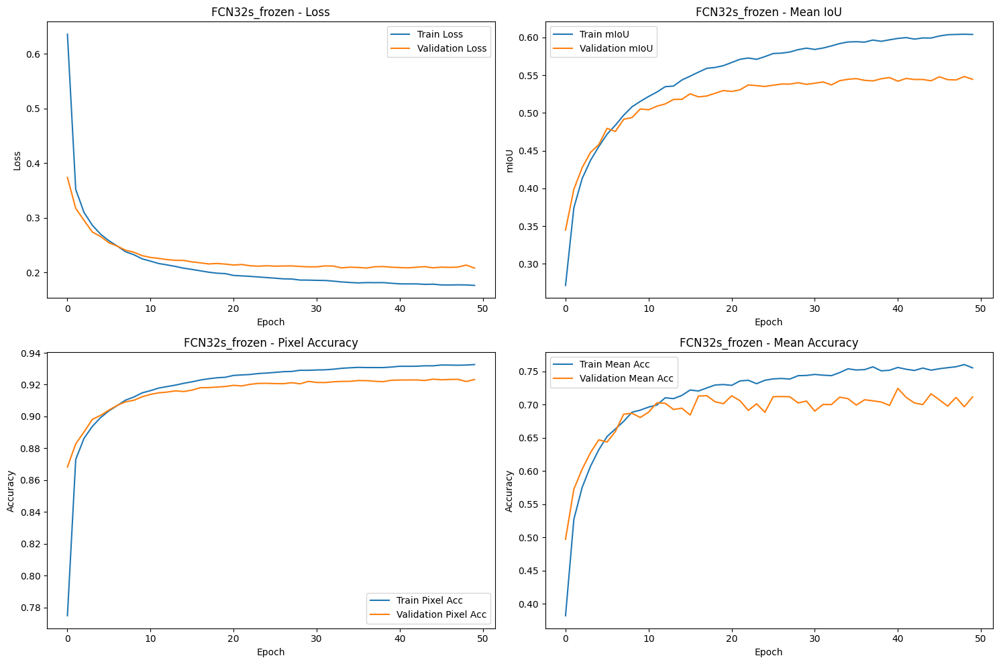

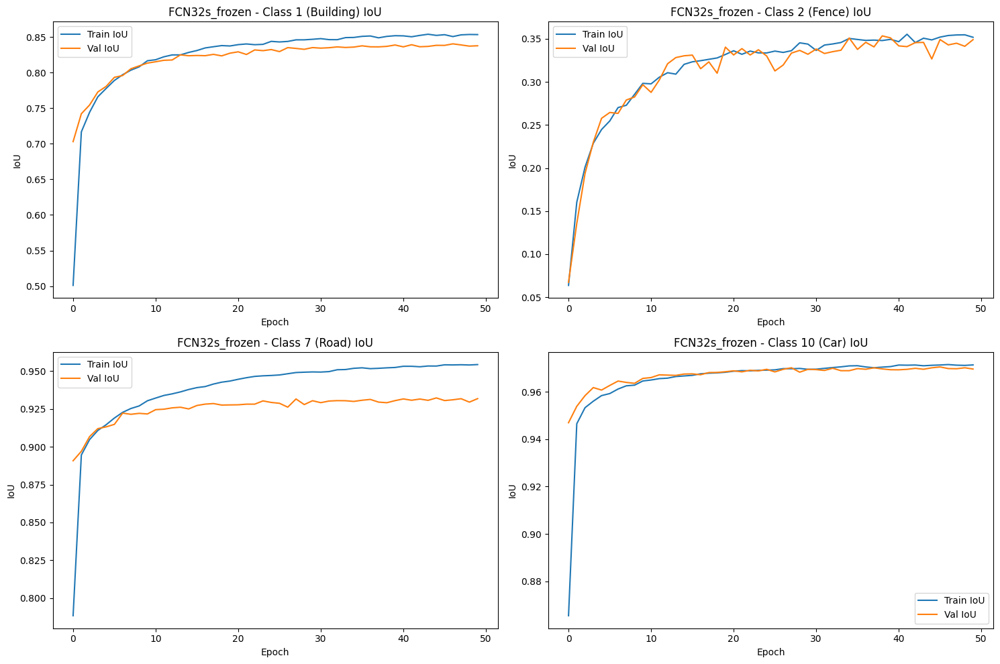

Evaluating FCN32s_frozen on test set...


Evaluating: 100%|██████████| 32/32 [00:23<00:00,  1.34it/s]


Test Results:
Loss: 0.2138
Pixel Accuracy: 0.9218
Mean Accuracy: 0.6610
Mean IoU: 0.5111
Average Inference Time: 0.0032s per batch, 0.20ms per image

Per-class IoU:
Class 1 (Building): IoU=0.7891
Class 2 (Fence): IoU=0.3067
Class 3 (Other): IoU=0.3303
Class 4 (Pedestrian): IoU=0.0230
Class 5 (Pole): IoU=0.1157
Class 6 (Roadline): IoU=0.3449
Class 7 (Road): IoU=0.9303
Class 8 (Sidewalk): IoU=0.8288
Class 9 (Vegetation): IoU=0.7258
Class 10 (Car): IoU=0.9676
Class 11 (Wall): IoU=0.4939
Class 12 (Traffic sign): IoU=0.2771


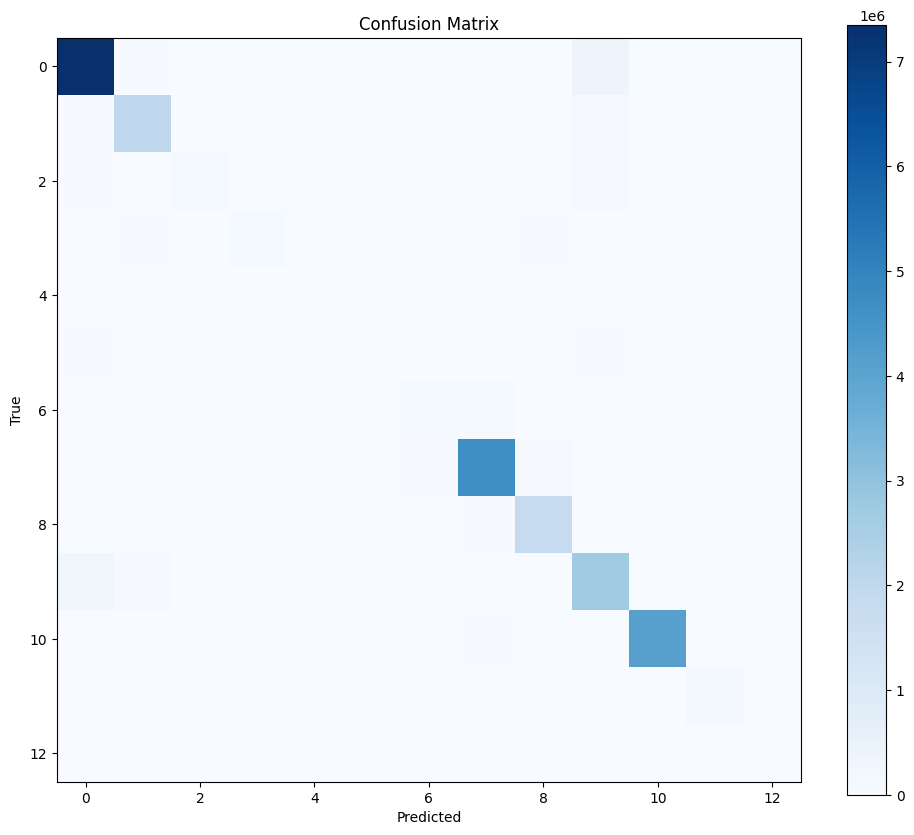

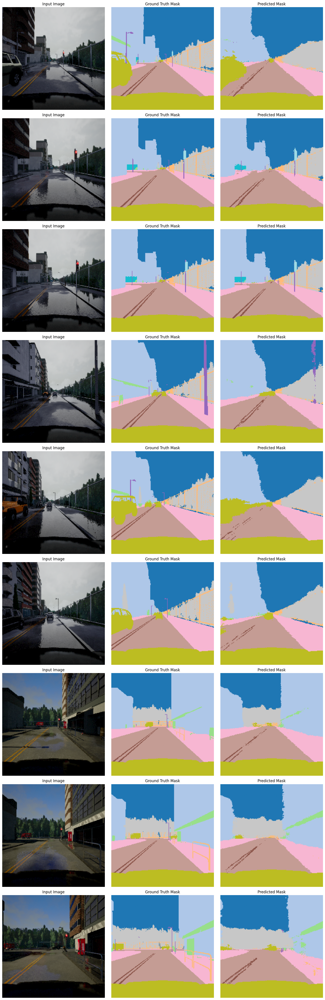


Training FCN16s_frozen with 119,781,572 trainable parameters...
Training FCN16s_frozen from scratch...


Epoch 1/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.40it/s, loss=0.342, iou=0.36, acc=0.891]


Saved best model with validation mIoU: 0.3590
Epoch 1/50 - Time: 34.12s - Train Loss: 0.6984 - Val Loss: 0.3401
Train - Pixel Acc: 0.7779, Mean Acc: 0.3829, mIoU: 0.2756
Val   - Pixel Acc: 0.8857, Mean Acc: 0.5133, mIoU: 0.3590
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.5538, Val IoU=0.7236
Class 2 (Fence): Train IoU=0.0473, Val IoU=0.1300
Class 7 (Road): Train IoU=0.7518, Val IoU=0.8944
Class 10 (Car): Train IoU=0.8386, Val IoU=0.9527


Epoch 2/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.288, iou=0.4, acc=0.904]


Saved best model with validation mIoU: 0.4115
Epoch 2/50 - Time: 32.15s - Train Loss: 0.3124 - Val Loss: 0.2871
Train - Pixel Acc: 0.8920, Mean Acc: 0.5557, mIoU: 0.3896
Val   - Pixel Acc: 0.8996, Mean Acc: 0.5882, mIoU: 0.4115
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7522, Val IoU=0.7703
Class 2 (Fence): Train IoU=0.1588, Val IoU=0.1754
Class 7 (Road): Train IoU=0.8977, Val IoU=0.9081
Class 10 (Car): Train IoU=0.9532, Val IoU=0.9597


Epoch 3/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.263, iou=0.426, acc=0.908]


Saved best model with validation mIoU: 0.4440
Epoch 3/50 - Time: 31.65s - Train Loss: 0.2728 - Val Loss: 0.2619
Train - Pixel Acc: 0.9025, Mean Acc: 0.6048, mIoU: 0.4325
Val   - Pixel Acc: 0.9049, Mean Acc: 0.6222, mIoU: 0.4440
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7831, Val IoU=0.7807
Class 2 (Fence): Train IoU=0.2040, Val IoU=0.1958
Class 7 (Road): Train IoU=0.9093, Val IoU=0.9100
Class 10 (Car): Train IoU=0.9600, Val IoU=0.9642


Epoch 4/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.242, iou=0.444, acc=0.914]


Saved best model with validation mIoU: 0.4572
Epoch 4/50 - Time: 31.83s - Train Loss: 0.2527 - Val Loss: 0.2444
Train - Pixel Acc: 0.9078, Mean Acc: 0.6260, mIoU: 0.4568
Val   - Pixel Acc: 0.9099, Mean Acc: 0.6422, mIoU: 0.4572
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7979, Val IoU=0.8050
Class 2 (Fence): Train IoU=0.2211, Val IoU=0.2097
Class 7 (Road): Train IoU=0.9151, Val IoU=0.9159
Class 10 (Car): Train IoU=0.9632, Val IoU=0.9659


Epoch 5/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.233, iou=0.45, acc=0.915]


Saved best model with validation mIoU: 0.4684
Epoch 5/50 - Time: 31.68s - Train Loss: 0.2392 - Val Loss: 0.2367
Train - Pixel Acc: 0.9114, Mean Acc: 0.6428, mIoU: 0.4728
Val   - Pixel Acc: 0.9122, Mean Acc: 0.6363, mIoU: 0.4684
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8090, Val IoU=0.8062
Class 2 (Fence): Train IoU=0.2362, Val IoU=0.2425
Class 7 (Road): Train IoU=0.9183, Val IoU=0.9199
Class 10 (Car): Train IoU=0.9653, Val IoU=0.9673


Epoch 6/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.13it/s, loss=0.222, iou=0.468, acc=0.919]


Saved best model with validation mIoU: 0.4785
Epoch 6/50 - Time: 31.91s - Train Loss: 0.2294 - Val Loss: 0.2287
Train - Pixel Acc: 0.9141, Mean Acc: 0.6540, mIoU: 0.4842
Val   - Pixel Acc: 0.9144, Mean Acc: 0.6560, mIoU: 0.4785
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8161, Val IoU=0.8153
Class 2 (Fence): Train IoU=0.2528, Val IoU=0.2052
Class 7 (Road): Train IoU=0.9212, Val IoU=0.9194
Class 10 (Car): Train IoU=0.9669, Val IoU=0.9686


Epoch 7/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  5.00it/s, loss=0.218, iou=0.487, acc=0.921]


Saved best model with validation mIoU: 0.4950
Epoch 7/50 - Time: 31.91s - Train Loss: 0.2218 - Val Loss: 0.2232
Train - Pixel Acc: 0.9164, Mean Acc: 0.6578, mIoU: 0.4938
Val   - Pixel Acc: 0.9158, Mean Acc: 0.6531, mIoU: 0.4950
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8219, Val IoU=0.8207
Class 2 (Fence): Train IoU=0.2619, Val IoU=0.2530
Class 7 (Road): Train IoU=0.9233, Val IoU=0.9210
Class 10 (Car): Train IoU=0.9679, Val IoU=0.9691


Epoch 8/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.211, iou=0.494, acc=0.923]


Saved best model with validation mIoU: 0.4951
Epoch 8/50 - Time: 31.51s - Train Loss: 0.2153 - Val Loss: 0.2189
Train - Pixel Acc: 0.9183, Mean Acc: 0.6705, mIoU: 0.5038
Val   - Pixel Acc: 0.9170, Mean Acc: 0.6553, mIoU: 0.4951
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8287, Val IoU=0.8224
Class 2 (Fence): Train IoU=0.2685, Val IoU=0.2629
Class 7 (Road): Train IoU=0.9252, Val IoU=0.9223
Class 10 (Car): Train IoU=0.9690, Val IoU=0.9697


Epoch 9/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.207, iou=0.485, acc=0.923]


Epoch 9/50 - Time: 30.26s - Train Loss: 0.2117 - Val Loss: 0.2161
Train - Pixel Acc: 0.9192, Mean Acc: 0.6739, mIoU: 0.5077
Val   - Pixel Acc: 0.9183, Mean Acc: 0.6784, mIoU: 0.4886
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8300, Val IoU=0.8259
Class 2 (Fence): Train IoU=0.2704, Val IoU=0.2427
Class 7 (Road): Train IoU=0.9258, Val IoU=0.9247
Class 10 (Car): Train IoU=0.9696, Val IoU=0.9697


Epoch 10/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.204, iou=0.495, acc=0.924]


Saved best model with validation mIoU: 0.4980
Epoch 10/50 - Time: 31.74s - Train Loss: 0.2074 - Val Loss: 0.2124
Train - Pixel Acc: 0.9207, Mean Acc: 0.6829, mIoU: 0.5159
Val   - Pixel Acc: 0.9189, Mean Acc: 0.6695, mIoU: 0.4980
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8344, Val IoU=0.8294
Class 2 (Fence): Train IoU=0.2799, Val IoU=0.2417
Class 7 (Road): Train IoU=0.9272, Val IoU=0.9251
Class 10 (Car): Train IoU=0.9701, Val IoU=0.9707


Epoch 11/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.202, iou=0.506, acc=0.925]


Saved best model with validation mIoU: 0.5058
Epoch 11/50 - Time: 31.75s - Train Loss: 0.2042 - Val Loss: 0.2132
Train - Pixel Acc: 0.9217, Mean Acc: 0.6841, mIoU: 0.5193
Val   - Pixel Acc: 0.9185, Mean Acc: 0.6581, mIoU: 0.5058
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8359, Val IoU=0.8270
Class 2 (Fence): Train IoU=0.2828, Val IoU=0.2798
Class 7 (Road): Train IoU=0.9289, Val IoU=0.9274
Class 10 (Car): Train IoU=0.9707, Val IoU=0.9705


Epoch 12/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.199, iou=0.501, acc=0.925]


Epoch 12/50 - Time: 30.08s - Train Loss: 0.2018 - Val Loss: 0.2095
Train - Pixel Acc: 0.9225, Mean Acc: 0.6880, mIoU: 0.5241
Val   - Pixel Acc: 0.9196, Mean Acc: 0.6800, mIoU: 0.5042
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8381, Val IoU=0.8281
Class 2 (Fence): Train IoU=0.2852, Val IoU=0.2754
Class 7 (Road): Train IoU=0.9301, Val IoU=0.9263
Class 10 (Car): Train IoU=0.9709, Val IoU=0.9713


Epoch 13/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.197, iou=0.514, acc=0.926]


Saved best model with validation mIoU: 0.5160
Epoch 13/50 - Time: 31.76s - Train Loss: 0.1989 - Val Loss: 0.2073
Train - Pixel Acc: 0.9234, Mean Acc: 0.6952, mIoU: 0.5280
Val   - Pixel Acc: 0.9202, Mean Acc: 0.6715, mIoU: 0.5160
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8423, Val IoU=0.8297
Class 2 (Fence): Train IoU=0.2824, Val IoU=0.2714
Class 7 (Road): Train IoU=0.9308, Val IoU=0.9256
Class 10 (Car): Train IoU=0.9712, Val IoU=0.9709


Epoch 14/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.17it/s, loss=0.196, iou=0.525, acc=0.927]


Epoch 14/50 - Time: 29.97s - Train Loss: 0.1962 - Val Loss: 0.2075
Train - Pixel Acc: 0.9243, Mean Acc: 0.6975, mIoU: 0.5346
Val   - Pixel Acc: 0.9203, Mean Acc: 0.6697, mIoU: 0.5154
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8422, Val IoU=0.8326
Class 2 (Fence): Train IoU=0.2920, Val IoU=0.2802
Class 7 (Road): Train IoU=0.9325, Val IoU=0.9260
Class 10 (Car): Train IoU=0.9717, Val IoU=0.9711


Epoch 15/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.191, iou=0.527, acc=0.928]


Saved best model with validation mIoU: 0.5236
Epoch 15/50 - Time: 31.83s - Train Loss: 0.1937 - Val Loss: 0.2048
Train - Pixel Acc: 0.9252, Mean Acc: 0.7030, mIoU: 0.5397
Val   - Pixel Acc: 0.9213, Mean Acc: 0.6786, mIoU: 0.5236
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8447, Val IoU=0.8344
Class 2 (Fence): Train IoU=0.2964, Val IoU=0.2775
Class 7 (Road): Train IoU=0.9336, Val IoU=0.9266
Class 10 (Car): Train IoU=0.9720, Val IoU=0.9713


Epoch 16/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.189, iou=0.535, acc=0.929]


Epoch 16/50 - Time: 30.06s - Train Loss: 0.1917 - Val Loss: 0.2036
Train - Pixel Acc: 0.9258, Mean Acc: 0.7073, mIoU: 0.5448
Val   - Pixel Acc: 0.9215, Mean Acc: 0.6749, mIoU: 0.5219
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8479, Val IoU=0.8331
Class 2 (Fence): Train IoU=0.2998, Val IoU=0.2847
Class 7 (Road): Train IoU=0.9349, Val IoU=0.9280
Class 10 (Car): Train IoU=0.9722, Val IoU=0.9718


Epoch 17/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.19, iou=0.527, acc=0.93]


Epoch 17/50 - Time: 30.36s - Train Loss: 0.1902 - Val Loss: 0.2025
Train - Pixel Acc: 0.9265, Mean Acc: 0.7099, mIoU: 0.5463
Val   - Pixel Acc: 0.9226, Mean Acc: 0.6776, mIoU: 0.5208
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8485, Val IoU=0.8353
Class 2 (Fence): Train IoU=0.2977, Val IoU=0.2452
Class 7 (Road): Train IoU=0.9365, Val IoU=0.9299
Class 10 (Car): Train IoU=0.9723, Val IoU=0.9716


Epoch 18/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.15it/s, loss=0.191, iou=0.532, acc=0.929]


Saved best model with validation mIoU: 0.5239
Epoch 18/50 - Time: 31.44s - Train Loss: 0.1886 - Val Loss: 0.2013
Train - Pixel Acc: 0.9271, Mean Acc: 0.7129, mIoU: 0.5521
Val   - Pixel Acc: 0.9227, Mean Acc: 0.6857, mIoU: 0.5239
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8475, Val IoU=0.8336
Class 2 (Fence): Train IoU=0.3002, Val IoU=0.2956
Class 7 (Road): Train IoU=0.9374, Val IoU=0.9312
Class 10 (Car): Train IoU=0.9727, Val IoU=0.9718


Epoch 19/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.192, iou=0.535, acc=0.929]


Saved best model with validation mIoU: 0.5305
Epoch 19/50 - Time: 31.88s - Train Loss: 0.1875 - Val Loss: 0.2020
Train - Pixel Acc: 0.9275, Mean Acc: 0.7156, mIoU: 0.5524
Val   - Pixel Acc: 0.9223, Mean Acc: 0.6794, mIoU: 0.5305
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8492, Val IoU=0.8363
Class 2 (Fence): Train IoU=0.2978, Val IoU=0.2816
Class 7 (Road): Train IoU=0.9383, Val IoU=0.9293
Class 10 (Car): Train IoU=0.9729, Val IoU=0.9718


Epoch 20/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.17it/s, loss=0.19, iou=0.532, acc=0.93]


Epoch 20/50 - Time: 29.86s - Train Loss: 0.1857 - Val Loss: 0.1992
Train - Pixel Acc: 0.9282, Mean Acc: 0.7162, mIoU: 0.5575
Val   - Pixel Acc: 0.9234, Mean Acc: 0.6824, mIoU: 0.5299
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8503, Val IoU=0.8359
Class 2 (Fence): Train IoU=0.3050, Val IoU=0.2874
Class 7 (Road): Train IoU=0.9399, Val IoU=0.9315
Class 10 (Car): Train IoU=0.9730, Val IoU=0.9715


Epoch 21/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.186, iou=0.533, acc=0.93]


Epoch 21/50 - Time: 30.41s - Train Loss: 0.1847 - Val Loss: 0.1994
Train - Pixel Acc: 0.9286, Mean Acc: 0.7205, mIoU: 0.5601
Val   - Pixel Acc: 0.9236, Mean Acc: 0.6895, mIoU: 0.5297
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8523, Val IoU=0.8358
Class 2 (Fence): Train IoU=0.3048, Val IoU=0.2750
Class 7 (Road): Train IoU=0.9408, Val IoU=0.9327
Class 10 (Car): Train IoU=0.9731, Val IoU=0.9724


Epoch 22/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.17it/s, loss=0.187, iou=0.534, acc=0.93]


Saved best model with validation mIoU: 0.5312
Epoch 22/50 - Time: 31.26s - Train Loss: 0.1830 - Val Loss: 0.1992
Train - Pixel Acc: 0.9292, Mean Acc: 0.7236, mIoU: 0.5631
Val   - Pixel Acc: 0.9237, Mean Acc: 0.6860, mIoU: 0.5312
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8525, Val IoU=0.8387
Class 2 (Fence): Train IoU=0.3074, Val IoU=0.2791
Class 7 (Road): Train IoU=0.9417, Val IoU=0.9314
Class 10 (Car): Train IoU=0.9733, Val IoU=0.9725


Epoch 23/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.185, iou=0.539, acc=0.93]


Saved best model with validation mIoU: 0.5345
Epoch 23/50 - Time: 31.77s - Train Loss: 0.1822 - Val Loss: 0.1984
Train - Pixel Acc: 0.9295, Mean Acc: 0.7243, mIoU: 0.5646
Val   - Pixel Acc: 0.9239, Mean Acc: 0.6852, mIoU: 0.5345
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8517, Val IoU=0.8358
Class 2 (Fence): Train IoU=0.3068, Val IoU=0.2691
Class 7 (Road): Train IoU=0.9430, Val IoU=0.9328
Class 10 (Car): Train IoU=0.9734, Val IoU=0.9711


Epoch 24/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.187, iou=0.541, acc=0.93]


Saved best model with validation mIoU: 0.5389
Epoch 24/50 - Time: 31.31s - Train Loss: 0.1810 - Val Loss: 0.1973
Train - Pixel Acc: 0.9300, Mean Acc: 0.7244, mIoU: 0.5683
Val   - Pixel Acc: 0.9242, Mean Acc: 0.6916, mIoU: 0.5389
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8548, Val IoU=0.8395
Class 2 (Fence): Train IoU=0.3090, Val IoU=0.2906
Class 7 (Road): Train IoU=0.9437, Val IoU=0.9319
Class 10 (Car): Train IoU=0.9736, Val IoU=0.9719


Epoch 25/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.187, iou=0.54, acc=0.93]


Epoch 25/50 - Time: 30.23s - Train Loss: 0.1807 - Val Loss: 0.1987
Train - Pixel Acc: 0.9302, Mean Acc: 0.7261, mIoU: 0.5698
Val   - Pixel Acc: 0.9235, Mean Acc: 0.6906, mIoU: 0.5352
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8529, Val IoU=0.8376
Class 2 (Fence): Train IoU=0.3104, Val IoU=0.3116
Class 7 (Road): Train IoU=0.9445, Val IoU=0.9308
Class 10 (Car): Train IoU=0.9736, Val IoU=0.9727


Epoch 26/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.56it/s, loss=0.185, iou=0.541, acc=0.931]


Epoch 26/50 - Time: 31.42s - Train Loss: 0.1787 - Val Loss: 0.1969
Train - Pixel Acc: 0.9309, Mean Acc: 0.7338, mIoU: 0.5739
Val   - Pixel Acc: 0.9244, Mean Acc: 0.6933, mIoU: 0.5368
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8563, Val IoU=0.8387
Class 2 (Fence): Train IoU=0.3118, Val IoU=0.2891
Class 7 (Road): Train IoU=0.9458, Val IoU=0.9324
Class 10 (Car): Train IoU=0.9738, Val IoU=0.9726


Epoch 27/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.184, iou=0.542, acc=0.931]


Epoch 27/50 - Time: 30.99s - Train Loss: 0.1780 - Val Loss: 0.1977
Train - Pixel Acc: 0.9311, Mean Acc: 0.7268, mIoU: 0.5732
Val   - Pixel Acc: 0.9243, Mean Acc: 0.6922, mIoU: 0.5378
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8561, Val IoU=0.8401
Class 2 (Fence): Train IoU=0.3124, Val IoU=0.2811
Class 7 (Road): Train IoU=0.9462, Val IoU=0.9321
Class 10 (Car): Train IoU=0.9738, Val IoU=0.9711


Epoch 28/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.186, iou=0.54, acc=0.93]


Epoch 28/50 - Time: 30.55s - Train Loss: 0.1775 - Val Loss: 0.1968
Train - Pixel Acc: 0.9314, Mean Acc: 0.7309, mIoU: 0.5762
Val   - Pixel Acc: 0.9247, Mean Acc: 0.6916, mIoU: 0.5383
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8565, Val IoU=0.8387
Class 2 (Fence): Train IoU=0.3103, Val IoU=0.2832
Class 7 (Road): Train IoU=0.9466, Val IoU=0.9338
Class 10 (Car): Train IoU=0.9740, Val IoU=0.9723


Epoch 29/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.76it/s, loss=0.187, iou=0.545, acc=0.93]


Saved best model with validation mIoU: 0.5393
Epoch 29/50 - Time: 32.16s - Train Loss: 0.1760 - Val Loss: 0.1966
Train - Pixel Acc: 0.9319, Mean Acc: 0.7323, mIoU: 0.5814
Val   - Pixel Acc: 0.9245, Mean Acc: 0.6869, mIoU: 0.5393
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8577, Val IoU=0.8379
Class 2 (Fence): Train IoU=0.3158, Val IoU=0.2938
Class 7 (Road): Train IoU=0.9478, Val IoU=0.9327
Class 10 (Car): Train IoU=0.9739, Val IoU=0.9729


Epoch 30/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.67it/s, loss=0.189, iou=0.539, acc=0.93]


Epoch 30/50 - Time: 31.37s - Train Loss: 0.1756 - Val Loss: 0.1968
Train - Pixel Acc: 0.9320, Mean Acc: 0.7387, mIoU: 0.5822
Val   - Pixel Acc: 0.9247, Mean Acc: 0.6936, mIoU: 0.5390
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8561, Val IoU=0.8371
Class 2 (Fence): Train IoU=0.3180, Val IoU=0.2872
Class 7 (Road): Train IoU=0.9480, Val IoU=0.9336
Class 10 (Car): Train IoU=0.9742, Val IoU=0.9727


Epoch 31/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.183, iou=0.547, acc=0.932]


Saved best model with validation mIoU: 0.5444
Epoch 31/50 - Time: 32.57s - Train Loss: 0.1745 - Val Loss: 0.1967
Train - Pixel Acc: 0.9325, Mean Acc: 0.7350, mIoU: 0.5833
Val   - Pixel Acc: 0.9245, Mean Acc: 0.6755, mIoU: 0.5444
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8586, Val IoU=0.8391
Class 2 (Fence): Train IoU=0.3159, Val IoU=0.2957
Class 7 (Road): Train IoU=0.9490, Val IoU=0.9328
Class 10 (Car): Train IoU=0.9741, Val IoU=0.9722


Epoch 32/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.85it/s, loss=0.184, iou=0.536, acc=0.931]


Epoch 32/50 - Time: 30.89s - Train Loss: 0.1742 - Val Loss: 0.1961
Train - Pixel Acc: 0.9326, Mean Acc: 0.7371, mIoU: 0.5857
Val   - Pixel Acc: 0.9251, Mean Acc: 0.6987, mIoU: 0.5362
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8599, Val IoU=0.8397
Class 2 (Fence): Train IoU=0.3110, Val IoU=0.2778
Class 7 (Road): Train IoU=0.9494, Val IoU=0.9351
Class 10 (Car): Train IoU=0.9744, Val IoU=0.9727


Epoch 33/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.00it/s, loss=0.182, iou=0.546, acc=0.931]


Epoch 33/50 - Time: 30.65s - Train Loss: 0.1739 - Val Loss: 0.1962
Train - Pixel Acc: 0.9328, Mean Acc: 0.7375, mIoU: 0.5849
Val   - Pixel Acc: 0.9248, Mean Acc: 0.6885, mIoU: 0.5437
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8597, Val IoU=0.8375
Class 2 (Fence): Train IoU=0.3118, Val IoU=0.2994
Class 7 (Road): Train IoU=0.9500, Val IoU=0.9341
Class 10 (Car): Train IoU=0.9742, Val IoU=0.9731


Epoch 34/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.183, iou=0.54, acc=0.931]


Epoch 34/50 - Time: 30.65s - Train Loss: 0.1728 - Val Loss: 0.1957
Train - Pixel Acc: 0.9331, Mean Acc: 0.7388, mIoU: 0.5854
Val   - Pixel Acc: 0.9250, Mean Acc: 0.6962, mIoU: 0.5396
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8607, Val IoU=0.8401
Class 2 (Fence): Train IoU=0.3167, Val IoU=0.2714
Class 7 (Road): Train IoU=0.9498, Val IoU=0.9321
Class 10 (Car): Train IoU=0.9745, Val IoU=0.9726


Epoch 35/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.183, iou=0.55, acc=0.931]


Saved best model with validation mIoU: 0.5444
Epoch 35/50 - Time: 31.80s - Train Loss: 0.1720 - Val Loss: 0.1950
Train - Pixel Acc: 0.9334, Mean Acc: 0.7414, mIoU: 0.5881
Val   - Pixel Acc: 0.9254, Mean Acc: 0.6982, mIoU: 0.5444
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8606, Val IoU=0.8398
Class 2 (Fence): Train IoU=0.3197, Val IoU=0.2936
Class 7 (Road): Train IoU=0.9508, Val IoU=0.9343
Class 10 (Car): Train IoU=0.9746, Val IoU=0.9726


Epoch 36/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.189, iou=0.545, acc=0.93]


Saved best model with validation mIoU: 0.5457
Epoch 36/50 - Time: 31.82s - Train Loss: 0.1717 - Val Loss: 0.1974
Train - Pixel Acc: 0.9335, Mean Acc: 0.7374, mIoU: 0.5895
Val   - Pixel Acc: 0.9246, Mean Acc: 0.6773, mIoU: 0.5457
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8590, Val IoU=0.8391
Class 2 (Fence): Train IoU=0.3168, Val IoU=0.2925
Class 7 (Road): Train IoU=0.9514, Val IoU=0.9327
Class 10 (Car): Train IoU=0.9745, Val IoU=0.9727


Epoch 37/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.186, iou=0.541, acc=0.931]


Saved best model with validation mIoU: 0.5461
Epoch 37/50 - Time: 31.67s - Train Loss: 0.1710 - Val Loss: 0.1949
Train - Pixel Acc: 0.9338, Mean Acc: 0.7414, mIoU: 0.5918
Val   - Pixel Acc: 0.9255, Mean Acc: 0.6907, mIoU: 0.5461
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8606, Val IoU=0.8415
Class 2 (Fence): Train IoU=0.3206, Val IoU=0.2986
Class 7 (Road): Train IoU=0.9519, Val IoU=0.9335
Class 10 (Car): Train IoU=0.9747, Val IoU=0.9729


Epoch 38/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.183, iou=0.543, acc=0.931]


Epoch 38/50 - Time: 30.58s - Train Loss: 0.1712 - Val Loss: 0.1950
Train - Pixel Acc: 0.9337, Mean Acc: 0.7414, mIoU: 0.5903
Val   - Pixel Acc: 0.9253, Mean Acc: 0.6922, mIoU: 0.5417
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8594, Val IoU=0.8400
Class 2 (Fence): Train IoU=0.3177, Val IoU=0.2902
Class 7 (Road): Train IoU=0.9519, Val IoU=0.9356
Class 10 (Car): Train IoU=0.9746, Val IoU=0.9726


Epoch 39/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.186, iou=0.541, acc=0.931]


Epoch 39/50 - Time: 30.38s - Train Loss: 0.1706 - Val Loss: 0.1964
Train - Pixel Acc: 0.9340, Mean Acc: 0.7443, mIoU: 0.5916
Val   - Pixel Acc: 0.9252, Mean Acc: 0.6972, mIoU: 0.5407
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8620, Val IoU=0.8400
Class 2 (Fence): Train IoU=0.3154, Val IoU=0.2909
Class 7 (Road): Train IoU=0.9522, Val IoU=0.9347
Class 10 (Car): Train IoU=0.9748, Val IoU=0.9728


Epoch 40/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.187, iou=0.537, acc=0.931]


Epoch 40/50 - Time: 30.76s - Train Loss: 0.1698 - Val Loss: 0.1953
Train - Pixel Acc: 0.9343, Mean Acc: 0.7417, mIoU: 0.5930
Val   - Pixel Acc: 0.9255, Mean Acc: 0.6971, mIoU: 0.5425
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8622, Val IoU=0.8381
Class 2 (Fence): Train IoU=0.3165, Val IoU=0.2934
Class 7 (Road): Train IoU=0.9527, Val IoU=0.9359
Class 10 (Car): Train IoU=0.9750, Val IoU=0.9731


Epoch 41/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.186, iou=0.544, acc=0.931]


Saved best model with validation mIoU: 0.5475
Epoch 41/50 - Time: 31.74s - Train Loss: 0.1694 - Val Loss: 0.1963
Train - Pixel Acc: 0.9345, Mean Acc: 0.7448, mIoU: 0.5947
Val   - Pixel Acc: 0.9253, Mean Acc: 0.6864, mIoU: 0.5475
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8611, Val IoU=0.8387
Class 2 (Fence): Train IoU=0.3242, Val IoU=0.3011
Class 7 (Road): Train IoU=0.9529, Val IoU=0.9338
Class 10 (Car): Train IoU=0.9749, Val IoU=0.9730


Epoch 42/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.186, iou=0.547, acc=0.931]


Epoch 42/50 - Time: 30.71s - Train Loss: 0.1691 - Val Loss: 0.1967
Train - Pixel Acc: 0.9346, Mean Acc: 0.7459, mIoU: 0.5949
Val   - Pixel Acc: 0.9250, Mean Acc: 0.6946, mIoU: 0.5472
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8620, Val IoU=0.8384
Class 2 (Fence): Train IoU=0.3214, Val IoU=0.3025
Class 7 (Road): Train IoU=0.9532, Val IoU=0.9327
Class 10 (Car): Train IoU=0.9749, Val IoU=0.9724


Epoch 43/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.185, iou=0.544, acc=0.931]


Epoch 43/50 - Time: 30.29s - Train Loss: 0.1685 - Val Loss: 0.1969
Train - Pixel Acc: 0.9348, Mean Acc: 0.7438, mIoU: 0.5965
Val   - Pixel Acc: 0.9250, Mean Acc: 0.6966, mIoU: 0.5412
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8626, Val IoU=0.8375
Class 2 (Fence): Train IoU=0.3205, Val IoU=0.2964
Class 7 (Road): Train IoU=0.9536, Val IoU=0.9337
Class 10 (Car): Train IoU=0.9750, Val IoU=0.9729


Epoch 44/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.188, iou=0.542, acc=0.931]


Epoch 44/50 - Time: 30.64s - Train Loss: 0.1677 - Val Loss: 0.1957
Train - Pixel Acc: 0.9350, Mean Acc: 0.7491, mIoU: 0.5987
Val   - Pixel Acc: 0.9255, Mean Acc: 0.6953, mIoU: 0.5460
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8641, Val IoU=0.8386
Class 2 (Fence): Train IoU=0.3269, Val IoU=0.2863
Class 7 (Road): Train IoU=0.9539, Val IoU=0.9350
Class 10 (Car): Train IoU=0.9751, Val IoU=0.9732


Epoch 45/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.93it/s, loss=0.184, iou=0.544, acc=0.932]


Epoch 45/50 - Time: 30.32s - Train Loss: 0.1673 - Val Loss: 0.1953
Train - Pixel Acc: 0.9352, Mean Acc: 0.7480, mIoU: 0.5997
Val   - Pixel Acc: 0.9258, Mean Acc: 0.7013, mIoU: 0.5447
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8633, Val IoU=0.8399
Class 2 (Fence): Train IoU=0.3214, Val IoU=0.3046
Class 7 (Road): Train IoU=0.9542, Val IoU=0.9359
Class 10 (Car): Train IoU=0.9752, Val IoU=0.9730


Epoch 46/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.184, iou=0.55, acc=0.932]


Saved best model with validation mIoU: 0.5487
Epoch 46/50 - Time: 31.96s - Train Loss: 0.1670 - Val Loss: 0.1954
Train - Pixel Acc: 0.9353, Mean Acc: 0.7488, mIoU: 0.6004
Val   - Pixel Acc: 0.9254, Mean Acc: 0.6878, mIoU: 0.5487
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8640, Val IoU=0.8413
Class 2 (Fence): Train IoU=0.3152, Val IoU=0.2888
Class 7 (Road): Train IoU=0.9547, Val IoU=0.9340
Class 10 (Car): Train IoU=0.9751, Val IoU=0.9720


Epoch 47/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.184, iou=0.546, acc=0.931]


Epoch 47/50 - Time: 30.36s - Train Loss: 0.1666 - Val Loss: 0.1959
Train - Pixel Acc: 0.9355, Mean Acc: 0.7487, mIoU: 0.6009
Val   - Pixel Acc: 0.9251, Mean Acc: 0.6982, mIoU: 0.5441
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8638, Val IoU=0.8364
Class 2 (Fence): Train IoU=0.3229, Val IoU=0.2916
Class 7 (Road): Train IoU=0.9548, Val IoU=0.9350
Class 10 (Car): Train IoU=0.9753, Val IoU=0.9728


Epoch 48/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.72it/s, loss=0.185, iou=0.539, acc=0.931]


Epoch 48/50 - Time: 31.41s - Train Loss: 0.1661 - Val Loss: 0.1947
Train - Pixel Acc: 0.9356, Mean Acc: 0.7504, mIoU: 0.6017
Val   - Pixel Acc: 0.9258, Mean Acc: 0.7047, mIoU: 0.5449
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8646, Val IoU=0.8404
Class 2 (Fence): Train IoU=0.3201, Val IoU=0.2909
Class 7 (Road): Train IoU=0.9554, Val IoU=0.9361
Class 10 (Car): Train IoU=0.9751, Val IoU=0.9727


Epoch 49/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.185, iou=0.539, acc=0.931]


Epoch 49/50 - Time: 30.07s - Train Loss: 0.1664 - Val Loss: 0.1955
Train - Pixel Acc: 0.9355, Mean Acc: 0.7511, mIoU: 0.6021
Val   - Pixel Acc: 0.9258, Mean Acc: 0.7005, mIoU: 0.5439
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8647, Val IoU=0.8412
Class 2 (Fence): Train IoU=0.3258, Val IoU=0.2949
Class 7 (Road): Train IoU=0.9551, Val IoU=0.9355
Class 10 (Car): Train IoU=0.9751, Val IoU=0.9727


Epoch 50/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.186, iou=0.541, acc=0.931]


Epoch 50/50 - Time: 30.20s - Train Loss: 0.1658 - Val Loss: 0.1951
Train - Pixel Acc: 0.9357, Mean Acc: 0.7477, mIoU: 0.6000
Val   - Pixel Acc: 0.9260, Mean Acc: 0.7006, mIoU: 0.5465
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8650, Val IoU=0.8408
Class 2 (Fence): Train IoU=0.3224, Val IoU=0.3057
Class 7 (Road): Train IoU=0.9553, Val IoU=0.9354
Class 10 (Car): Train IoU=0.9752, Val IoU=0.9730
Training complete. Average time per epoch: 31.17s. Total training time: 1558.69s


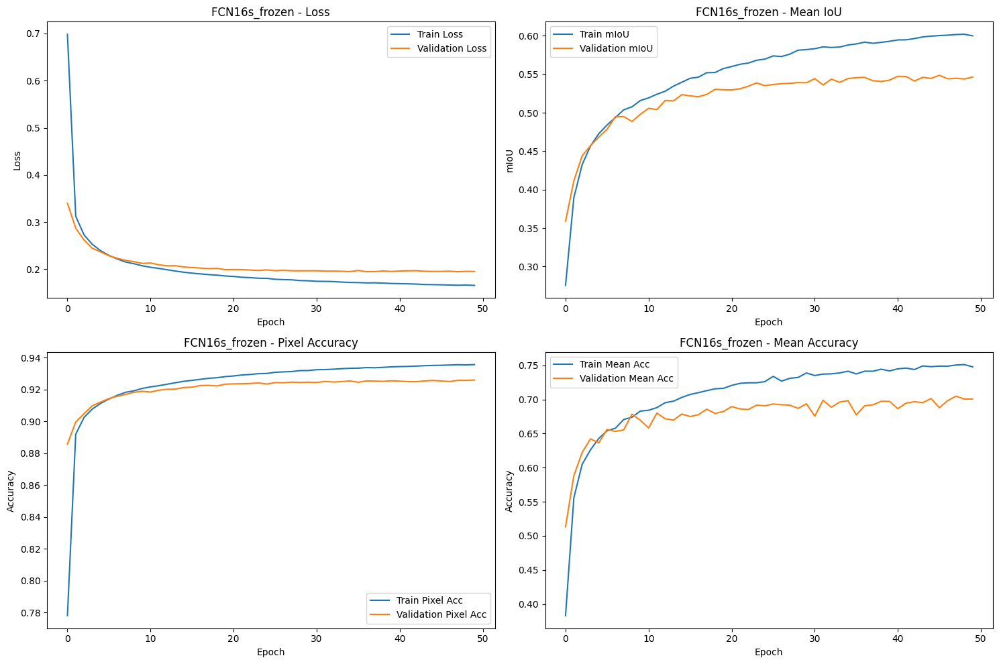

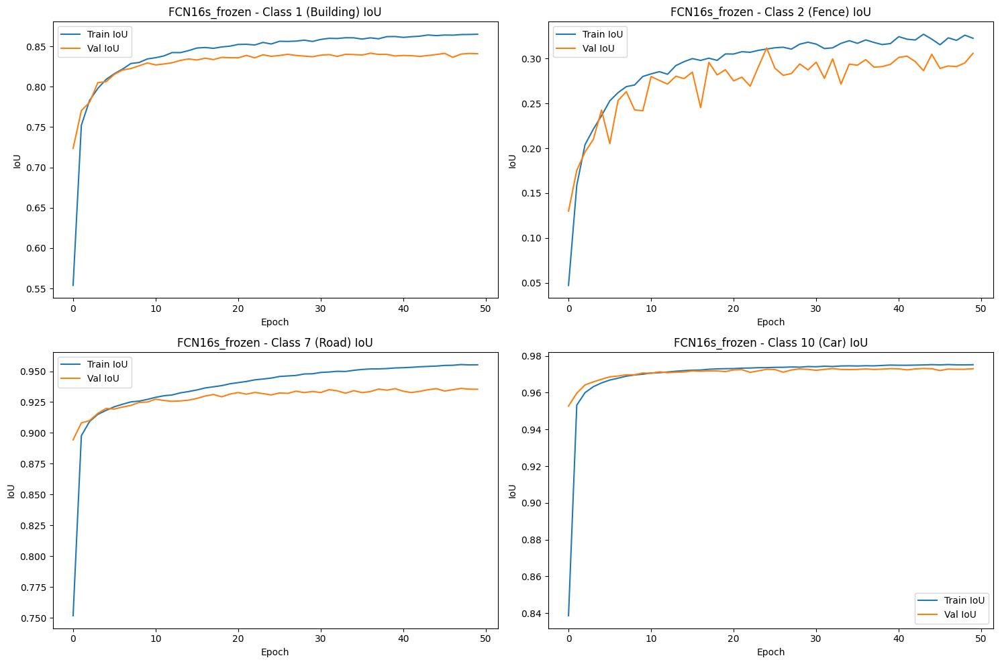

Evaluating FCN16s_frozen on test set...


Evaluating: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s]


Test Results:
Loss: 0.1969
Pixel Accuracy: 0.9259
Mean Accuracy: 0.6580
Mean IoU: 0.5173
Average Inference Time: 0.0022s per batch, 0.13ms per image

Per-class IoU:
Class 1 (Building): IoU=0.7906
Class 2 (Fence): IoU=0.2724
Class 3 (Other): IoU=0.3661
Class 4 (Pedestrian): IoU=0.0153
Class 5 (Pole): IoU=0.1908
Class 6 (Roadline): IoU=0.3014
Class 7 (Road): IoU=0.9351
Class 8 (Sidewalk): IoU=0.8392
Class 9 (Vegetation): IoU=0.7377
Class 10 (Car): IoU=0.9726
Class 11 (Wall): IoU=0.4579
Class 12 (Traffic sign): IoU=0.3286


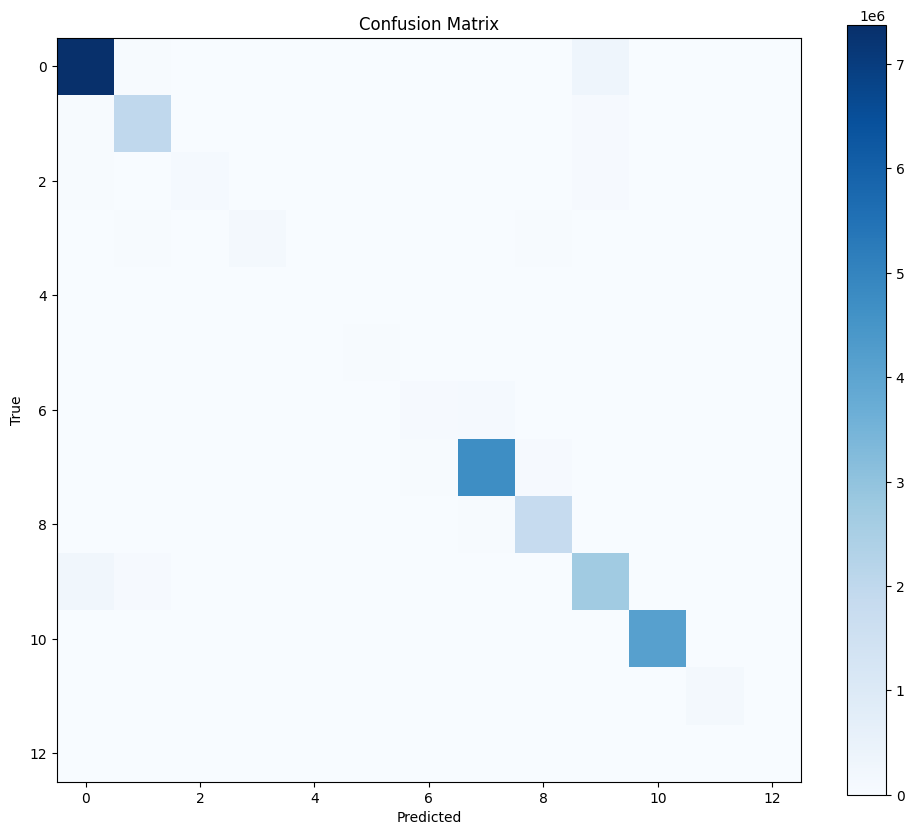

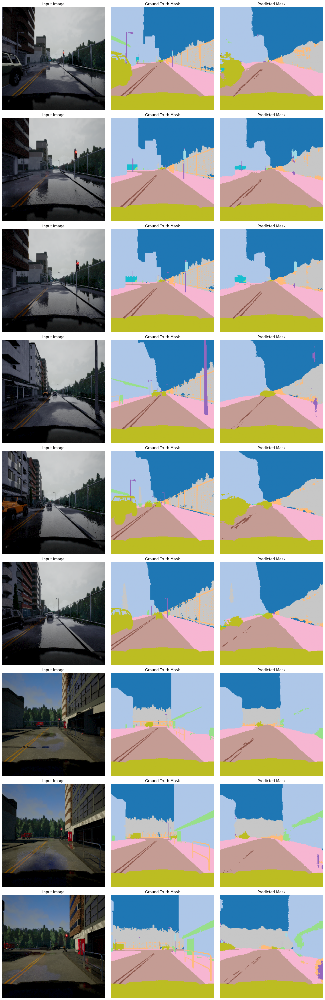


Training FCN8s_frozen with 119,655,121 trainable parameters...
Training FCN8s_frozen from scratch...


Epoch 1/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.36it/s, loss=0.325, iou=0.38, acc=0.894]


Saved best model with validation mIoU: 0.3873
Epoch 1/50 - Time: 33.73s - Train Loss: 0.7086 - Val Loss: 0.3189
Train - Pixel Acc: 0.7655, Mean Acc: 0.3807, mIoU: 0.2697
Val   - Pixel Acc: 0.8941, Mean Acc: 0.5346, mIoU: 0.3873
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.4853, Val IoU=0.7372
Class 2 (Fence): Train IoU=0.0296, Val IoU=0.1143
Class 7 (Road): Train IoU=0.7190, Val IoU=0.8888
Class 10 (Car): Train IoU=0.7789, Val IoU=0.9541


Epoch 2/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.258, iou=0.416, acc=0.91]


Saved best model with validation mIoU: 0.4339
Epoch 2/50 - Time: 31.02s - Train Loss: 0.2806 - Val Loss: 0.2534
Train - Pixel Acc: 0.9042, Mean Acc: 0.5765, mIoU: 0.4139
Val   - Pixel Acc: 0.9112, Mean Acc: 0.5976, mIoU: 0.4339
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7657, Val IoU=0.7790
Class 2 (Fence): Train IoU=0.1697, Val IoU=0.1897
Class 7 (Road): Train IoU=0.9075, Val IoU=0.9164
Class 10 (Car): Train IoU=0.9553, Val IoU=0.9631


Epoch 3/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.229, iou=0.459, acc=0.918]


Saved best model with validation mIoU: 0.4754
Epoch 3/50 - Time: 31.35s - Train Loss: 0.2399 - Val Loss: 0.2282
Train - Pixel Acc: 0.9150, Mean Acc: 0.6268, mIoU: 0.4579
Val   - Pixel Acc: 0.9178, Mean Acc: 0.6373, mIoU: 0.4754
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7998, Val IoU=0.8045
Class 2 (Fence): Train IoU=0.2208, Val IoU=0.1854
Class 7 (Road): Train IoU=0.9195, Val IoU=0.9198
Class 10 (Car): Train IoU=0.9642, Val IoU=0.9650


Epoch 4/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.211, iou=0.474, acc=0.922]


Saved best model with validation mIoU: 0.4898
Epoch 4/50 - Time: 31.20s - Train Loss: 0.2182 - Val Loss: 0.2134
Train - Pixel Acc: 0.9210, Mean Acc: 0.6537, mIoU: 0.4863
Val   - Pixel Acc: 0.9219, Mean Acc: 0.6506, mIoU: 0.4898
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8178, Val IoU=0.8166
Class 2 (Fence): Train IoU=0.2445, Val IoU=0.2393
Class 7 (Road): Train IoU=0.9256, Val IoU=0.9254
Class 10 (Car): Train IoU=0.9680, Val IoU=0.9691


Epoch 5/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.17it/s, loss=0.194, iou=0.493, acc=0.928]


Saved best model with validation mIoU: 0.5061
Epoch 5/50 - Time: 31.17s - Train Loss: 0.2047 - Val Loss: 0.2009
Train - Pixel Acc: 0.9250, Mean Acc: 0.6732, mIoU: 0.5060
Val   - Pixel Acc: 0.9257, Mean Acc: 0.6703, mIoU: 0.5061
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8344, Val IoU=0.8332
Class 2 (Fence): Train IoU=0.2663, Val IoU=0.2559
Class 7 (Road): Train IoU=0.9288, Val IoU=0.9285
Class 10 (Car): Train IoU=0.9699, Val IoU=0.9705


Epoch 6/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.187, iou=0.501, acc=0.931]


Saved best model with validation mIoU: 0.5082
Epoch 6/50 - Time: 31.13s - Train Loss: 0.1956 - Val Loss: 0.1949
Train - Pixel Acc: 0.9276, Mean Acc: 0.6870, mIoU: 0.5207
Val   - Pixel Acc: 0.9279, Mean Acc: 0.6787, mIoU: 0.5082
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8426, Val IoU=0.8406
Class 2 (Fence): Train IoU=0.2759, Val IoU=0.2507
Class 7 (Road): Train IoU=0.9315, Val IoU=0.9323
Class 10 (Car): Train IoU=0.9712, Val IoU=0.9725


Epoch 7/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.12it/s, loss=0.183, iou=0.516, acc=0.933]


Saved best model with validation mIoU: 0.5205
Epoch 7/50 - Time: 31.19s - Train Loss: 0.1890 - Val Loss: 0.1895
Train - Pixel Acc: 0.9296, Mean Acc: 0.6905, mIoU: 0.5288
Val   - Pixel Acc: 0.9295, Mean Acc: 0.6945, mIoU: 0.5205
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8472, Val IoU=0.8439
Class 2 (Fence): Train IoU=0.2835, Val IoU=0.2782
Class 7 (Road): Train IoU=0.9339, Val IoU=0.9338
Class 10 (Car): Train IoU=0.9722, Val IoU=0.9722


Epoch 8/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.176, iou=0.525, acc=0.935]


Saved best model with validation mIoU: 0.5319
Epoch 8/50 - Time: 31.13s - Train Loss: 0.1830 - Val Loss: 0.1840
Train - Pixel Acc: 0.9315, Mean Acc: 0.7035, mIoU: 0.5413
Val   - Pixel Acc: 0.9310, Mean Acc: 0.6930, mIoU: 0.5319
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8533, Val IoU=0.8493
Class 2 (Fence): Train IoU=0.2949, Val IoU=0.2962
Class 7 (Road): Train IoU=0.9360, Val IoU=0.9353
Class 10 (Car): Train IoU=0.9733, Val IoU=0.9734


Epoch 9/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.173, iou=0.548, acc=0.936]


Saved best model with validation mIoU: 0.5483
Epoch 9/50 - Time: 31.17s - Train Loss: 0.1781 - Val Loss: 0.1821
Train - Pixel Acc: 0.9329, Mean Acc: 0.7087, mIoU: 0.5461
Val   - Pixel Acc: 0.9315, Mean Acc: 0.6893, mIoU: 0.5483
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8567, Val IoU=0.8512
Class 2 (Fence): Train IoU=0.3059, Val IoU=0.2921
Class 7 (Road): Train IoU=0.9376, Val IoU=0.9350
Class 10 (Car): Train IoU=0.9739, Val IoU=0.9735


Epoch 10/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  5.00it/s, loss=0.171, iou=0.539, acc=0.937]


Epoch 10/50 - Time: 29.78s - Train Loss: 0.1743 - Val Loss: 0.1786
Train - Pixel Acc: 0.9341, Mean Acc: 0.7117, mIoU: 0.5546
Val   - Pixel Acc: 0.9327, Mean Acc: 0.6936, mIoU: 0.5460
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8605, Val IoU=0.8529
Class 2 (Fence): Train IoU=0.3061, Val IoU=0.3117
Class 7 (Road): Train IoU=0.9396, Val IoU=0.9379
Class 10 (Car): Train IoU=0.9748, Val IoU=0.9736


Epoch 11/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.167, iou=0.541, acc=0.937]


Epoch 11/50 - Time: 29.73s - Train Loss: 0.1710 - Val Loss: 0.1763
Train - Pixel Acc: 0.9351, Mean Acc: 0.7203, mIoU: 0.5616
Val   - Pixel Acc: 0.9336, Mean Acc: 0.6987, mIoU: 0.5460
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8638, Val IoU=0.8548
Class 2 (Fence): Train IoU=0.3137, Val IoU=0.2858
Class 7 (Road): Train IoU=0.9412, Val IoU=0.9397
Class 10 (Car): Train IoU=0.9752, Val IoU=0.9737


Epoch 12/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.166, iou=0.551, acc=0.938]


Saved best model with validation mIoU: 0.5568
Epoch 12/50 - Time: 31.14s - Train Loss: 0.1690 - Val Loss: 0.1749
Train - Pixel Acc: 0.9358, Mean Acc: 0.7222, mIoU: 0.5648
Val   - Pixel Acc: 0.9343, Mean Acc: 0.6966, mIoU: 0.5568
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8644, Val IoU=0.8567
Class 2 (Fence): Train IoU=0.3193, Val IoU=0.3161
Class 7 (Road): Train IoU=0.9415, Val IoU=0.9404
Class 10 (Car): Train IoU=0.9754, Val IoU=0.9746


Epoch 13/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.159, iou=0.57, acc=0.94]


Saved best model with validation mIoU: 0.5637
Epoch 13/50 - Time: 31.28s - Train Loss: 0.1661 - Val Loss: 0.1730
Train - Pixel Acc: 0.9368, Mean Acc: 0.7258, mIoU: 0.5700
Val   - Pixel Acc: 0.9344, Mean Acc: 0.7053, mIoU: 0.5637
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8669, Val IoU=0.8566
Class 2 (Fence): Train IoU=0.3206, Val IoU=0.2985
Class 7 (Road): Train IoU=0.9434, Val IoU=0.9409
Class 10 (Car): Train IoU=0.9760, Val IoU=0.9753


Epoch 14/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.163, iou=0.563, acc=0.941]


Saved best model with validation mIoU: 0.5651
Epoch 14/50 - Time: 31.38s - Train Loss: 0.1651 - Val Loss: 0.1711
Train - Pixel Acc: 0.9370, Mean Acc: 0.7282, mIoU: 0.5740
Val   - Pixel Acc: 0.9354, Mean Acc: 0.7064, mIoU: 0.5651
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8675, Val IoU=0.8591
Class 2 (Fence): Train IoU=0.3201, Val IoU=0.3028
Class 7 (Road): Train IoU=0.9447, Val IoU=0.9427
Class 10 (Car): Train IoU=0.9763, Val IoU=0.9755


Epoch 15/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.16, iou=0.559, acc=0.94]


Epoch 15/50 - Time: 30.17s - Train Loss: 0.1622 - Val Loss: 0.1702
Train - Pixel Acc: 0.9381, Mean Acc: 0.7290, mIoU: 0.5778
Val   - Pixel Acc: 0.9358, Mean Acc: 0.7095, mIoU: 0.5632
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8700, Val IoU=0.8618
Class 2 (Fence): Train IoU=0.3252, Val IoU=0.2909
Class 7 (Road): Train IoU=0.9460, Val IoU=0.9426
Class 10 (Car): Train IoU=0.9766, Val IoU=0.9752


Epoch 16/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.86it/s, loss=0.16, iou=0.567, acc=0.941]


Saved best model with validation mIoU: 0.5676
Epoch 16/50 - Time: 31.56s - Train Loss: 0.1602 - Val Loss: 0.1686
Train - Pixel Acc: 0.9387, Mean Acc: 0.7325, mIoU: 0.5826
Val   - Pixel Acc: 0.9362, Mean Acc: 0.7100, mIoU: 0.5676
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8727, Val IoU=0.8605
Class 2 (Fence): Train IoU=0.3318, Val IoU=0.3154
Class 7 (Road): Train IoU=0.9470, Val IoU=0.9441
Class 10 (Car): Train IoU=0.9768, Val IoU=0.9755


Epoch 17/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.156, iou=0.571, acc=0.941]


Saved best model with validation mIoU: 0.5696
Epoch 17/50 - Time: 31.48s - Train Loss: 0.1591 - Val Loss: 0.1675
Train - Pixel Acc: 0.9390, Mean Acc: 0.7360, mIoU: 0.5859
Val   - Pixel Acc: 0.9363, Mean Acc: 0.7174, mIoU: 0.5696
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8709, Val IoU=0.8631
Class 2 (Fence): Train IoU=0.3322, Val IoU=0.3074
Class 7 (Road): Train IoU=0.9477, Val IoU=0.9441
Class 10 (Car): Train IoU=0.9771, Val IoU=0.9755


Epoch 18/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.159, iou=0.554, acc=0.94]


Epoch 18/50 - Time: 30.04s - Train Loss: 0.1582 - Val Loss: 0.1677
Train - Pixel Acc: 0.9394, Mean Acc: 0.7383, mIoU: 0.5889
Val   - Pixel Acc: 0.9359, Mean Acc: 0.7282, mIoU: 0.5569
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8741, Val IoU=0.8586
Class 2 (Fence): Train IoU=0.3367, Val IoU=0.2969
Class 7 (Road): Train IoU=0.9487, Val IoU=0.9442
Class 10 (Car): Train IoU=0.9774, Val IoU=0.9755


Epoch 19/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.157, iou=0.579, acc=0.941]


Saved best model with validation mIoU: 0.5778
Epoch 19/50 - Time: 31.32s - Train Loss: 0.1575 - Val Loss: 0.1692
Train - Pixel Acc: 0.9396, Mean Acc: 0.7381, mIoU: 0.5876
Val   - Pixel Acc: 0.9352, Mean Acc: 0.7007, mIoU: 0.5778
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8742, Val IoU=0.8638
Class 2 (Fence): Train IoU=0.3310, Val IoU=0.3416
Class 7 (Road): Train IoU=0.9494, Val IoU=0.9463
Class 10 (Car): Train IoU=0.9773, Val IoU=0.9763


Epoch 20/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.156, iou=0.567, acc=0.942]


Epoch 20/50 - Time: 30.14s - Train Loss: 0.1558 - Val Loss: 0.1655
Train - Pixel Acc: 0.9402, Mean Acc: 0.7426, mIoU: 0.5931
Val   - Pixel Acc: 0.9370, Mean Acc: 0.7181, mIoU: 0.5701
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8752, Val IoU=0.8638
Class 2 (Fence): Train IoU=0.3352, Val IoU=0.3309
Class 7 (Road): Train IoU=0.9504, Val IoU=0.9458
Class 10 (Car): Train IoU=0.9777, Val IoU=0.9760


Epoch 21/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.154, iou=0.578, acc=0.942]


Saved best model with validation mIoU: 0.5803
Epoch 21/50 - Time: 31.32s - Train Loss: 0.1541 - Val Loss: 0.1650
Train - Pixel Acc: 0.9408, Mean Acc: 0.7431, mIoU: 0.5948
Val   - Pixel Acc: 0.9370, Mean Acc: 0.7127, mIoU: 0.5803
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8760, Val IoU=0.8642
Class 2 (Fence): Train IoU=0.3379, Val IoU=0.3286
Class 7 (Road): Train IoU=0.9511, Val IoU=0.9455
Class 10 (Car): Train IoU=0.9777, Val IoU=0.9765


Epoch 22/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.152, iou=0.579, acc=0.943]


Epoch 22/50 - Time: 30.73s - Train Loss: 0.1531 - Val Loss: 0.1641
Train - Pixel Acc: 0.9412, Mean Acc: 0.7460, mIoU: 0.6004
Val   - Pixel Acc: 0.9375, Mean Acc: 0.7203, mIoU: 0.5775
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8789, Val IoU=0.8626
Class 2 (Fence): Train IoU=0.3398, Val IoU=0.3299
Class 7 (Road): Train IoU=0.9516, Val IoU=0.9465
Class 10 (Car): Train IoU=0.9777, Val IoU=0.9767


Epoch 23/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.151, iou=0.581, acc=0.943]


Saved best model with validation mIoU: 0.5807
Epoch 23/50 - Time: 31.15s - Train Loss: 0.1521 - Val Loss: 0.1631
Train - Pixel Acc: 0.9415, Mean Acc: 0.7456, mIoU: 0.6019
Val   - Pixel Acc: 0.9376, Mean Acc: 0.7141, mIoU: 0.5807
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8780, Val IoU=0.8657
Class 2 (Fence): Train IoU=0.3405, Val IoU=0.3257
Class 7 (Road): Train IoU=0.9524, Val IoU=0.9470
Class 10 (Car): Train IoU=0.9781, Val IoU=0.9763


Epoch 24/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.151, iou=0.578, acc=0.943]


Epoch 24/50 - Time: 30.80s - Train Loss: 0.1517 - Val Loss: 0.1625
Train - Pixel Acc: 0.9416, Mean Acc: 0.7475, mIoU: 0.6031
Val   - Pixel Acc: 0.9380, Mean Acc: 0.7209, mIoU: 0.5797
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8781, Val IoU=0.8654
Class 2 (Fence): Train IoU=0.3400, Val IoU=0.3297
Class 7 (Road): Train IoU=0.9527, Val IoU=0.9472
Class 10 (Car): Train IoU=0.9780, Val IoU=0.9769


Epoch 25/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.151, iou=0.585, acc=0.943]


Saved best model with validation mIoU: 0.5823
Epoch 25/50 - Time: 31.47s - Train Loss: 0.1514 - Val Loss: 0.1633
Train - Pixel Acc: 0.9417, Mean Acc: 0.7477, mIoU: 0.6039
Val   - Pixel Acc: 0.9376, Mean Acc: 0.7158, mIoU: 0.5823
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8775, Val IoU=0.8680
Class 2 (Fence): Train IoU=0.3411, Val IoU=0.3513
Class 7 (Road): Train IoU=0.9534, Val IoU=0.9479
Class 10 (Car): Train IoU=0.9781, Val IoU=0.9761


Epoch 26/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.152, iou=0.58, acc=0.943]


Saved best model with validation mIoU: 0.5848
Epoch 26/50 - Time: 31.71s - Train Loss: 0.1498 - Val Loss: 0.1627
Train - Pixel Acc: 0.9423, Mean Acc: 0.7488, mIoU: 0.6064
Val   - Pixel Acc: 0.9379, Mean Acc: 0.7099, mIoU: 0.5848
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8801, Val IoU=0.8668
Class 2 (Fence): Train IoU=0.3480, Val IoU=0.3204
Class 7 (Road): Train IoU=0.9540, Val IoU=0.9473
Class 10 (Car): Train IoU=0.9782, Val IoU=0.9762


Epoch 27/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.154, iou=0.584, acc=0.942]


Saved best model with validation mIoU: 0.5873
Epoch 27/50 - Time: 31.47s - Train Loss: 0.1489 - Val Loss: 0.1631
Train - Pixel Acc: 0.9426, Mean Acc: 0.7501, mIoU: 0.6082
Val   - Pixel Acc: 0.9380, Mean Acc: 0.7150, mIoU: 0.5873
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8788, Val IoU=0.8677
Class 2 (Fence): Train IoU=0.3441, Val IoU=0.3454
Class 7 (Road): Train IoU=0.9545, Val IoU=0.9458
Class 10 (Car): Train IoU=0.9785, Val IoU=0.9752


Epoch 28/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.86it/s, loss=0.151, iou=0.581, acc=0.942]


Epoch 28/50 - Time: 30.47s - Train Loss: 0.1488 - Val Loss: 0.1618
Train - Pixel Acc: 0.9427, Mean Acc: 0.7545, mIoU: 0.6102
Val   - Pixel Acc: 0.9378, Mean Acc: 0.7115, mIoU: 0.5853
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8813, Val IoU=0.8660
Class 2 (Fence): Train IoU=0.3494, Val IoU=0.3082
Class 7 (Road): Train IoU=0.9551, Val IoU=0.9466
Class 10 (Car): Train IoU=0.9783, Val IoU=0.9766


Epoch 29/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.15, iou=0.581, acc=0.943]


Epoch 29/50 - Time: 29.72s - Train Loss: 0.1485 - Val Loss: 0.1611
Train - Pixel Acc: 0.9427, Mean Acc: 0.7545, mIoU: 0.6115
Val   - Pixel Acc: 0.9387, Mean Acc: 0.7151, mIoU: 0.5854
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8816, Val IoU=0.8680
Class 2 (Fence): Train IoU=0.3488, Val IoU=0.3285
Class 7 (Road): Train IoU=0.9549, Val IoU=0.9481
Class 10 (Car): Train IoU=0.9782, Val IoU=0.9769


Epoch 30/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.15, iou=0.584, acc=0.943]


Epoch 30/50 - Time: 30.24s - Train Loss: 0.1473 - Val Loss: 0.1607
Train - Pixel Acc: 0.9431, Mean Acc: 0.7513, mIoU: 0.6117
Val   - Pixel Acc: 0.9386, Mean Acc: 0.7183, mIoU: 0.5857
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8809, Val IoU=0.8685
Class 2 (Fence): Train IoU=0.3461, Val IoU=0.3233
Class 7 (Road): Train IoU=0.9555, Val IoU=0.9473
Class 10 (Car): Train IoU=0.9786, Val IoU=0.9769


Epoch 31/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.149, iou=0.586, acc=0.943]


Saved best model with validation mIoU: 0.5881
Epoch 31/50 - Time: 31.24s - Train Loss: 0.1468 - Val Loss: 0.1620
Train - Pixel Acc: 0.9433, Mean Acc: 0.7554, mIoU: 0.6126
Val   - Pixel Acc: 0.9384, Mean Acc: 0.7207, mIoU: 0.5881
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8826, Val IoU=0.8690
Class 2 (Fence): Train IoU=0.3489, Val IoU=0.2982
Class 7 (Road): Train IoU=0.9565, Val IoU=0.9462
Class 10 (Car): Train IoU=0.9788, Val IoU=0.9764


Epoch 32/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.15, iou=0.585, acc=0.943]


Saved best model with validation mIoU: 0.5886
Epoch 32/50 - Time: 31.57s - Train Loss: 0.1463 - Val Loss: 0.1617
Train - Pixel Acc: 0.9435, Mean Acc: 0.7567, mIoU: 0.6159
Val   - Pixel Acc: 0.9380, Mean Acc: 0.7145, mIoU: 0.5886
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8818, Val IoU=0.8674
Class 2 (Fence): Train IoU=0.3498, Val IoU=0.3363
Class 7 (Road): Train IoU=0.9564, Val IoU=0.9466
Class 10 (Car): Train IoU=0.9788, Val IoU=0.9769


Epoch 33/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.15, iou=0.582, acc=0.943]


Epoch 33/50 - Time: 29.77s - Train Loss: 0.1457 - Val Loss: 0.1605
Train - Pixel Acc: 0.9438, Mean Acc: 0.7577, mIoU: 0.6157
Val   - Pixel Acc: 0.9385, Mean Acc: 0.7191, mIoU: 0.5873
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8820, Val IoU=0.8674
Class 2 (Fence): Train IoU=0.3487, Val IoU=0.3254
Class 7 (Road): Train IoU=0.9569, Val IoU=0.9470
Class 10 (Car): Train IoU=0.9789, Val IoU=0.9768


Epoch 34/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.153, iou=0.586, acc=0.942]


Saved best model with validation mIoU: 0.5904
Epoch 34/50 - Time: 31.47s - Train Loss: 0.1450 - Val Loss: 0.1622
Train - Pixel Acc: 0.9440, Mean Acc: 0.7555, mIoU: 0.6159
Val   - Pixel Acc: 0.9379, Mean Acc: 0.7090, mIoU: 0.5904
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8826, Val IoU=0.8668
Class 2 (Fence): Train IoU=0.3504, Val IoU=0.3563
Class 7 (Road): Train IoU=0.9575, Val IoU=0.9454
Class 10 (Car): Train IoU=0.9788, Val IoU=0.9758


Epoch 35/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.152, iou=0.579, acc=0.943]


Epoch 35/50 - Time: 29.75s - Train Loss: 0.1449 - Val Loss: 0.1604
Train - Pixel Acc: 0.9441, Mean Acc: 0.7573, mIoU: 0.6179
Val   - Pixel Acc: 0.9385, Mean Acc: 0.7174, mIoU: 0.5865
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8845, Val IoU=0.8679
Class 2 (Fence): Train IoU=0.3487, Val IoU=0.3359
Class 7 (Road): Train IoU=0.9577, Val IoU=0.9474
Class 10 (Car): Train IoU=0.9789, Val IoU=0.9768


Epoch 36/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.15, iou=0.58, acc=0.943]


Epoch 36/50 - Time: 29.86s - Train Loss: 0.1439 - Val Loss: 0.1598
Train - Pixel Acc: 0.9444, Mean Acc: 0.7593, mIoU: 0.6194
Val   - Pixel Acc: 0.9388, Mean Acc: 0.7145, mIoU: 0.5841
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8850, Val IoU=0.8687
Class 2 (Fence): Train IoU=0.3504, Val IoU=0.3486
Class 7 (Road): Train IoU=0.9580, Val IoU=0.9484
Class 10 (Car): Train IoU=0.9790, Val IoU=0.9771


Epoch 37/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.151, iou=0.579, acc=0.942]


Epoch 37/50 - Time: 29.71s - Train Loss: 0.1440 - Val Loss: 0.1610
Train - Pixel Acc: 0.9443, Mean Acc: 0.7596, mIoU: 0.6206
Val   - Pixel Acc: 0.9386, Mean Acc: 0.7184, mIoU: 0.5855
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8845, Val IoU=0.8695
Class 2 (Fence): Train IoU=0.3509, Val IoU=0.3110
Class 7 (Road): Train IoU=0.9582, Val IoU=0.9472
Class 10 (Car): Train IoU=0.9791, Val IoU=0.9769


Epoch 38/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.149, iou=0.583, acc=0.943]


Epoch 38/50 - Time: 30.01s - Train Loss: 0.1438 - Val Loss: 0.1602
Train - Pixel Acc: 0.9444, Mean Acc: 0.7599, mIoU: 0.6210
Val   - Pixel Acc: 0.9388, Mean Acc: 0.7185, mIoU: 0.5863
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8834, Val IoU=0.8685
Class 2 (Fence): Train IoU=0.3561, Val IoU=0.3382
Class 7 (Road): Train IoU=0.9584, Val IoU=0.9482
Class 10 (Car): Train IoU=0.9792, Val IoU=0.9763


Epoch 39/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.149, iou=0.58, acc=0.943]


Epoch 39/50 - Time: 29.55s - Train Loss: 0.1431 - Val Loss: 0.1602
Train - Pixel Acc: 0.9446, Mean Acc: 0.7626, mIoU: 0.6235
Val   - Pixel Acc: 0.9389, Mean Acc: 0.7186, mIoU: 0.5851
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8849, Val IoU=0.8698
Class 2 (Fence): Train IoU=0.3536, Val IoU=0.3334
Class 7 (Road): Train IoU=0.9586, Val IoU=0.9474
Class 10 (Car): Train IoU=0.9792, Val IoU=0.9768


Epoch 40/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.151, iou=0.587, acc=0.943]


Epoch 40/50 - Time: 30.17s - Train Loss: 0.1427 - Val Loss: 0.1610
Train - Pixel Acc: 0.9448, Mean Acc: 0.7601, mIoU: 0.6214
Val   - Pixel Acc: 0.9382, Mean Acc: 0.7198, mIoU: 0.5883
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8862, Val IoU=0.8680
Class 2 (Fence): Train IoU=0.3492, Val IoU=0.3494
Class 7 (Road): Train IoU=0.9591, Val IoU=0.9457
Class 10 (Car): Train IoU=0.9792, Val IoU=0.9763


Epoch 41/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.152, iou=0.58, acc=0.942]


Epoch 41/50 - Time: 29.77s - Train Loss: 0.1421 - Val Loss: 0.1612
Train - Pixel Acc: 0.9450, Mean Acc: 0.7603, mIoU: 0.6238
Val   - Pixel Acc: 0.9385, Mean Acc: 0.7097, mIoU: 0.5883
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8864, Val IoU=0.8686
Class 2 (Fence): Train IoU=0.3549, Val IoU=0.3333
Class 7 (Road): Train IoU=0.9594, Val IoU=0.9474
Class 10 (Car): Train IoU=0.9793, Val IoU=0.9774


Epoch 42/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.15, iou=0.581, acc=0.942]


Epoch 42/50 - Time: 30.03s - Train Loss: 0.1420 - Val Loss: 0.1603
Train - Pixel Acc: 0.9450, Mean Acc: 0.7621, mIoU: 0.6235
Val   - Pixel Acc: 0.9386, Mean Acc: 0.7167, mIoU: 0.5855
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8860, Val IoU=0.8690
Class 2 (Fence): Train IoU=0.3548, Val IoU=0.3311
Class 7 (Road): Train IoU=0.9594, Val IoU=0.9468
Class 10 (Car): Train IoU=0.9793, Val IoU=0.9767


Epoch 43/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.81it/s, loss=0.149, iou=0.587, acc=0.943]


Epoch 43/50 - Time: 29.76s - Train Loss: 0.1421 - Val Loss: 0.1600
Train - Pixel Acc: 0.9451, Mean Acc: 0.7638, mIoU: 0.6249
Val   - Pixel Acc: 0.9387, Mean Acc: 0.7127, mIoU: 0.5901
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8864, Val IoU=0.8692
Class 2 (Fence): Train IoU=0.3585, Val IoU=0.3506
Class 7 (Road): Train IoU=0.9597, Val IoU=0.9474
Class 10 (Car): Train IoU=0.9792, Val IoU=0.9773


Epoch 44/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.00it/s, loss=0.15, iou=0.578, acc=0.944]


Epoch 44/50 - Time: 29.99s - Train Loss: 0.1413 - Val Loss: 0.1597
Train - Pixel Acc: 0.9453, Mean Acc: 0.7618, mIoU: 0.6248
Val   - Pixel Acc: 0.9390, Mean Acc: 0.7249, mIoU: 0.5844
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8863, Val IoU=0.8698
Class 2 (Fence): Train IoU=0.3558, Val IoU=0.3469
Class 7 (Road): Train IoU=0.9598, Val IoU=0.9480
Class 10 (Car): Train IoU=0.9795, Val IoU=0.9774


Epoch 45/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.15, iou=0.58, acc=0.943]


Epoch 45/50 - Time: 29.51s - Train Loss: 0.1408 - Val Loss: 0.1603
Train - Pixel Acc: 0.9454, Mean Acc: 0.7644, mIoU: 0.6259
Val   - Pixel Acc: 0.9388, Mean Acc: 0.7180, mIoU: 0.5861
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8861, Val IoU=0.8691
Class 2 (Fence): Train IoU=0.3529, Val IoU=0.3544
Class 7 (Road): Train IoU=0.9601, Val IoU=0.9481
Class 10 (Car): Train IoU=0.9796, Val IoU=0.9773


Epoch 46/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.149, iou=0.588, acc=0.943]


Saved best model with validation mIoU: 0.5918
Epoch 46/50 - Time: 31.43s - Train Loss: 0.1404 - Val Loss: 0.1605
Train - Pixel Acc: 0.9456, Mean Acc: 0.7639, mIoU: 0.6270
Val   - Pixel Acc: 0.9388, Mean Acc: 0.7128, mIoU: 0.5918
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8869, Val IoU=0.8686
Class 2 (Fence): Train IoU=0.3574, Val IoU=0.3507
Class 7 (Road): Train IoU=0.9602, Val IoU=0.9469
Class 10 (Car): Train IoU=0.9794, Val IoU=0.9772


Epoch 47/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.149, iou=0.582, acc=0.943]


Epoch 47/50 - Time: 29.72s - Train Loss: 0.1401 - Val Loss: 0.1603
Train - Pixel Acc: 0.9457, Mean Acc: 0.7669, mIoU: 0.6285
Val   - Pixel Acc: 0.9387, Mean Acc: 0.7157, mIoU: 0.5884
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8888, Val IoU=0.8683
Class 2 (Fence): Train IoU=0.3574, Val IoU=0.3357
Class 7 (Road): Train IoU=0.9606, Val IoU=0.9468
Class 10 (Car): Train IoU=0.9796, Val IoU=0.9766


Epoch 48/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.149, iou=0.585, acc=0.943]


Epoch 48/50 - Time: 30.13s - Train Loss: 0.1400 - Val Loss: 0.1604
Train - Pixel Acc: 0.9457, Mean Acc: 0.7625, mIoU: 0.6280
Val   - Pixel Acc: 0.9387, Mean Acc: 0.7147, mIoU: 0.5886
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8883, Val IoU=0.8701
Class 2 (Fence): Train IoU=0.3550, Val IoU=0.3425
Class 7 (Road): Train IoU=0.9602, Val IoU=0.9468
Class 10 (Car): Train IoU=0.9796, Val IoU=0.9764


Epoch 49/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.12it/s, loss=0.151, iou=0.583, acc=0.943]


Epoch 49/50 - Time: 29.72s - Train Loss: 0.1395 - Val Loss: 0.1604
Train - Pixel Acc: 0.9459, Mean Acc: 0.7646, mIoU: 0.6293
Val   - Pixel Acc: 0.9389, Mean Acc: 0.7177, mIoU: 0.5881
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8882, Val IoU=0.8702
Class 2 (Fence): Train IoU=0.3564, Val IoU=0.3312
Class 7 (Road): Train IoU=0.9607, Val IoU=0.9474
Class 10 (Car): Train IoU=0.9794, Val IoU=0.9761


Epoch 50/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.15, iou=0.586, acc=0.943]


Saved best model with validation mIoU: 0.5919
Epoch 50/50 - Time: 31.32s - Train Loss: 0.1399 - Val Loss: 0.1602
Train - Pixel Acc: 0.9458, Mean Acc: 0.7663, mIoU: 0.6284
Val   - Pixel Acc: 0.9387, Mean Acc: 0.7143, mIoU: 0.5919
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8877, Val IoU=0.8688
Class 2 (Fence): Train IoU=0.3595, Val IoU=0.3589
Class 7 (Road): Train IoU=0.9609, Val IoU=0.9472
Class 10 (Car): Train IoU=0.9795, Val IoU=0.9765
Training complete. Average time per epoch: 30.69s. Total training time: 1534.68s


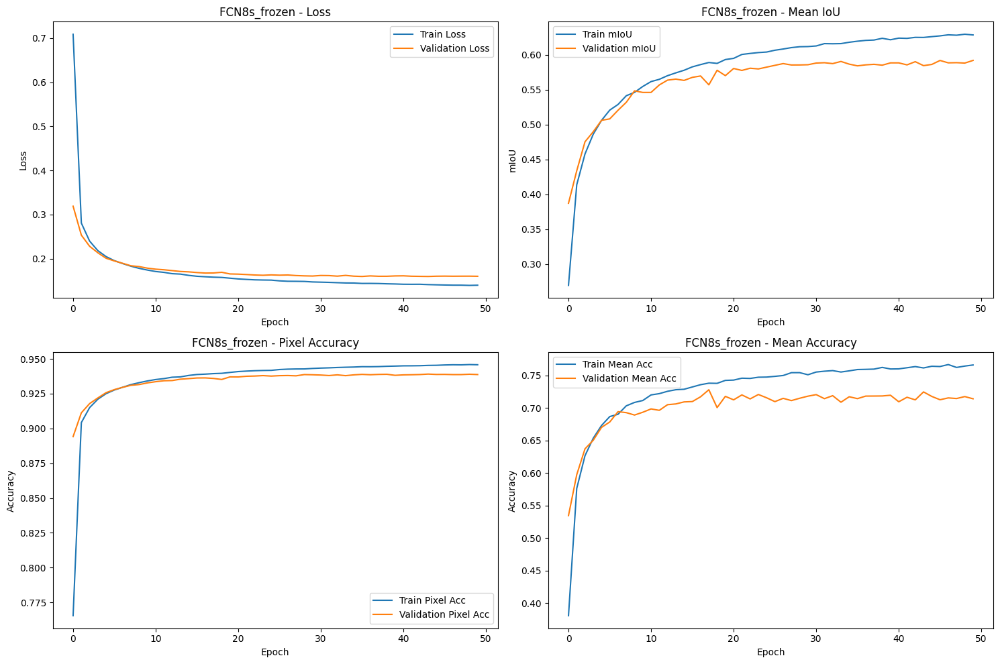

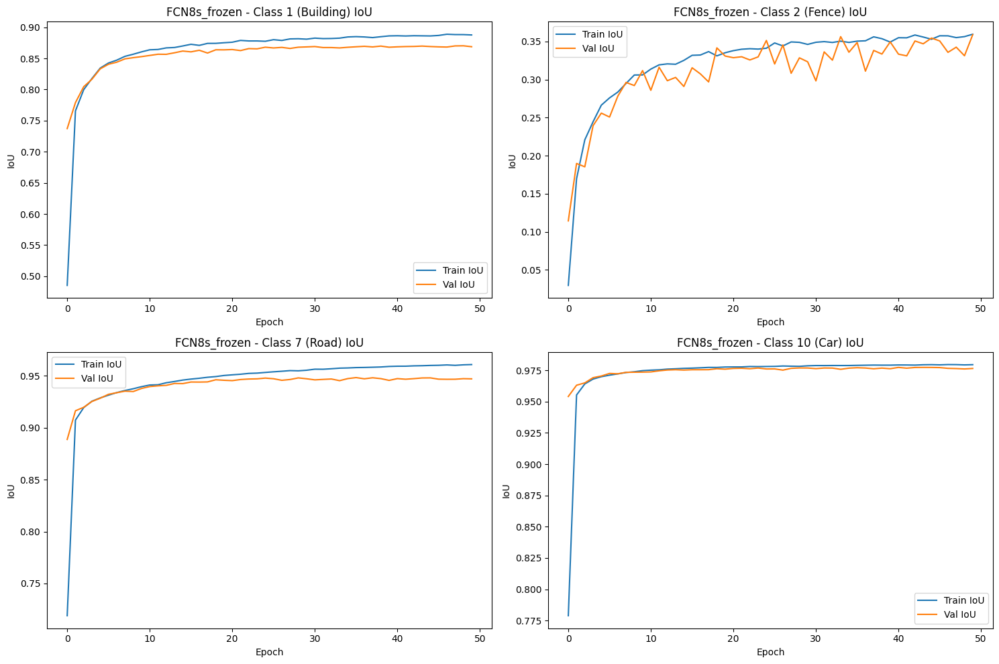

Evaluating FCN8s_frozen on test set...


Evaluating: 100%|██████████| 32/32 [00:19<00:00,  1.62it/s]


Test Results:
Loss: 0.1623
Pixel Accuracy: 0.9386
Mean Accuracy: 0.6808
Mean IoU: 0.5621
Average Inference Time: 0.0025s per batch, 0.15ms per image

Per-class IoU:
Class 1 (Building): IoU=0.8148
Class 2 (Fence): IoU=0.3159
Class 3 (Other): IoU=0.4367
Class 4 (Pedestrian): IoU=0.0109
Class 5 (Pole): IoU=0.2930
Class 6 (Roadline): IoU=0.4281
Class 7 (Road): IoU=0.9474
Class 8 (Sidewalk): IoU=0.8690
Class 9 (Vegetation): IoU=0.7804
Class 10 (Car): IoU=0.9756
Class 11 (Wall): IoU=0.5086
Class 12 (Traffic sign): IoU=0.3644


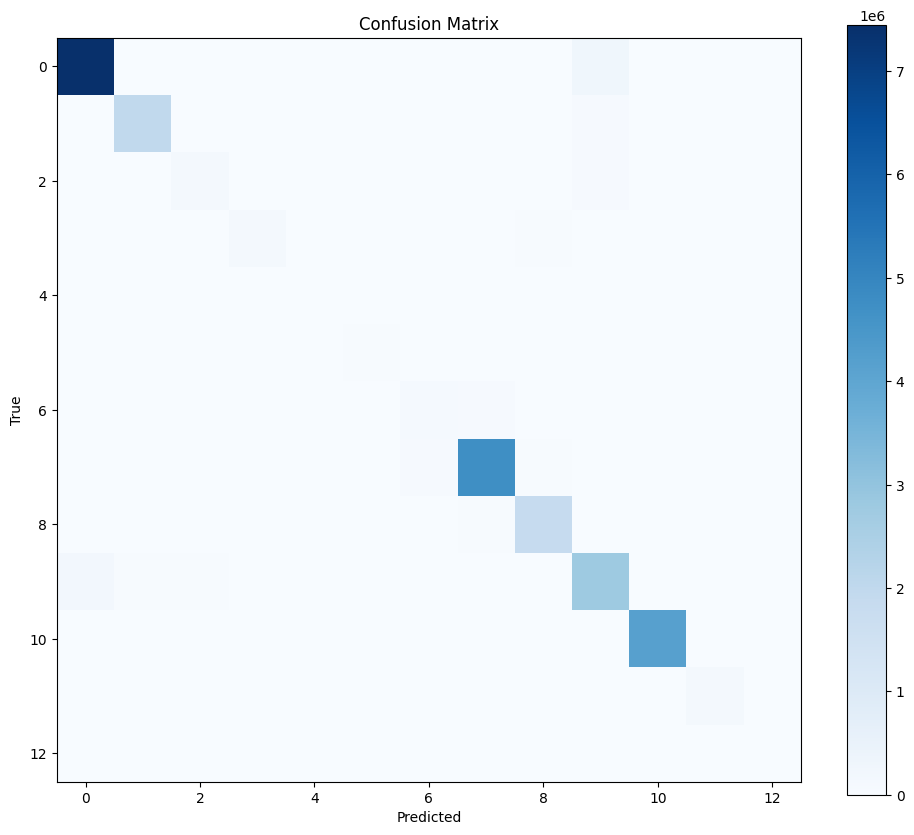

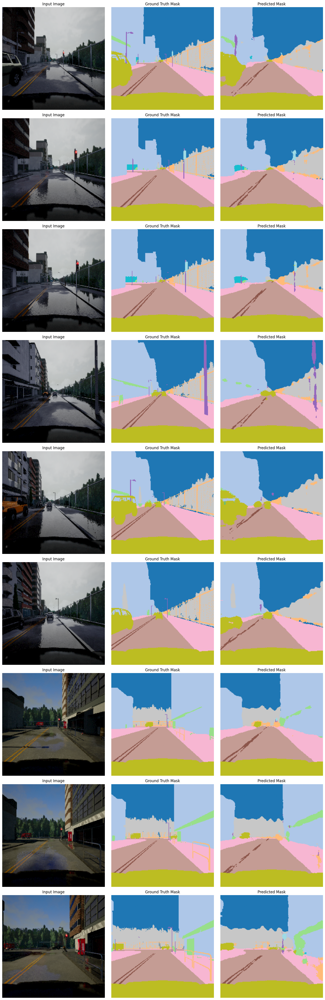


Training FCN32s_finetuned with 135,006,042 trainable parameters...
Training FCN32s_finetuned from scratch...


Epoch 1/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.49it/s, loss=0.724, iou=0.234, acc=0.749]


Saved best model with validation mIoU: 0.2354
Epoch 1/50 - Time: 44.48s - Train Loss: 1.1556 - Val Loss: 0.6848
Train - Pixel Acc: 0.6226, Mean Acc: 0.2350, mIoU: 0.1576
Val   - Pixel Acc: 0.7564, Mean Acc: 0.3497, mIoU: 0.2354
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.0919, Val IoU=0.2766
Class 2 (Fence): Train IoU=0.0007, Val IoU=0.0043
Class 7 (Road): Train IoU=0.5868, Val IoU=0.8031
Class 10 (Car): Train IoU=0.7197, Val IoU=0.8959


Epoch 2/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.474, iou=0.312, acc=0.859]


Saved best model with validation mIoU: 0.3029
Epoch 2/50 - Time: 43.06s - Train Loss: 0.5845 - Val Loss: 0.4730
Train - Pixel Acc: 0.7999, Mean Acc: 0.3748, mIoU: 0.2720
Val   - Pixel Acc: 0.8434, Mean Acc: 0.4127, mIoU: 0.3029
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.5091, Val IoU=0.6478
Class 2 (Fence): Train IoU=0.0263, Val IoU=0.0332
Class 7 (Road): Train IoU=0.8256, Val IoU=0.8640
Class 10 (Car): Train IoU=0.8956, Val IoU=0.8991


Epoch 3/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.399, iou=0.342, acc=0.874]


Saved best model with validation mIoU: 0.3335
Epoch 3/50 - Time: 42.65s - Train Loss: 0.4586 - Val Loss: 0.4080
Train - Pixel Acc: 0.8472, Mean Acc: 0.4251, mIoU: 0.3166
Val   - Pixel Acc: 0.8620, Mean Acc: 0.4697, mIoU: 0.3335
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.6655, Val IoU=0.6928
Class 2 (Fence): Train IoU=0.0559, Val IoU=0.0936
Class 7 (Road): Train IoU=0.8621, Val IoU=0.8722
Class 10 (Car): Train IoU=0.9017, Val IoU=0.9159


Epoch 4/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.18it/s, loss=0.362, iou=0.35, acc=0.881]


Saved best model with validation mIoU: 0.3491
Epoch 4/50 - Time: 42.62s - Train Loss: 0.4040 - Val Loss: 0.3645
Train - Pixel Acc: 0.8625, Mean Acc: 0.4654, mIoU: 0.3375
Val   - Pixel Acc: 0.8750, Mean Acc: 0.5153, mIoU: 0.3491
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.6904, Val IoU=0.7159
Class 2 (Fence): Train IoU=0.1031, Val IoU=0.0896
Class 7 (Road): Train IoU=0.8777, Val IoU=0.8923
Class 10 (Car): Train IoU=0.9121, Val IoU=0.9291


Epoch 5/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.92it/s, loss=0.332, iou=0.382, acc=0.891]


Saved best model with validation mIoU: 0.3810
Epoch 5/50 - Time: 43.16s - Train Loss: 0.3670 - Val Loss: 0.3345
Train - Pixel Acc: 0.8737, Mean Acc: 0.5020, mIoU: 0.3582
Val   - Pixel Acc: 0.8843, Mean Acc: 0.5535, mIoU: 0.3810
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7143, Val IoU=0.7385
Class 2 (Fence): Train IoU=0.1350, Val IoU=0.1480
Class 7 (Road): Train IoU=0.8903, Val IoU=0.9021
Class 10 (Car): Train IoU=0.9287, Val IoU=0.9407


Epoch 6/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.31, iou=0.402, acc=0.896]


Saved best model with validation mIoU: 0.3983
Epoch 6/50 - Time: 42.65s - Train Loss: 0.3416 - Val Loss: 0.3155
Train - Pixel Acc: 0.8808, Mean Acc: 0.5326, mIoU: 0.3769
Val   - Pixel Acc: 0.8888, Mean Acc: 0.5620, mIoU: 0.3983
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7298, Val IoU=0.7448
Class 2 (Fence): Train IoU=0.1638, Val IoU=0.1653
Class 7 (Road): Train IoU=0.8966, Val IoU=0.9045
Class 10 (Car): Train IoU=0.9382, Val IoU=0.9479


Epoch 7/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.05it/s, loss=0.304, iou=0.403, acc=0.898]


Saved best model with validation mIoU: 0.4066
Epoch 7/50 - Time: 42.88s - Train Loss: 0.3206 - Val Loss: 0.3006
Train - Pixel Acc: 0.8865, Mean Acc: 0.5612, mIoU: 0.3941
Val   - Pixel Acc: 0.8933, Mean Acc: 0.5970, mIoU: 0.4066
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7411, Val IoU=0.7584
Class 2 (Fence): Train IoU=0.1878, Val IoU=0.1883
Class 7 (Road): Train IoU=0.9011, Val IoU=0.9066
Class 10 (Car): Train IoU=0.9435, Val IoU=0.9497


Epoch 8/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.294, iou=0.421, acc=0.899]


Saved best model with validation mIoU: 0.4260
Epoch 8/50 - Time: 42.85s - Train Loss: 0.3033 - Val Loss: 0.2917
Train - Pixel Acc: 0.8913, Mean Acc: 0.5776, mIoU: 0.4069
Val   - Pixel Acc: 0.8953, Mean Acc: 0.5861, mIoU: 0.4260
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7540, Val IoU=0.7526
Class 2 (Fence): Train IoU=0.1994, Val IoU=0.2119
Class 7 (Road): Train IoU=0.9049, Val IoU=0.9115
Class 10 (Car): Train IoU=0.9476, Val IoU=0.9529


Epoch 9/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.282, iou=0.432, acc=0.903]


Saved best model with validation mIoU: 0.4366
Epoch 9/50 - Time: 42.93s - Train Loss: 0.2907 - Val Loss: 0.2757
Train - Pixel Acc: 0.8954, Mean Acc: 0.6014, mIoU: 0.4198
Val   - Pixel Acc: 0.8999, Mean Acc: 0.6149, mIoU: 0.4366
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7631, Val IoU=0.7770
Class 2 (Fence): Train IoU=0.2141, Val IoU=0.2459
Class 7 (Road): Train IoU=0.9086, Val IoU=0.9098
Class 10 (Car): Train IoU=0.9505, Val IoU=0.9533


Epoch 10/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.268, iou=0.438, acc=0.905]


Saved best model with validation mIoU: 0.4456
Epoch 10/50 - Time: 42.70s - Train Loss: 0.2789 - Val Loss: 0.2660
Train - Pixel Acc: 0.8987, Mean Acc: 0.6197, mIoU: 0.4332
Val   - Pixel Acc: 0.9026, Mean Acc: 0.6278, mIoU: 0.4456
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7699, Val IoU=0.7852
Class 2 (Fence): Train IoU=0.2306, Val IoU=0.2490
Class 7 (Road): Train IoU=0.9114, Val IoU=0.9135
Class 10 (Car): Train IoU=0.9523, Val IoU=0.9586


Epoch 11/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.255, iou=0.444, acc=0.908]


Saved best model with validation mIoU: 0.4520
Epoch 11/50 - Time: 42.78s - Train Loss: 0.2697 - Val Loss: 0.2593
Train - Pixel Acc: 0.9013, Mean Acc: 0.6240, mIoU: 0.4407
Val   - Pixel Acc: 0.9049, Mean Acc: 0.6235, mIoU: 0.4520
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7778, Val IoU=0.7876
Class 2 (Fence): Train IoU=0.2409, Val IoU=0.2583
Class 7 (Road): Train IoU=0.9140, Val IoU=0.9170
Class 10 (Car): Train IoU=0.9541, Val IoU=0.9583


Epoch 12/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.12it/s, loss=0.257, iou=0.447, acc=0.909]


Saved best model with validation mIoU: 0.4563
Epoch 12/50 - Time: 42.99s - Train Loss: 0.2626 - Val Loss: 0.2543
Train - Pixel Acc: 0.9033, Mean Acc: 0.6328, mIoU: 0.4493
Val   - Pixel Acc: 0.9058, Mean Acc: 0.6344, mIoU: 0.4563
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7854, Val IoU=0.7897
Class 2 (Fence): Train IoU=0.2499, Val IoU=0.2460
Class 7 (Road): Train IoU=0.9157, Val IoU=0.9175
Class 10 (Car): Train IoU=0.9555, Val IoU=0.9596


Epoch 13/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.244, iou=0.462, acc=0.912]


Saved best model with validation mIoU: 0.4696
Epoch 13/50 - Time: 42.88s - Train Loss: 0.2554 - Val Loss: 0.2474
Train - Pixel Acc: 0.9054, Mean Acc: 0.6385, mIoU: 0.4595
Val   - Pixel Acc: 0.9082, Mean Acc: 0.6472, mIoU: 0.4696
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7876, Val IoU=0.7977
Class 2 (Fence): Train IoU=0.2573, Val IoU=0.2630
Class 7 (Road): Train IoU=0.9168, Val IoU=0.9188
Class 10 (Car): Train IoU=0.9572, Val IoU=0.9605


Epoch 14/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  5.00it/s, loss=0.242, iou=0.47, acc=0.912]


Saved best model with validation mIoU: 0.4792
Epoch 14/50 - Time: 42.72s - Train Loss: 0.2498 - Val Loss: 0.2432
Train - Pixel Acc: 0.9070, Mean Acc: 0.6546, mIoU: 0.4675
Val   - Pixel Acc: 0.9097, Mean Acc: 0.6586, mIoU: 0.4792
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7891, Val IoU=0.8036
Class 2 (Fence): Train IoU=0.2645, Val IoU=0.2585
Class 7 (Road): Train IoU=0.9193, Val IoU=0.9179
Class 10 (Car): Train IoU=0.9582, Val IoU=0.9589


Epoch 15/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.231, iou=0.482, acc=0.915]


Saved best model with validation mIoU: 0.4888
Epoch 15/50 - Time: 42.78s - Train Loss: 0.2433 - Val Loss: 0.2364
Train - Pixel Acc: 0.9093, Mean Acc: 0.6592, mIoU: 0.4755
Val   - Pixel Acc: 0.9120, Mean Acc: 0.6642, mIoU: 0.4888
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8018, Val IoU=0.8063
Class 2 (Fence): Train IoU=0.2776, Val IoU=0.2806
Class 7 (Road): Train IoU=0.9208, Val IoU=0.9208
Class 10 (Car): Train IoU=0.9590, Val IoU=0.9633


Epoch 16/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.229, iou=0.489, acc=0.916]


Epoch 16/50 - Time: 41.34s - Train Loss: 0.2385 - Val Loss: 0.2348
Train - Pixel Acc: 0.9105, Mean Acc: 0.6674, mIoU: 0.4827
Val   - Pixel Acc: 0.9126, Mean Acc: 0.6723, mIoU: 0.4850
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8040, Val IoU=0.8089
Class 2 (Fence): Train IoU=0.2775, Val IoU=0.2780
Class 7 (Road): Train IoU=0.9218, Val IoU=0.9225
Class 10 (Car): Train IoU=0.9601, Val IoU=0.9638


Epoch 17/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.221, iou=0.491, acc=0.919]


Saved best model with validation mIoU: 0.4933
Epoch 17/50 - Time: 42.46s - Train Loss: 0.2350 - Val Loss: 0.2281
Train - Pixel Acc: 0.9117, Mean Acc: 0.6685, mIoU: 0.4865
Val   - Pixel Acc: 0.9148, Mean Acc: 0.6753, mIoU: 0.4933
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8060, Val IoU=0.8139
Class 2 (Fence): Train IoU=0.2808, Val IoU=0.2856
Class 7 (Road): Train IoU=0.9233, Val IoU=0.9246
Class 10 (Car): Train IoU=0.9608, Val IoU=0.9637


Epoch 18/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.224, iou=0.497, acc=0.918]


Saved best model with validation mIoU: 0.4950
Epoch 18/50 - Time: 42.68s - Train Loss: 0.2298 - Val Loss: 0.2271
Train - Pixel Acc: 0.9133, Mean Acc: 0.6729, mIoU: 0.4936
Val   - Pixel Acc: 0.9147, Mean Acc: 0.6777, mIoU: 0.4950
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8128, Val IoU=0.8159
Class 2 (Fence): Train IoU=0.2909, Val IoU=0.2894
Class 7 (Road): Train IoU=0.9242, Val IoU=0.9245
Class 10 (Car): Train IoU=0.9612, Val IoU=0.9638


Epoch 19/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.12it/s, loss=0.221, iou=0.499, acc=0.918]


Saved best model with validation mIoU: 0.5017
Epoch 19/50 - Time: 43.02s - Train Loss: 0.2272 - Val Loss: 0.2251
Train - Pixel Acc: 0.9141, Mean Acc: 0.6781, mIoU: 0.4984
Val   - Pixel Acc: 0.9153, Mean Acc: 0.6737, mIoU: 0.5017
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8141, Val IoU=0.8175
Class 2 (Fence): Train IoU=0.2889, Val IoU=0.3141
Class 7 (Road): Train IoU=0.9249, Val IoU=0.9255
Class 10 (Car): Train IoU=0.9620, Val IoU=0.9648


Epoch 20/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.215, iou=0.499, acc=0.919]


Saved best model with validation mIoU: 0.5065
Epoch 20/50 - Time: 42.61s - Train Loss: 0.2234 - Val Loss: 0.2199
Train - Pixel Acc: 0.9153, Mean Acc: 0.6830, mIoU: 0.5040
Val   - Pixel Acc: 0.9166, Mean Acc: 0.6871, mIoU: 0.5065
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8158, Val IoU=0.8213
Class 2 (Fence): Train IoU=0.3004, Val IoU=0.3062
Class 7 (Road): Train IoU=0.9269, Val IoU=0.9260
Class 10 (Car): Train IoU=0.9629, Val IoU=0.9650


Epoch 21/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.215, iou=0.506, acc=0.921]


Saved best model with validation mIoU: 0.5082
Epoch 21/50 - Time: 42.48s - Train Loss: 0.2203 - Val Loss: 0.2233
Train - Pixel Acc: 0.9164, Mean Acc: 0.6859, mIoU: 0.5072
Val   - Pixel Acc: 0.9171, Mean Acc: 0.6849, mIoU: 0.5082
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8194, Val IoU=0.8191
Class 2 (Fence): Train IoU=0.3015, Val IoU=0.3028
Class 7 (Road): Train IoU=0.9278, Val IoU=0.9262
Class 10 (Car): Train IoU=0.9634, Val IoU=0.9643


Epoch 22/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.207, iou=0.505, acc=0.921]


Saved best model with validation mIoU: 0.5092
Epoch 22/50 - Time: 42.96s - Train Loss: 0.2173 - Val Loss: 0.2167
Train - Pixel Acc: 0.9174, Mean Acc: 0.6959, mIoU: 0.5119
Val   - Pixel Acc: 0.9179, Mean Acc: 0.6923, mIoU: 0.5092
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8227, Val IoU=0.8229
Class 2 (Fence): Train IoU=0.3105, Val IoU=0.2948
Class 7 (Road): Train IoU=0.9282, Val IoU=0.9261
Class 10 (Car): Train IoU=0.9632, Val IoU=0.9662


Epoch 23/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.203, iou=0.516, acc=0.923]


Saved best model with validation mIoU: 0.5102
Epoch 23/50 - Time: 42.73s - Train Loss: 0.2152 - Val Loss: 0.2157
Train - Pixel Acc: 0.9179, Mean Acc: 0.6922, mIoU: 0.5166
Val   - Pixel Acc: 0.9188, Mean Acc: 0.7047, mIoU: 0.5102
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8215, Val IoU=0.8223
Class 2 (Fence): Train IoU=0.3097, Val IoU=0.3102
Class 7 (Road): Train IoU=0.9297, Val IoU=0.9282
Class 10 (Car): Train IoU=0.9644, Val IoU=0.9652


Epoch 24/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.201, iou=0.52, acc=0.924]


Saved best model with validation mIoU: 0.5161
Epoch 24/50 - Time: 42.54s - Train Loss: 0.2124 - Val Loss: 0.2115
Train - Pixel Acc: 0.9190, Mean Acc: 0.7017, mIoU: 0.5188
Val   - Pixel Acc: 0.9201, Mean Acc: 0.6991, mIoU: 0.5161
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8277, Val IoU=0.8264
Class 2 (Fence): Train IoU=0.3144, Val IoU=0.3183
Class 7 (Road): Train IoU=0.9308, Val IoU=0.9308
Class 10 (Car): Train IoU=0.9641, Val IoU=0.9673


Epoch 25/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.89it/s, loss=0.202, iou=0.525, acc=0.926]


Saved best model with validation mIoU: 0.5191
Epoch 25/50 - Time: 42.86s - Train Loss: 0.2101 - Val Loss: 0.2108
Train - Pixel Acc: 0.9198, Mean Acc: 0.7058, mIoU: 0.5257
Val   - Pixel Acc: 0.9208, Mean Acc: 0.6939, mIoU: 0.5191
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8281, Val IoU=0.8279
Class 2 (Fence): Train IoU=0.3170, Val IoU=0.3062
Class 7 (Road): Train IoU=0.9319, Val IoU=0.9323
Class 10 (Car): Train IoU=0.9645, Val IoU=0.9666


Epoch 26/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.203, iou=0.524, acc=0.925]


Saved best model with validation mIoU: 0.5232
Epoch 26/50 - Time: 42.70s - Train Loss: 0.2082 - Val Loss: 0.2087
Train - Pixel Acc: 0.9206, Mean Acc: 0.7119, mIoU: 0.5294
Val   - Pixel Acc: 0.9213, Mean Acc: 0.6948, mIoU: 0.5232
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8290, Val IoU=0.8317
Class 2 (Fence): Train IoU=0.3251, Val IoU=0.3216
Class 7 (Road): Train IoU=0.9331, Val IoU=0.9327
Class 10 (Car): Train IoU=0.9655, Val IoU=0.9664


Epoch 27/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.195, iou=0.532, acc=0.928]


Saved best model with validation mIoU: 0.5257
Epoch 27/50 - Time: 42.84s - Train Loss: 0.2061 - Val Loss: 0.2074
Train - Pixel Acc: 0.9213, Mean Acc: 0.7148, mIoU: 0.5319
Val   - Pixel Acc: 0.9221, Mean Acc: 0.6984, mIoU: 0.5257
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8300, Val IoU=0.8283
Class 2 (Fence): Train IoU=0.3226, Val IoU=0.3284
Class 7 (Road): Train IoU=0.9346, Val IoU=0.9355
Class 10 (Car): Train IoU=0.9656, Val IoU=0.9674


Epoch 28/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.197, iou=0.538, acc=0.928]


Saved best model with validation mIoU: 0.5318
Epoch 28/50 - Time: 42.48s - Train Loss: 0.2038 - Val Loss: 0.2058
Train - Pixel Acc: 0.9222, Mean Acc: 0.7191, mIoU: 0.5392
Val   - Pixel Acc: 0.9233, Mean Acc: 0.6994, mIoU: 0.5318
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8320, Val IoU=0.8314
Class 2 (Fence): Train IoU=0.3280, Val IoU=0.3231
Class 7 (Road): Train IoU=0.9373, Val IoU=0.9384
Class 10 (Car): Train IoU=0.9658, Val IoU=0.9674


Epoch 29/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.198, iou=0.534, acc=0.926]


Saved best model with validation mIoU: 0.5341
Epoch 29/50 - Time: 42.93s - Train Loss: 0.2023 - Val Loss: 0.2044
Train - Pixel Acc: 0.9227, Mean Acc: 0.7216, mIoU: 0.5404
Val   - Pixel Acc: 0.9232, Mean Acc: 0.7034, mIoU: 0.5341
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8321, Val IoU=0.8333
Class 2 (Fence): Train IoU=0.3264, Val IoU=0.3202
Class 7 (Road): Train IoU=0.9380, Val IoU=0.9382
Class 10 (Car): Train IoU=0.9656, Val IoU=0.9670


Epoch 30/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.197, iou=0.537, acc=0.928]


Saved best model with validation mIoU: 0.5365
Epoch 30/50 - Time: 43.06s - Train Loss: 0.2009 - Val Loss: 0.2024
Train - Pixel Acc: 0.9234, Mean Acc: 0.7263, mIoU: 0.5465
Val   - Pixel Acc: 0.9246, Mean Acc: 0.7124, mIoU: 0.5365
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8348, Val IoU=0.8339
Class 2 (Fence): Train IoU=0.3305, Val IoU=0.3243
Class 7 (Road): Train IoU=0.9398, Val IoU=0.9424
Class 10 (Car): Train IoU=0.9660, Val IoU=0.9678


Epoch 31/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.89it/s, loss=0.19, iou=0.549, acc=0.93]


Saved best model with validation mIoU: 0.5423
Epoch 31/50 - Time: 43.01s - Train Loss: 0.1980 - Val Loss: 0.2006
Train - Pixel Acc: 0.9245, Mean Acc: 0.7268, mIoU: 0.5496
Val   - Pixel Acc: 0.9252, Mean Acc: 0.7101, mIoU: 0.5423
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8369, Val IoU=0.8344
Class 2 (Fence): Train IoU=0.3311, Val IoU=0.3365
Class 7 (Road): Train IoU=0.9426, Val IoU=0.9434
Class 10 (Car): Train IoU=0.9663, Val IoU=0.9683


Epoch 32/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.19, iou=0.544, acc=0.928]


Epoch 32/50 - Time: 41.45s - Train Loss: 0.1972 - Val Loss: 0.2012
Train - Pixel Acc: 0.9249, Mean Acc: 0.7334, mIoU: 0.5526
Val   - Pixel Acc: 0.9245, Mean Acc: 0.7094, mIoU: 0.5415
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8364, Val IoU=0.8306
Class 2 (Fence): Train IoU=0.3325, Val IoU=0.3336
Class 7 (Road): Train IoU=0.9431, Val IoU=0.9425
Class 10 (Car): Train IoU=0.9663, Val IoU=0.9689


Epoch 33/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.12it/s, loss=0.186, iou=0.554, acc=0.932]


Saved best model with validation mIoU: 0.5474
Epoch 33/50 - Time: 42.89s - Train Loss: 0.1948 - Val Loss: 0.1976
Train - Pixel Acc: 0.9257, Mean Acc: 0.7353, mIoU: 0.5573
Val   - Pixel Acc: 0.9266, Mean Acc: 0.7241, mIoU: 0.5474
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8394, Val IoU=0.8388
Class 2 (Fence): Train IoU=0.3342, Val IoU=0.3338
Class 7 (Road): Train IoU=0.9443, Val IoU=0.9464
Class 10 (Car): Train IoU=0.9670, Val IoU=0.9692


Epoch 34/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.187, iou=0.551, acc=0.931]


Epoch 34/50 - Time: 41.25s - Train Loss: 0.1934 - Val Loss: 0.1975
Train - Pixel Acc: 0.9262, Mean Acc: 0.7400, mIoU: 0.5613
Val   - Pixel Acc: 0.9261, Mean Acc: 0.7173, mIoU: 0.5469
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8399, Val IoU=0.8365
Class 2 (Fence): Train IoU=0.3343, Val IoU=0.3269
Class 7 (Road): Train IoU=0.9456, Val IoU=0.9442
Class 10 (Car): Train IoU=0.9671, Val IoU=0.9688


Epoch 35/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.17it/s, loss=0.189, iou=0.56, acc=0.932]


Saved best model with validation mIoU: 0.5522
Epoch 35/50 - Time: 42.43s - Train Loss: 0.1926 - Val Loss: 0.1971
Train - Pixel Acc: 0.9265, Mean Acc: 0.7385, mIoU: 0.5633
Val   - Pixel Acc: 0.9267, Mean Acc: 0.7190, mIoU: 0.5522
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8407, Val IoU=0.8375
Class 2 (Fence): Train IoU=0.3338, Val IoU=0.3475
Class 7 (Road): Train IoU=0.9460, Val IoU=0.9478
Class 10 (Car): Train IoU=0.9672, Val IoU=0.9680


Epoch 36/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.186, iou=0.565, acc=0.931]


Saved best model with validation mIoU: 0.5533
Epoch 36/50 - Time: 42.82s - Train Loss: 0.1913 - Val Loss: 0.1954
Train - Pixel Acc: 0.9271, Mean Acc: 0.7416, mIoU: 0.5648
Val   - Pixel Acc: 0.9269, Mean Acc: 0.7198, mIoU: 0.5533
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8407, Val IoU=0.8371
Class 2 (Fence): Train IoU=0.3385, Val IoU=0.3410
Class 7 (Road): Train IoU=0.9469, Val IoU=0.9476
Class 10 (Car): Train IoU=0.9676, Val IoU=0.9693


Epoch 37/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.00it/s, loss=0.18, iou=0.557, acc=0.932]


Saved best model with validation mIoU: 0.5536
Epoch 37/50 - Time: 42.76s - Train Loss: 0.1902 - Val Loss: 0.1954
Train - Pixel Acc: 0.9274, Mean Acc: 0.7438, mIoU: 0.5680
Val   - Pixel Acc: 0.9269, Mean Acc: 0.7299, mIoU: 0.5536
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8392, Val IoU=0.8325
Class 2 (Fence): Train IoU=0.3369, Val IoU=0.3402
Class 7 (Road): Train IoU=0.9478, Val IoU=0.9505
Class 10 (Car): Train IoU=0.9674, Val IoU=0.9690


Epoch 38/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.185, iou=0.569, acc=0.934]


Saved best model with validation mIoU: 0.5584
Epoch 38/50 - Time: 42.56s - Train Loss: 0.1881 - Val Loss: 0.1946
Train - Pixel Acc: 0.9281, Mean Acc: 0.7439, mIoU: 0.5714
Val   - Pixel Acc: 0.9280, Mean Acc: 0.7186, mIoU: 0.5584
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8423, Val IoU=0.8411
Class 2 (Fence): Train IoU=0.3391, Val IoU=0.3413
Class 7 (Road): Train IoU=0.9487, Val IoU=0.9484
Class 10 (Car): Train IoU=0.9680, Val IoU=0.9695


Epoch 39/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.185, iou=0.573, acc=0.934]


Epoch 39/50 - Time: 41.39s - Train Loss: 0.1879 - Val Loss: 0.1930
Train - Pixel Acc: 0.9282, Mean Acc: 0.7465, mIoU: 0.5713
Val   - Pixel Acc: 0.9285, Mean Acc: 0.7248, mIoU: 0.5570
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8442, Val IoU=0.8405
Class 2 (Fence): Train IoU=0.3411, Val IoU=0.3289
Class 7 (Road): Train IoU=0.9483, Val IoU=0.9501
Class 10 (Car): Train IoU=0.9676, Val IoU=0.9697


Epoch 40/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.185, iou=0.569, acc=0.932]


Saved best model with validation mIoU: 0.5601
Epoch 40/50 - Time: 42.72s - Train Loss: 0.1869 - Val Loss: 0.1924
Train - Pixel Acc: 0.9286, Mean Acc: 0.7471, mIoU: 0.5747
Val   - Pixel Acc: 0.9282, Mean Acc: 0.7160, mIoU: 0.5601
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8436, Val IoU=0.8409
Class 2 (Fence): Train IoU=0.3430, Val IoU=0.3381
Class 7 (Road): Train IoU=0.9496, Val IoU=0.9497
Class 10 (Car): Train IoU=0.9683, Val IoU=0.9684


Epoch 41/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.179, iou=0.574, acc=0.934]


Saved best model with validation mIoU: 0.5610
Epoch 41/50 - Time: 42.55s - Train Loss: 0.1855 - Val Loss: 0.1906
Train - Pixel Acc: 0.9291, Mean Acc: 0.7446, mIoU: 0.5755
Val   - Pixel Acc: 0.9292, Mean Acc: 0.7302, mIoU: 0.5610
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8462, Val IoU=0.8429
Class 2 (Fence): Train IoU=0.3463, Val IoU=0.3411
Class 7 (Road): Train IoU=0.9501, Val IoU=0.9517
Class 10 (Car): Train IoU=0.9682, Val IoU=0.9698


Epoch 42/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.18, iou=0.575, acc=0.934]


Saved best model with validation mIoU: 0.5634
Epoch 42/50 - Time: 42.53s - Train Loss: 0.1841 - Val Loss: 0.1892
Train - Pixel Acc: 0.9296, Mean Acc: 0.7457, mIoU: 0.5774
Val   - Pixel Acc: 0.9295, Mean Acc: 0.7340, mIoU: 0.5634
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8483, Val IoU=0.8425
Class 2 (Fence): Train IoU=0.3472, Val IoU=0.3368
Class 7 (Road): Train IoU=0.9511, Val IoU=0.9525
Class 10 (Car): Train IoU=0.9690, Val IoU=0.9699


Epoch 43/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.91it/s, loss=0.18, iou=0.578, acc=0.934]


Saved best model with validation mIoU: 0.5635
Epoch 43/50 - Time: 42.84s - Train Loss: 0.1837 - Val Loss: 0.1892
Train - Pixel Acc: 0.9298, Mean Acc: 0.7519, mIoU: 0.5815
Val   - Pixel Acc: 0.9295, Mean Acc: 0.7291, mIoU: 0.5635
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8476, Val IoU=0.8426
Class 2 (Fence): Train IoU=0.3480, Val IoU=0.3378
Class 7 (Road): Train IoU=0.9516, Val IoU=0.9517
Class 10 (Car): Train IoU=0.9687, Val IoU=0.9700


Epoch 44/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.178, iou=0.579, acc=0.936]


Saved best model with validation mIoU: 0.5669
Epoch 44/50 - Time: 42.71s - Train Loss: 0.1824 - Val Loss: 0.1892
Train - Pixel Acc: 0.9301, Mean Acc: 0.7531, mIoU: 0.5827
Val   - Pixel Acc: 0.9299, Mean Acc: 0.7289, mIoU: 0.5669
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8479, Val IoU=0.8444
Class 2 (Fence): Train IoU=0.3519, Val IoU=0.3412
Class 7 (Road): Train IoU=0.9520, Val IoU=0.9529
Class 10 (Car): Train IoU=0.9689, Val IoU=0.9696


Epoch 45/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.176, iou=0.586, acc=0.936]


Epoch 45/50 - Time: 41.18s - Train Loss: 0.1822 - Val Loss: 0.1886
Train - Pixel Acc: 0.9303, Mean Acc: 0.7489, mIoU: 0.5810
Val   - Pixel Acc: 0.9300, Mean Acc: 0.7329, mIoU: 0.5605
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8467, Val IoU=0.8456
Class 2 (Fence): Train IoU=0.3530, Val IoU=0.3389
Class 7 (Road): Train IoU=0.9524, Val IoU=0.9525
Class 10 (Car): Train IoU=0.9686, Val IoU=0.9703


Epoch 46/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.13it/s, loss=0.177, iou=0.586, acc=0.936]


Epoch 46/50 - Time: 41.13s - Train Loss: 0.1813 - Val Loss: 0.1866
Train - Pixel Acc: 0.9306, Mean Acc: 0.7509, mIoU: 0.5846
Val   - Pixel Acc: 0.9306, Mean Acc: 0.7276, mIoU: 0.5667
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8503, Val IoU=0.8475
Class 2 (Fence): Train IoU=0.3542, Val IoU=0.3465
Class 7 (Road): Train IoU=0.9522, Val IoU=0.9526
Class 10 (Car): Train IoU=0.9688, Val IoU=0.9699


Epoch 47/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.173, iou=0.575, acc=0.934]


Epoch 47/50 - Time: 41.35s - Train Loss: 0.1803 - Val Loss: 0.1867
Train - Pixel Acc: 0.9309, Mean Acc: 0.7516, mIoU: 0.5847
Val   - Pixel Acc: 0.9302, Mean Acc: 0.7290, mIoU: 0.5654
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8499, Val IoU=0.8443
Class 2 (Fence): Train IoU=0.3507, Val IoU=0.3488
Class 7 (Road): Train IoU=0.9531, Val IoU=0.9531
Class 10 (Car): Train IoU=0.9693, Val IoU=0.9707


Epoch 48/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.179, iou=0.583, acc=0.934]


Epoch 48/50 - Time: 41.05s - Train Loss: 0.1806 - Val Loss: 0.1887
Train - Pixel Acc: 0.9308, Mean Acc: 0.7548, mIoU: 0.5875
Val   - Pixel Acc: 0.9296, Mean Acc: 0.7289, mIoU: 0.5649
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8498, Val IoU=0.8427
Class 2 (Fence): Train IoU=0.3526, Val IoU=0.3542
Class 7 (Road): Train IoU=0.9530, Val IoU=0.9521
Class 10 (Car): Train IoU=0.9689, Val IoU=0.9694


Epoch 49/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.174, iou=0.582, acc=0.935]


Epoch 49/50 - Time: 41.10s - Train Loss: 0.1790 - Val Loss: 0.1881
Train - Pixel Acc: 0.9313, Mean Acc: 0.7551, mIoU: 0.5885
Val   - Pixel Acc: 0.9300, Mean Acc: 0.7317, mIoU: 0.5665
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8484, Val IoU=0.8440
Class 2 (Fence): Train IoU=0.3568, Val IoU=0.3420
Class 7 (Road): Train IoU=0.9540, Val IoU=0.9518
Class 10 (Car): Train IoU=0.9694, Val IoU=0.9704


Epoch 50/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.178, iou=0.573, acc=0.935]


Saved best model with validation mIoU: 0.5680
Epoch 50/50 - Time: 42.61s - Train Loss: 0.1781 - Val Loss: 0.1862
Train - Pixel Acc: 0.9316, Mean Acc: 0.7540, mIoU: 0.5883
Val   - Pixel Acc: 0.9306, Mean Acc: 0.7196, mIoU: 0.5680
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8516, Val IoU=0.8447
Class 2 (Fence): Train IoU=0.3570, Val IoU=0.3496
Class 7 (Road): Train IoU=0.9537, Val IoU=0.9547
Class 10 (Car): Train IoU=0.9694, Val IoU=0.9707
Training complete. Average time per epoch: 42.52s. Total training time: 2126.17s


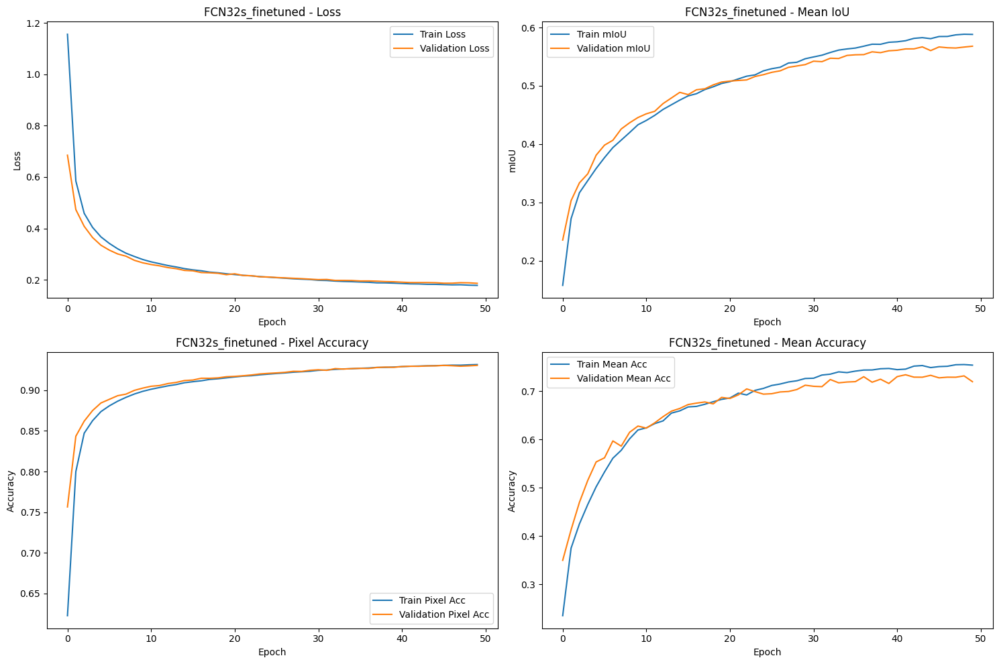

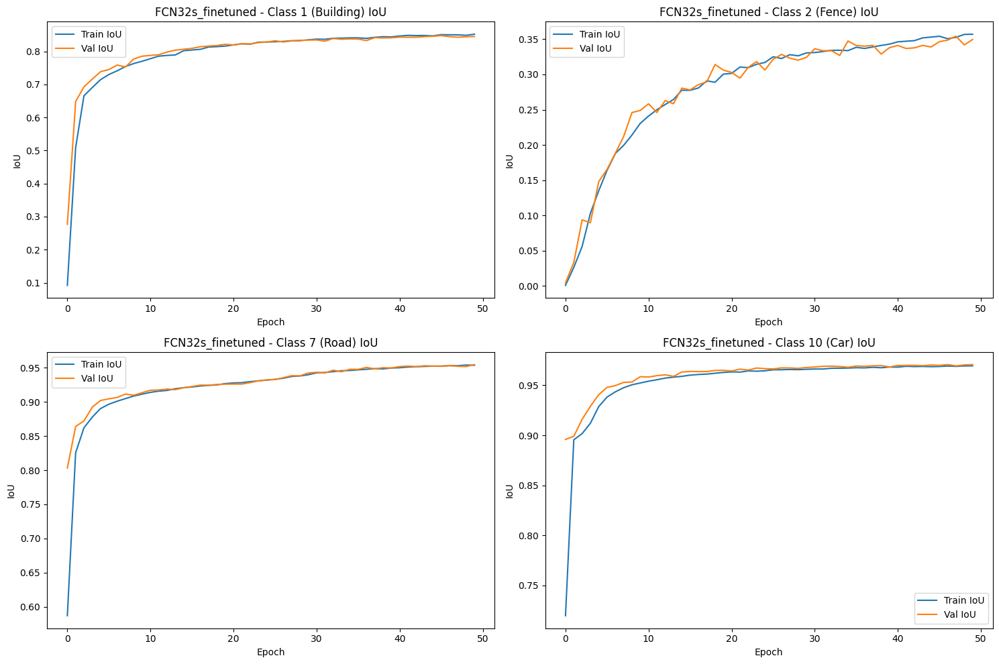

Evaluating FCN32s_finetuned on test set...


Evaluating: 100%|██████████| 32/32 [00:19<00:00,  1.63it/s]


Test Results:
Loss: 0.1897
Pixel Accuracy: 0.9300
Mean Accuracy: 0.6740
Mean IoU: 0.5392
Average Inference Time: 0.0020s per batch, 0.13ms per image

Per-class IoU:
Class 1 (Building): IoU=0.7967
Class 2 (Fence): IoU=0.3120
Class 3 (Other): IoU=0.3617
Class 4 (Pedestrian): IoU=0.0174
Class 5 (Pole): IoU=0.1287
Class 6 (Roadline): IoU=0.5929
Class 7 (Road): IoU=0.9538
Class 8 (Sidewalk): IoU=0.8513
Class 9 (Vegetation): IoU=0.7410
Class 10 (Car): IoU=0.9678
Class 11 (Wall): IoU=0.4861
Class 12 (Traffic sign): IoU=0.2606


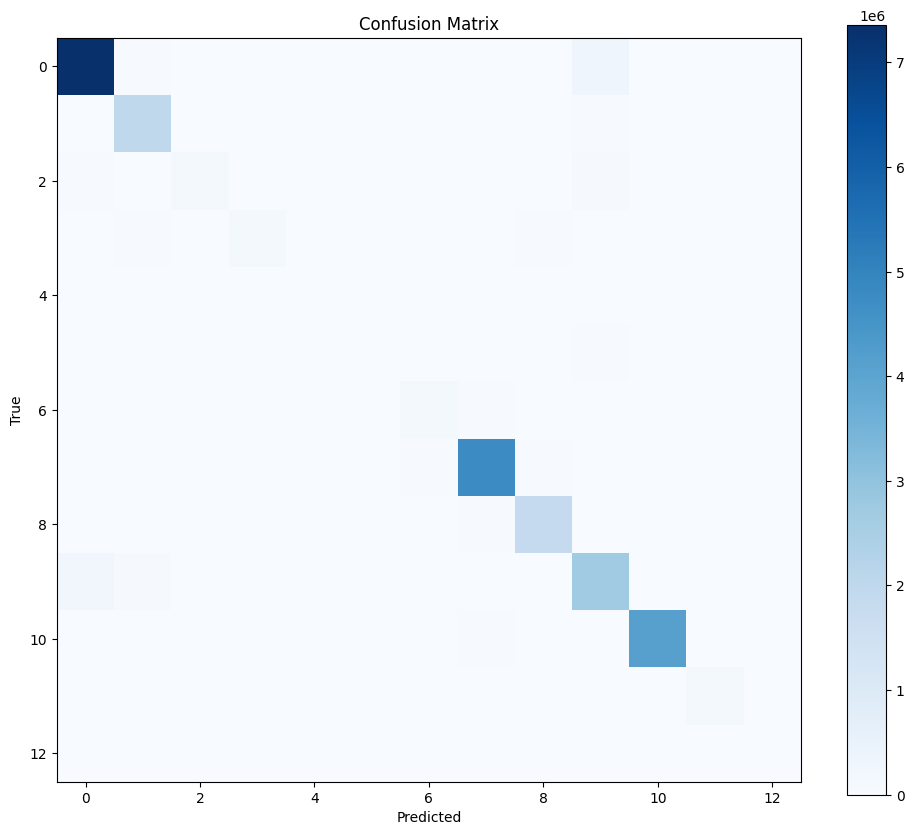

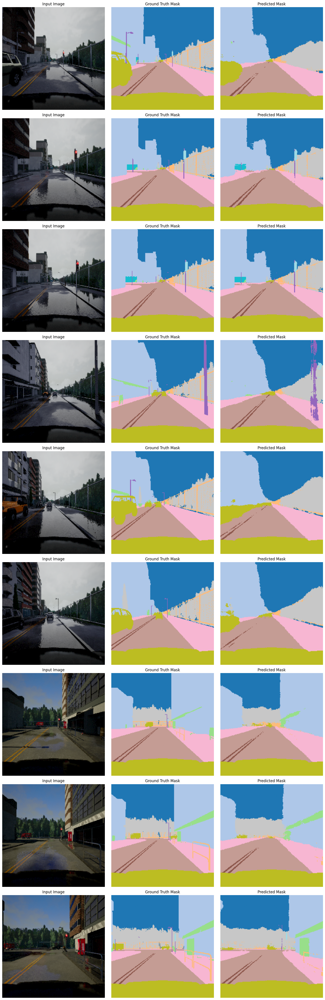


Training FCN16s_finetuned with 134,496,260 trainable parameters...
Training FCN16s_finetuned from scratch...


Epoch 1/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.22it/s, loss=0.36, iou=0.354, acc=0.882]


Saved best model with validation mIoU: 0.3500
Epoch 1/50 - Time: 44.75s - Train Loss: 0.8927 - Val Loss: 0.3544
Train - Pixel Acc: 0.7270, Mean Acc: 0.3303, mIoU: 0.2410
Val   - Pixel Acc: 0.8791, Mean Acc: 0.4688, mIoU: 0.3500
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.4244, Val IoU=0.6788
Class 2 (Fence): Train IoU=0.0259, Val IoU=0.0631
Class 7 (Road): Train IoU=0.6964, Val IoU=0.9029
Class 10 (Car): Train IoU=0.7524, Val IoU=0.9478


Epoch 2/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.274, iou=0.414, acc=0.908]


Saved best model with validation mIoU: 0.4258
Epoch 2/50 - Time: 42.23s - Train Loss: 0.2967 - Val Loss: 0.2639
Train - Pixel Acc: 0.8975, Mean Acc: 0.5332, mIoU: 0.3867
Val   - Pixel Acc: 0.9064, Mean Acc: 0.5620, mIoU: 0.4258
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7493, Val IoU=0.7749
Class 2 (Fence): Train IoU=0.1393, Val IoU=0.1933
Class 7 (Road): Train IoU=0.9130, Val IoU=0.9217
Class 10 (Car): Train IoU=0.9507, Val IoU=0.9605


Epoch 3/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.222, iou=0.452, acc=0.92]


Saved best model with validation mIoU: 0.4599
Epoch 3/50 - Time: 41.97s - Train Loss: 0.2331 - Val Loss: 0.2174
Train - Pixel Acc: 0.9149, Mean Acc: 0.6272, mIoU: 0.4575
Val   - Pixel Acc: 0.9191, Mean Acc: 0.6524, mIoU: 0.4599
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8054, Val IoU=0.8141
Class 2 (Fence): Train IoU=0.2285, Val IoU=0.2208
Class 7 (Road): Train IoU=0.9264, Val IoU=0.9285
Class 10 (Car): Train IoU=0.9626, Val IoU=0.9675


Epoch 4/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.192, iou=0.495, acc=0.929]


Saved best model with validation mIoU: 0.5103
Epoch 4/50 - Time: 41.89s - Train Loss: 0.1987 - Val Loss: 0.1914
Train - Pixel Acc: 0.9251, Mean Acc: 0.6777, mIoU: 0.5084
Val   - Pixel Acc: 0.9278, Mean Acc: 0.6864, mIoU: 0.5103
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8313, Val IoU=0.8392
Class 2 (Fence): Train IoU=0.2674, Val IoU=0.2815
Class 7 (Road): Train IoU=0.9362, Val IoU=0.9416
Class 10 (Car): Train IoU=0.9682, Val IoU=0.9702


Epoch 5/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.174, iou=0.554, acc=0.936]


Saved best model with validation mIoU: 0.5614
Epoch 5/50 - Time: 42.49s - Train Loss: 0.1759 - Val Loss: 0.1796
Train - Pixel Acc: 0.9334, Mean Acc: 0.7218, mIoU: 0.5609
Val   - Pixel Acc: 0.9314, Mean Acc: 0.7056, mIoU: 0.5614
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8531, Val IoU=0.8515
Class 2 (Fence): Train IoU=0.2934, Val IoU=0.3131
Class 7 (Road): Train IoU=0.9516, Val IoU=0.9525
Class 10 (Car): Train IoU=0.9717, Val IoU=0.9713


Epoch 6/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.82it/s, loss=0.154, iou=0.583, acc=0.942]


Saved best model with validation mIoU: 0.5756
Epoch 6/50 - Time: 42.07s - Train Loss: 0.1604 - Val Loss: 0.1648
Train - Pixel Acc: 0.9387, Mean Acc: 0.7477, mIoU: 0.5939
Val   - Pixel Acc: 0.9372, Mean Acc: 0.7367, mIoU: 0.5756
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8645, Val IoU=0.8590
Class 2 (Fence): Train IoU=0.3198, Val IoU=0.3067
Class 7 (Road): Train IoU=0.9600, Val IoU=0.9611
Class 10 (Car): Train IoU=0.9737, Val IoU=0.9736


Epoch 7/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.147, iou=0.596, acc=0.945]


Saved best model with validation mIoU: 0.5981
Epoch 7/50 - Time: 41.78s - Train Loss: 0.1498 - Val Loss: 0.1561
Train - Pixel Acc: 0.9423, Mean Acc: 0.7606, mIoU: 0.6147
Val   - Pixel Acc: 0.9402, Mean Acc: 0.7473, mIoU: 0.5981
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8762, Val IoU=0.8662
Class 2 (Fence): Train IoU=0.3302, Val IoU=0.3456
Class 7 (Road): Train IoU=0.9647, Val IoU=0.9637
Class 10 (Car): Train IoU=0.9755, Val IoU=0.9754


Epoch 8/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.142, iou=0.608, acc=0.947]


Saved best model with validation mIoU: 0.6182
Epoch 8/50 - Time: 42.26s - Train Loss: 0.1409 - Val Loss: 0.1501
Train - Pixel Acc: 0.9453, Mean Acc: 0.7781, mIoU: 0.6334
Val   - Pixel Acc: 0.9424, Mean Acc: 0.7471, mIoU: 0.6182
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8836, Val IoU=0.8734
Class 2 (Fence): Train IoU=0.3467, Val IoU=0.3528
Class 7 (Road): Train IoU=0.9680, Val IoU=0.9671
Class 10 (Car): Train IoU=0.9769, Val IoU=0.9762


Epoch 9/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.78it/s, loss=0.159, iou=0.582, acc=0.942]


Epoch 9/50 - Time: 41.01s - Train Loss: 0.1370 - Val Loss: 0.1639
Train - Pixel Acc: 0.9466, Mean Acc: 0.7845, mIoU: 0.6450
Val   - Pixel Acc: 0.9378, Mean Acc: 0.7667, mIoU: 0.5929
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8874, Val IoU=0.8599
Class 2 (Fence): Train IoU=0.3629, Val IoU=0.3152
Class 7 (Road): Train IoU=0.9687, Val IoU=0.9543
Class 10 (Car): Train IoU=0.9770, Val IoU=0.9681


Epoch 10/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.91it/s, loss=0.134, iou=0.622, acc=0.949]


Saved best model with validation mIoU: 0.6298
Epoch 10/50 - Time: 41.97s - Train Loss: 0.1377 - Val Loss: 0.1431
Train - Pixel Acc: 0.9464, Mean Acc: 0.7873, mIoU: 0.6469
Val   - Pixel Acc: 0.9448, Mean Acc: 0.7667, mIoU: 0.6298
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8869, Val IoU=0.8788
Class 2 (Fence): Train IoU=0.3646, Val IoU=0.3651
Class 7 (Road): Train IoU=0.9676, Val IoU=0.9691
Class 10 (Car): Train IoU=0.9771, Val IoU=0.9771


Epoch 11/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.131, iou=0.628, acc=0.95]


Saved best model with validation mIoU: 0.6342
Epoch 11/50 - Time: 42.20s - Train Loss: 0.1272 - Val Loss: 0.1411
Train - Pixel Acc: 0.9501, Mean Acc: 0.7967, mIoU: 0.6668
Val   - Pixel Acc: 0.9457, Mean Acc: 0.7749, mIoU: 0.6342
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8974, Val IoU=0.8771
Class 2 (Fence): Train IoU=0.3797, Val IoU=0.3454
Class 7 (Road): Train IoU=0.9729, Val IoU=0.9708
Class 10 (Car): Train IoU=0.9794, Val IoU=0.9787


Epoch 12/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.95it/s, loss=0.128, iou=0.632, acc=0.952]


Saved best model with validation mIoU: 0.6426
Epoch 12/50 - Time: 42.30s - Train Loss: 0.1233 - Val Loss: 0.1371
Train - Pixel Acc: 0.9515, Mean Acc: 0.8038, mIoU: 0.6738
Val   - Pixel Acc: 0.9473, Mean Acc: 0.7781, mIoU: 0.6426
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9021, Val IoU=0.8852
Class 2 (Fence): Train IoU=0.3946, Val IoU=0.3583
Class 7 (Road): Train IoU=0.9740, Val IoU=0.9717
Class 10 (Car): Train IoU=0.9800, Val IoU=0.9791


Epoch 13/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.73it/s, loss=0.129, iou=0.63, acc=0.952]


Epoch 13/50 - Time: 40.81s - Train Loss: 0.1191 - Val Loss: 0.1357
Train - Pixel Acc: 0.9530, Mean Acc: 0.8104, mIoU: 0.6857
Val   - Pixel Acc: 0.9480, Mean Acc: 0.7882, mIoU: 0.6416
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9067, Val IoU=0.8854
Class 2 (Fence): Train IoU=0.3994, Val IoU=0.3568
Class 7 (Road): Train IoU=0.9753, Val IoU=0.9721
Class 10 (Car): Train IoU=0.9809, Val IoU=0.9793


Epoch 14/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.125, iou=0.644, acc=0.953]


Saved best model with validation mIoU: 0.6495
Epoch 14/50 - Time: 41.77s - Train Loss: 0.1167 - Val Loss: 0.1348
Train - Pixel Acc: 0.9539, Mean Acc: 0.8172, mIoU: 0.6914
Val   - Pixel Acc: 0.9483, Mean Acc: 0.7769, mIoU: 0.6495
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9080, Val IoU=0.8841
Class 2 (Fence): Train IoU=0.4114, Val IoU=0.3863
Class 7 (Road): Train IoU=0.9762, Val IoU=0.9734
Class 10 (Car): Train IoU=0.9816, Val IoU=0.9800


Epoch 15/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.123, iou=0.636, acc=0.953]


Epoch 15/50 - Time: 40.80s - Train Loss: 0.1148 - Val Loss: 0.1330
Train - Pixel Acc: 0.9546, Mean Acc: 0.8166, mIoU: 0.6947
Val   - Pixel Acc: 0.9489, Mean Acc: 0.8006, mIoU: 0.6473
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9090, Val IoU=0.8868
Class 2 (Fence): Train IoU=0.4137, Val IoU=0.3698
Class 7 (Road): Train IoU=0.9769, Val IoU=0.9732
Class 10 (Car): Train IoU=0.9820, Val IoU=0.9798


Epoch 16/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.12, iou=0.652, acc=0.955]


Saved best model with validation mIoU: 0.6582
Epoch 16/50 - Time: 42.05s - Train Loss: 0.1118 - Val Loss: 0.1312
Train - Pixel Acc: 0.9558, Mean Acc: 0.8211, mIoU: 0.7002
Val   - Pixel Acc: 0.9497, Mean Acc: 0.7869, mIoU: 0.6582
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9112, Val IoU=0.8904
Class 2 (Fence): Train IoU=0.4232, Val IoU=0.3996
Class 7 (Road): Train IoU=0.9780, Val IoU=0.9743
Class 10 (Car): Train IoU=0.9825, Val IoU=0.9801


Epoch 17/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.12, iou=0.651, acc=0.954]


Epoch 17/50 - Time: 40.91s - Train Loss: 0.1101 - Val Loss: 0.1307
Train - Pixel Acc: 0.9563, Mean Acc: 0.8301, mIoU: 0.7063
Val   - Pixel Acc: 0.9497, Mean Acc: 0.7803, mIoU: 0.6565
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9136, Val IoU=0.8915
Class 2 (Fence): Train IoU=0.4310, Val IoU=0.3989
Class 7 (Road): Train IoU=0.9781, Val IoU=0.9732
Class 10 (Car): Train IoU=0.9827, Val IoU=0.9805


Epoch 18/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.126, iou=0.648, acc=0.954]


Epoch 18/50 - Time: 40.57s - Train Loss: 0.1087 - Val Loss: 0.1313
Train - Pixel Acc: 0.9569, Mean Acc: 0.8271, mIoU: 0.7105
Val   - Pixel Acc: 0.9501, Mean Acc: 0.7887, mIoU: 0.6549
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9147, Val IoU=0.8902
Class 2 (Fence): Train IoU=0.4315, Val IoU=0.3945
Class 7 (Road): Train IoU=0.9787, Val IoU=0.9750
Class 10 (Car): Train IoU=0.9830, Val IoU=0.9796


Epoch 19/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.88it/s, loss=0.118, iou=0.658, acc=0.956]


Saved best model with validation mIoU: 0.6620
Epoch 19/50 - Time: 41.94s - Train Loss: 0.1068 - Val Loss: 0.1289
Train - Pixel Acc: 0.9576, Mean Acc: 0.8306, mIoU: 0.7136
Val   - Pixel Acc: 0.9504, Mean Acc: 0.7860, mIoU: 0.6620
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9176, Val IoU=0.8935
Class 2 (Fence): Train IoU=0.4376, Val IoU=0.4093
Class 7 (Road): Train IoU=0.9791, Val IoU=0.9746
Class 10 (Car): Train IoU=0.9836, Val IoU=0.9807


Epoch 20/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.121, iou=0.659, acc=0.955]


Epoch 20/50 - Time: 40.42s - Train Loss: 0.1052 - Val Loss: 0.1299
Train - Pixel Acc: 0.9582, Mean Acc: 0.8337, mIoU: 0.7179
Val   - Pixel Acc: 0.9507, Mean Acc: 0.7964, mIoU: 0.6616
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9191, Val IoU=0.8916
Class 2 (Fence): Train IoU=0.4425, Val IoU=0.4127
Class 7 (Road): Train IoU=0.9796, Val IoU=0.9747
Class 10 (Car): Train IoU=0.9837, Val IoU=0.9809


Epoch 21/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.117, iou=0.656, acc=0.956]


Epoch 21/50 - Time: 40.68s - Train Loss: 0.1046 - Val Loss: 0.1292
Train - Pixel Acc: 0.9584, Mean Acc: 0.8352, mIoU: 0.7202
Val   - Pixel Acc: 0.9508, Mean Acc: 0.8008, mIoU: 0.6583
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9183, Val IoU=0.8881
Class 2 (Fence): Train IoU=0.4471, Val IoU=0.4117
Class 7 (Road): Train IoU=0.9797, Val IoU=0.9756
Class 10 (Car): Train IoU=0.9839, Val IoU=0.9812


Epoch 22/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.81it/s, loss=0.118, iou=0.665, acc=0.956]


Saved best model with validation mIoU: 0.6639
Epoch 22/50 - Time: 42.07s - Train Loss: 0.1032 - Val Loss: 0.1283
Train - Pixel Acc: 0.9589, Mean Acc: 0.8370, mIoU: 0.7227
Val   - Pixel Acc: 0.9510, Mean Acc: 0.7820, mIoU: 0.6639
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9203, Val IoU=0.8940
Class 2 (Fence): Train IoU=0.4546, Val IoU=0.4185
Class 7 (Road): Train IoU=0.9802, Val IoU=0.9749
Class 10 (Car): Train IoU=0.9841, Val IoU=0.9807


Epoch 23/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.118, iou=0.662, acc=0.956]


Saved best model with validation mIoU: 0.6650
Epoch 23/50 - Time: 41.97s - Train Loss: 0.1027 - Val Loss: 0.1271
Train - Pixel Acc: 0.9591, Mean Acc: 0.8392, mIoU: 0.7248
Val   - Pixel Acc: 0.9515, Mean Acc: 0.7939, mIoU: 0.6650
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9217, Val IoU=0.8942
Class 2 (Fence): Train IoU=0.4506, Val IoU=0.4004
Class 7 (Road): Train IoU=0.9801, Val IoU=0.9758
Class 10 (Car): Train IoU=0.9842, Val IoU=0.9811


Epoch 24/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.12, iou=0.656, acc=0.955]


Epoch 24/50 - Time: 40.99s - Train Loss: 0.1010 - Val Loss: 0.1272
Train - Pixel Acc: 0.9598, Mean Acc: 0.8427, mIoU: 0.7302
Val   - Pixel Acc: 0.9516, Mean Acc: 0.8040, mIoU: 0.6606
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9221, Val IoU=0.8936
Class 2 (Fence): Train IoU=0.4557, Val IoU=0.4027
Class 7 (Road): Train IoU=0.9808, Val IoU=0.9760
Class 10 (Car): Train IoU=0.9845, Val IoU=0.9807


Epoch 25/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.12, iou=0.662, acc=0.956]


Saved best model with validation mIoU: 0.6681
Epoch 25/50 - Time: 42.13s - Train Loss: 0.0998 - Val Loss: 0.1277
Train - Pixel Acc: 0.9602, Mean Acc: 0.8446, mIoU: 0.7333
Val   - Pixel Acc: 0.9515, Mean Acc: 0.7871, mIoU: 0.6681
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9233, Val IoU=0.8963
Class 2 (Fence): Train IoU=0.4610, Val IoU=0.4231
Class 7 (Road): Train IoU=0.9812, Val IoU=0.9753
Class 10 (Car): Train IoU=0.9847, Val IoU=0.9813


Epoch 26/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.80it/s, loss=0.123, iou=0.654, acc=0.956]


Epoch 26/50 - Time: 40.93s - Train Loss: 0.0992 - Val Loss: 0.1280
Train - Pixel Acc: 0.9604, Mean Acc: 0.8492, mIoU: 0.7351
Val   - Pixel Acc: 0.9520, Mean Acc: 0.8043, mIoU: 0.6636
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9242, Val IoU=0.8928
Class 2 (Fence): Train IoU=0.4649, Val IoU=0.4119
Class 7 (Road): Train IoU=0.9814, Val IoU=0.9765
Class 10 (Car): Train IoU=0.9850, Val IoU=0.9810


Epoch 27/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.119, iou=0.664, acc=0.956]


Saved best model with validation mIoU: 0.6723
Epoch 27/50 - Time: 42.17s - Train Loss: 0.0979 - Val Loss: 0.1268
Train - Pixel Acc: 0.9609, Mean Acc: 0.8430, mIoU: 0.7348
Val   - Pixel Acc: 0.9523, Mean Acc: 0.7898, mIoU: 0.6723
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9244, Val IoU=0.8959
Class 2 (Fence): Train IoU=0.4690, Val IoU=0.4288
Class 7 (Road): Train IoU=0.9820, Val IoU=0.9768
Class 10 (Car): Train IoU=0.9852, Val IoU=0.9817


Epoch 28/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.122, iou=0.681, acc=0.956]


Epoch 28/50 - Time: 40.68s - Train Loss: 0.0969 - Val Loss: 0.1253
Train - Pixel Acc: 0.9613, Mean Acc: 0.8460, mIoU: 0.7374
Val   - Pixel Acc: 0.9526, Mean Acc: 0.7927, mIoU: 0.6721
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9265, Val IoU=0.8961
Class 2 (Fence): Train IoU=0.4723, Val IoU=0.4297
Class 7 (Road): Train IoU=0.9819, Val IoU=0.9770
Class 10 (Car): Train IoU=0.9853, Val IoU=0.9817


Epoch 29/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.85it/s, loss=0.12, iou=0.661, acc=0.957]


Epoch 29/50 - Time: 40.68s - Train Loss: 0.0963 - Val Loss: 0.1264
Train - Pixel Acc: 0.9615, Mean Acc: 0.8494, mIoU: 0.7424
Val   - Pixel Acc: 0.9525, Mean Acc: 0.8070, mIoU: 0.6678
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9283, Val IoU=0.8949
Class 2 (Fence): Train IoU=0.4727, Val IoU=0.4184
Class 7 (Road): Train IoU=0.9820, Val IoU=0.9769
Class 10 (Car): Train IoU=0.9853, Val IoU=0.9817


Epoch 30/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.92it/s, loss=0.119, iou=0.668, acc=0.957]


Epoch 30/50 - Time: 40.82s - Train Loss: 0.0966 - Val Loss: 0.1266
Train - Pixel Acc: 0.9614, Mean Acc: 0.8499, mIoU: 0.7413
Val   - Pixel Acc: 0.9526, Mean Acc: 0.7911, mIoU: 0.6722
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9276, Val IoU=0.8961
Class 2 (Fence): Train IoU=0.4741, Val IoU=0.4305
Class 7 (Road): Train IoU=0.9821, Val IoU=0.9773
Class 10 (Car): Train IoU=0.9855, Val IoU=0.9817


Epoch 31/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.84it/s, loss=0.121, iou=0.662, acc=0.956]


Epoch 31/50 - Time: 40.97s - Train Loss: 0.0949 - Val Loss: 0.1278
Train - Pixel Acc: 0.9621, Mean Acc: 0.8517, mIoU: 0.7445
Val   - Pixel Acc: 0.9525, Mean Acc: 0.8020, mIoU: 0.6698
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9286, Val IoU=0.8927
Class 2 (Fence): Train IoU=0.4865, Val IoU=0.4230
Class 7 (Road): Train IoU=0.9826, Val IoU=0.9777
Class 10 (Car): Train IoU=0.9857, Val IoU=0.9815


Epoch 32/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.95it/s, loss=0.12, iou=0.665, acc=0.957]


Saved best model with validation mIoU: 0.6733
Epoch 32/50 - Time: 41.90s - Train Loss: 0.0944 - Val Loss: 0.1259
Train - Pixel Acc: 0.9623, Mean Acc: 0.8555, mIoU: 0.7483
Val   - Pixel Acc: 0.9527, Mean Acc: 0.7938, mIoU: 0.6733
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9290, Val IoU=0.8955
Class 2 (Fence): Train IoU=0.4830, Val IoU=0.4300
Class 7 (Road): Train IoU=0.9827, Val IoU=0.9766
Class 10 (Car): Train IoU=0.9857, Val IoU=0.9816


Epoch 33/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.119, iou=0.661, acc=0.957]


Epoch 33/50 - Time: 40.80s - Train Loss: 0.0936 - Val Loss: 0.1273
Train - Pixel Acc: 0.9626, Mean Acc: 0.8534, mIoU: 0.7472
Val   - Pixel Acc: 0.9528, Mean Acc: 0.8029, mIoU: 0.6675
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9305, Val IoU=0.8971
Class 2 (Fence): Train IoU=0.4860, Val IoU=0.4306
Class 7 (Road): Train IoU=0.9828, Val IoU=0.9773
Class 10 (Car): Train IoU=0.9858, Val IoU=0.9819


Epoch 34/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.12, iou=0.665, acc=0.957]


Epoch 34/50 - Time: 41.01s - Train Loss: 0.0936 - Val Loss: 0.1271
Train - Pixel Acc: 0.9626, Mean Acc: 0.8554, mIoU: 0.7483
Val   - Pixel Acc: 0.9528, Mean Acc: 0.8082, mIoU: 0.6700
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9290, Val IoU=0.8959
Class 2 (Fence): Train IoU=0.4850, Val IoU=0.4213
Class 7 (Road): Train IoU=0.9830, Val IoU=0.9772
Class 10 (Car): Train IoU=0.9859, Val IoU=0.9816


Epoch 35/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.117, iou=0.661, acc=0.957]


Epoch 35/50 - Time: 40.69s - Train Loss: 0.0931 - Val Loss: 0.1267
Train - Pixel Acc: 0.9628, Mean Acc: 0.8558, mIoU: 0.7500
Val   - Pixel Acc: 0.9528, Mean Acc: 0.8036, mIoU: 0.6683
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9300, Val IoU=0.8959
Class 2 (Fence): Train IoU=0.4881, Val IoU=0.4322
Class 7 (Road): Train IoU=0.9830, Val IoU=0.9774
Class 10 (Car): Train IoU=0.9861, Val IoU=0.9818


Epoch 36/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.92it/s, loss=0.117, iou=0.67, acc=0.957]


Epoch 36/50 - Time: 40.70s - Train Loss: 0.0920 - Val Loss: 0.1254
Train - Pixel Acc: 0.9632, Mean Acc: 0.8572, mIoU: 0.7533
Val   - Pixel Acc: 0.9532, Mean Acc: 0.7996, mIoU: 0.6721
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9312, Val IoU=0.8973
Class 2 (Fence): Train IoU=0.4959, Val IoU=0.4321
Class 7 (Road): Train IoU=0.9834, Val IoU=0.9774
Class 10 (Car): Train IoU=0.9862, Val IoU=0.9817


Epoch 37/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.118, iou=0.665, acc=0.957]


Epoch 37/50 - Time: 40.77s - Train Loss: 0.0908 - Val Loss: 0.1259
Train - Pixel Acc: 0.9637, Mean Acc: 0.8596, mIoU: 0.7568
Val   - Pixel Acc: 0.9531, Mean Acc: 0.7969, mIoU: 0.6717
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9325, Val IoU=0.8977
Class 2 (Fence): Train IoU=0.4966, Val IoU=0.4204
Class 7 (Road): Train IoU=0.9838, Val IoU=0.9776
Class 10 (Car): Train IoU=0.9864, Val IoU=0.9821


Epoch 38/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.116, iou=0.674, acc=0.957]


Saved best model with validation mIoU: 0.6752
Epoch 38/50 - Time: 42.23s - Train Loss: 0.0907 - Val Loss: 0.1259
Train - Pixel Acc: 0.9637, Mean Acc: 0.8623, mIoU: 0.7564
Val   - Pixel Acc: 0.9531, Mean Acc: 0.7973, mIoU: 0.6752
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9324, Val IoU=0.8974
Class 2 (Fence): Train IoU=0.4897, Val IoU=0.4378
Class 7 (Road): Train IoU=0.9837, Val IoU=0.9781
Class 10 (Car): Train IoU=0.9864, Val IoU=0.9819


Epoch 39/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.00it/s, loss=0.123, iou=0.67, acc=0.958]


Saved best model with validation mIoU: 0.6753
Epoch 39/50 - Time: 42.08s - Train Loss: 0.0908 - Val Loss: 0.1261
Train - Pixel Acc: 0.9636, Mean Acc: 0.8623, mIoU: 0.7571
Val   - Pixel Acc: 0.9536, Mean Acc: 0.8002, mIoU: 0.6753
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9314, Val IoU=0.8985
Class 2 (Fence): Train IoU=0.5012, Val IoU=0.4319
Class 7 (Road): Train IoU=0.9836, Val IoU=0.9782
Class 10 (Car): Train IoU=0.9866, Val IoU=0.9819


Epoch 40/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.119, iou=0.673, acc=0.958]


Epoch 40/50 - Time: 40.75s - Train Loss: 0.0900 - Val Loss: 0.1264
Train - Pixel Acc: 0.9640, Mean Acc: 0.8578, mIoU: 0.7578
Val   - Pixel Acc: 0.9533, Mean Acc: 0.7905, mIoU: 0.6745
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9337, Val IoU=0.8973
Class 2 (Fence): Train IoU=0.5015, Val IoU=0.4425
Class 7 (Road): Train IoU=0.9839, Val IoU=0.9780
Class 10 (Car): Train IoU=0.9864, Val IoU=0.9819


Epoch 41/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.121, iou=0.665, acc=0.957]


Epoch 41/50 - Time: 40.75s - Train Loss: 0.0900 - Val Loss: 0.1272
Train - Pixel Acc: 0.9640, Mean Acc: 0.8572, mIoU: 0.7564
Val   - Pixel Acc: 0.9531, Mean Acc: 0.7884, mIoU: 0.6733
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9335, Val IoU=0.8969
Class 2 (Fence): Train IoU=0.5028, Val IoU=0.4431
Class 7 (Road): Train IoU=0.9839, Val IoU=0.9779
Class 10 (Car): Train IoU=0.9863, Val IoU=0.9817


Epoch 42/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.115, iou=0.675, acc=0.958]


Epoch 42/50 - Time: 40.19s - Train Loss: 0.0896 - Val Loss: 0.1267
Train - Pixel Acc: 0.9642, Mean Acc: 0.8606, mIoU: 0.7576
Val   - Pixel Acc: 0.9534, Mean Acc: 0.8012, mIoU: 0.6740
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9334, Val IoU=0.8975
Class 2 (Fence): Train IoU=0.5004, Val IoU=0.4404
Class 7 (Road): Train IoU=0.9840, Val IoU=0.9778
Class 10 (Car): Train IoU=0.9865, Val IoU=0.9817


Epoch 43/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.116, iou=0.673, acc=0.958]


Epoch 43/50 - Time: 40.62s - Train Loss: 0.0890 - Val Loss: 0.1252
Train - Pixel Acc: 0.9643, Mean Acc: 0.8615, mIoU: 0.7595
Val   - Pixel Acc: 0.9533, Mean Acc: 0.7895, mIoU: 0.6752
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9330, Val IoU=0.8968
Class 2 (Fence): Train IoU=0.5056, Val IoU=0.4425
Class 7 (Road): Train IoU=0.9842, Val IoU=0.9783
Class 10 (Car): Train IoU=0.9866, Val IoU=0.9817


Epoch 44/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.124, iou=0.664, acc=0.956]


Epoch 44/50 - Time: 40.40s - Train Loss: 0.0886 - Val Loss: 0.1285
Train - Pixel Acc: 0.9645, Mean Acc: 0.8635, mIoU: 0.7621
Val   - Pixel Acc: 0.9525, Mean Acc: 0.7838, mIoU: 0.6715
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9337, Val IoU=0.8942
Class 2 (Fence): Train IoU=0.5020, Val IoU=0.4403
Class 7 (Road): Train IoU=0.9843, Val IoU=0.9771
Class 10 (Car): Train IoU=0.9868, Val IoU=0.9816


Epoch 45/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.117, iou=0.673, acc=0.958]


Saved best model with validation mIoU: 0.6767
Epoch 45/50 - Time: 41.72s - Train Loss: 0.0882 - Val Loss: 0.1260
Train - Pixel Acc: 0.9647, Mean Acc: 0.8612, mIoU: 0.7616
Val   - Pixel Acc: 0.9537, Mean Acc: 0.8008, mIoU: 0.6767
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9350, Val IoU=0.8989
Class 2 (Fence): Train IoU=0.5128, Val IoU=0.4433
Class 7 (Road): Train IoU=0.9843, Val IoU=0.9783
Class 10 (Car): Train IoU=0.9869, Val IoU=0.9819


Epoch 46/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.12, iou=0.681, acc=0.958]


Epoch 46/50 - Time: 40.61s - Train Loss: 0.0875 - Val Loss: 0.1269
Train - Pixel Acc: 0.9649, Mean Acc: 0.8625, mIoU: 0.7654
Val   - Pixel Acc: 0.9535, Mean Acc: 0.8003, mIoU: 0.6751
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9362, Val IoU=0.8991
Class 2 (Fence): Train IoU=0.5105, Val IoU=0.4431
Class 7 (Road): Train IoU=0.9846, Val IoU=0.9777
Class 10 (Car): Train IoU=0.9869, Val IoU=0.9821


Epoch 47/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.126, iou=0.667, acc=0.956]


Epoch 47/50 - Time: 40.58s - Train Loss: 0.0878 - Val Loss: 0.1305
Train - Pixel Acc: 0.9648, Mean Acc: 0.8686, mIoU: 0.7648
Val   - Pixel Acc: 0.9518, Mean Acc: 0.7861, mIoU: 0.6720
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9344, Val IoU=0.8913
Class 2 (Fence): Train IoU=0.5087, Val IoU=0.4425
Class 7 (Road): Train IoU=0.9847, Val IoU=0.9783
Class 10 (Car): Train IoU=0.9870, Val IoU=0.9818


Epoch 48/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.118, iou=0.671, acc=0.957]


Epoch 48/50 - Time: 40.56s - Train Loss: 0.0881 - Val Loss: 0.1268
Train - Pixel Acc: 0.9647, Mean Acc: 0.8655, mIoU: 0.7644
Val   - Pixel Acc: 0.9523, Mean Acc: 0.7852, mIoU: 0.6748
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9343, Val IoU=0.8976
Class 2 (Fence): Train IoU=0.5069, Val IoU=0.4373
Class 7 (Road): Train IoU=0.9848, Val IoU=0.9784
Class 10 (Car): Train IoU=0.9870, Val IoU=0.9818


Epoch 49/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.12it/s, loss=0.113, iou=0.68, acc=0.958]


Epoch 49/50 - Time: 40.43s - Train Loss: 0.0880 - Val Loss: 0.1254
Train - Pixel Acc: 0.9647, Mean Acc: 0.8588, mIoU: 0.7609
Val   - Pixel Acc: 0.9536, Mean Acc: 0.7944, mIoU: 0.6763
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9341, Val IoU=0.8994
Class 2 (Fence): Train IoU=0.5093, Val IoU=0.4342
Class 7 (Road): Train IoU=0.9847, Val IoU=0.9776
Class 10 (Car): Train IoU=0.9869, Val IoU=0.9821


Epoch 50/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.119, iou=0.675, acc=0.958]


Saved best model with validation mIoU: 0.6780
Epoch 50/50 - Time: 42.02s - Train Loss: 0.0869 - Val Loss: 0.1262
Train - Pixel Acc: 0.9652, Mean Acc: 0.8648, mIoU: 0.7676
Val   - Pixel Acc: 0.9538, Mean Acc: 0.8003, mIoU: 0.6780
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9362, Val IoU=0.8999
Class 2 (Fence): Train IoU=0.5176, Val IoU=0.4479
Class 7 (Road): Train IoU=0.9847, Val IoU=0.9788
Class 10 (Car): Train IoU=0.9872, Val IoU=0.9821
Training complete. Average time per epoch: 41.38s. Total training time: 2069.09s


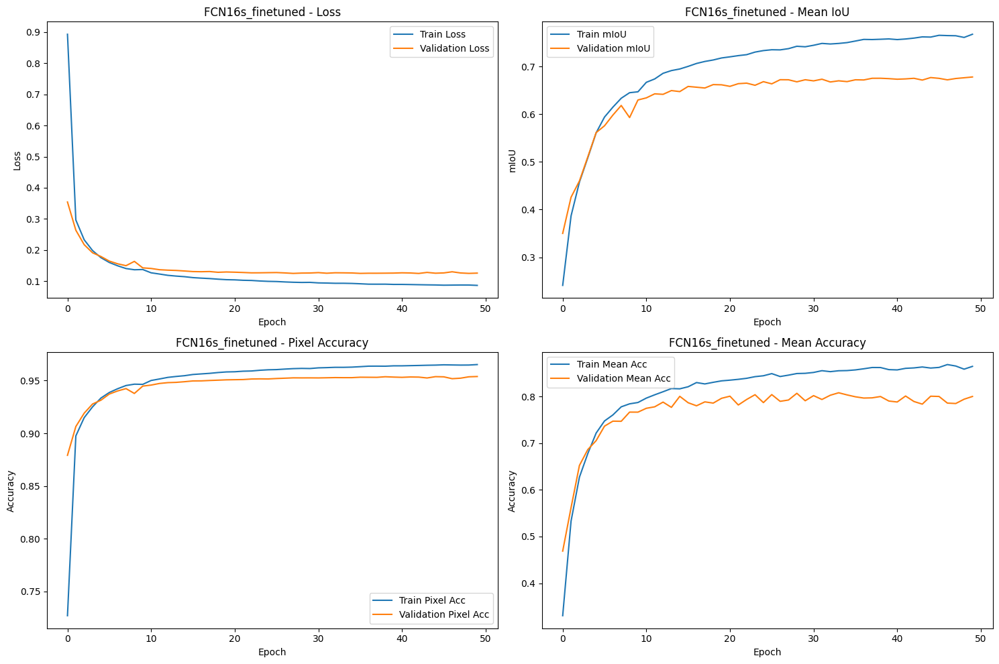

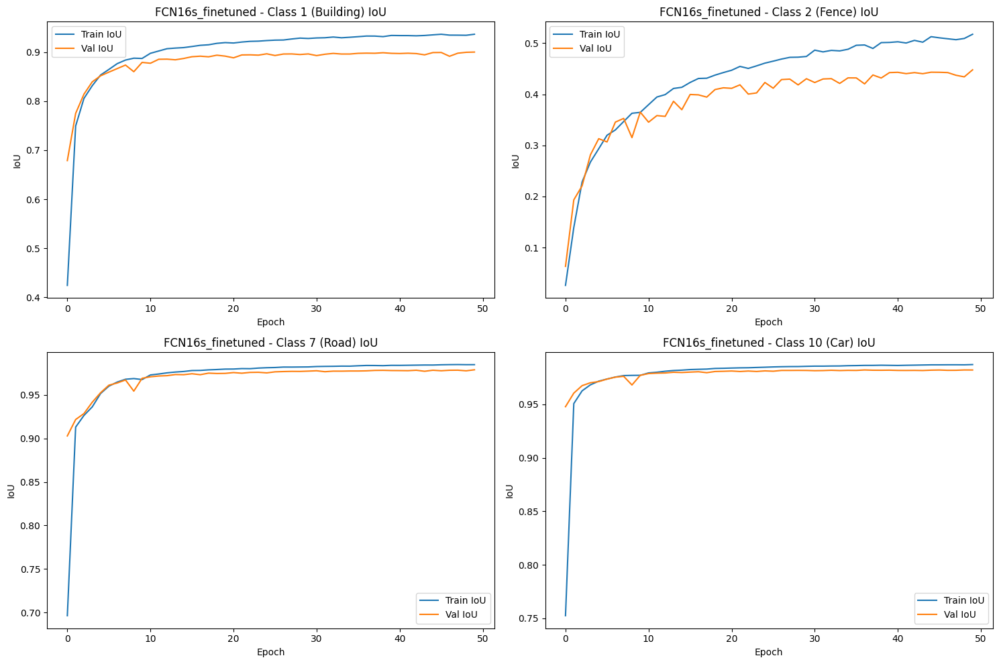

Evaluating FCN16s_finetuned on test set...


Evaluating: 100%|██████████| 32/32 [00:19<00:00,  1.61it/s]


Test Results:
Loss: 0.1307
Pixel Accuracy: 0.9533
Mean Accuracy: 0.7513
Mean IoU: 0.6416
Average Inference Time: 0.0021s per batch, 0.13ms per image

Per-class IoU:
Class 1 (Building): IoU=0.8530
Class 2 (Fence): IoU=0.3907
Class 3 (Other): IoU=0.5199
Class 4 (Pedestrian): IoU=0.0242
Class 5 (Pole): IoU=0.4190
Class 6 (Roadline): IoU=0.8139
Class 7 (Road): IoU=0.9781
Class 8 (Sidewalk): IoU=0.9084
Class 9 (Vegetation): IoU=0.8072
Class 10 (Car): IoU=0.9806
Class 11 (Wall): IoU=0.5855
Class 12 (Traffic sign): IoU=0.4184


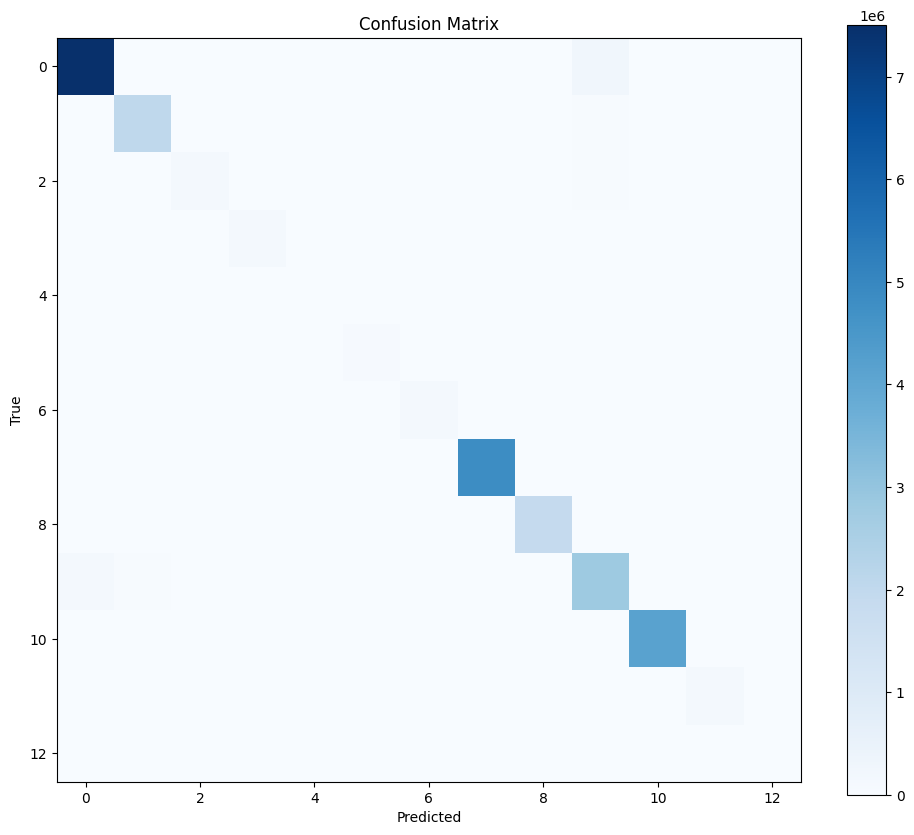

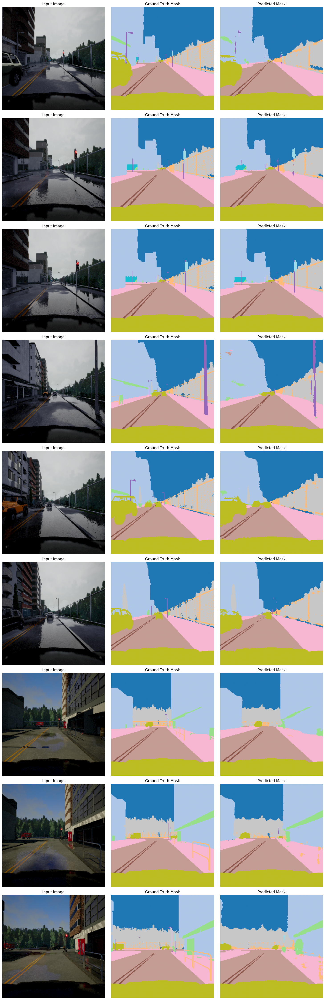


Training FCN8s_finetuned with 134,369,809 trainable parameters...
Training FCN8s_finetuned from scratch...


Epoch 1/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.27it/s, loss=0.307, iou=0.364, acc=0.902]


Saved best model with validation mIoU: 0.3660
Epoch 1/50 - Time: 44.29s - Train Loss: 0.7265 - Val Loss: 0.2977
Train - Pixel Acc: 0.7649, Mean Acc: 0.3641, mIoU: 0.2629
Val   - Pixel Acc: 0.9013, Mean Acc: 0.4980, mIoU: 0.3660
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.4426, Val IoU=0.7557
Class 2 (Fence): Train IoU=0.0172, Val IoU=0.0703
Class 7 (Road): Train IoU=0.7176, Val IoU=0.9019
Class 10 (Car): Train IoU=0.7913, Val IoU=0.9454


Epoch 2/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.228, iou=0.461, acc=0.924]


Saved best model with validation mIoU: 0.4663
Epoch 2/50 - Time: 42.02s - Train Loss: 0.2582 - Val Loss: 0.2233
Train - Pixel Acc: 0.9113, Mean Acc: 0.6009, mIoU: 0.4235
Val   - Pixel Acc: 0.9220, Mean Acc: 0.6621, mIoU: 0.4663
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7794, Val IoU=0.8133
Class 2 (Fence): Train IoU=0.1756, Val IoU=0.2041
Class 7 (Road): Train IoU=0.9190, Val IoU=0.9374
Class 10 (Car): Train IoU=0.9538, Val IoU=0.9644


Epoch 3/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.94it/s, loss=0.192, iou=0.524, acc=0.934]


Saved best model with validation mIoU: 0.5341
Epoch 3/50 - Time: 41.70s - Train Loss: 0.1990 - Val Loss: 0.1872
Train - Pixel Acc: 0.9294, Mean Acc: 0.6922, mIoU: 0.5184
Val   - Pixel Acc: 0.9333, Mean Acc: 0.7061, mIoU: 0.5341
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8319, Val IoU=0.8397
Class 2 (Fence): Train IoU=0.2632, Val IoU=0.2842
Class 7 (Road): Train IoU=0.9472, Val IoU=0.9565
Class 10 (Car): Train IoU=0.9678, Val IoU=0.9723


Epoch 4/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.163, iou=0.569, acc=0.942]


Saved best model with validation mIoU: 0.5828
Epoch 4/50 - Time: 41.54s - Train Loss: 0.1689 - Val Loss: 0.1635
Train - Pixel Acc: 0.9389, Mean Acc: 0.7357, mIoU: 0.5735
Val   - Pixel Acc: 0.9402, Mean Acc: 0.7177, mIoU: 0.5828
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8577, Val IoU=0.8620
Class 2 (Fence): Train IoU=0.3031, Val IoU=0.3067
Class 7 (Road): Train IoU=0.9602, Val IoU=0.9613
Class 10 (Car): Train IoU=0.9730, Val IoU=0.9744


Epoch 5/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.15, iou=0.578, acc=0.947]


Saved best model with validation mIoU: 0.5854
Epoch 5/50 - Time: 41.80s - Train Loss: 0.1502 - Val Loss: 0.1512
Train - Pixel Acc: 0.9446, Mean Acc: 0.7579, mIoU: 0.6052
Val   - Pixel Acc: 0.9447, Mean Acc: 0.7727, mIoU: 0.5854
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8740, Val IoU=0.8705
Class 2 (Fence): Train IoU=0.3319, Val IoU=0.3422
Class 7 (Road): Train IoU=0.9657, Val IoU=0.9668
Class 10 (Car): Train IoU=0.9765, Val IoU=0.9762


Epoch 6/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.141, iou=0.596, acc=0.95]


Saved best model with validation mIoU: 0.6119
Epoch 6/50 - Time: 41.80s - Train Loss: 0.1389 - Val Loss: 0.1416
Train - Pixel Acc: 0.9482, Mean Acc: 0.7708, mIoU: 0.6272
Val   - Pixel Acc: 0.9474, Mean Acc: 0.7708, mIoU: 0.6119
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8855, Val IoU=0.8783
Class 2 (Fence): Train IoU=0.3556, Val IoU=0.3436
Class 7 (Road): Train IoU=0.9692, Val IoU=0.9699
Class 10 (Car): Train IoU=0.9782, Val IoU=0.9784


Epoch 7/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.129, iou=0.619, acc=0.953]


Saved best model with validation mIoU: 0.6341
Epoch 7/50 - Time: 41.49s - Train Loss: 0.1292 - Val Loss: 0.1321
Train - Pixel Acc: 0.9513, Mean Acc: 0.7825, mIoU: 0.6464
Val   - Pixel Acc: 0.9505, Mean Acc: 0.7686, mIoU: 0.6341
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8918, Val IoU=0.8869
Class 2 (Fence): Train IoU=0.3820, Val IoU=0.3689
Class 7 (Road): Train IoU=0.9721, Val IoU=0.9721
Class 10 (Car): Train IoU=0.9801, Val IoU=0.9802


Epoch 8/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.14it/s, loss=0.125, iou=0.626, acc=0.954]


Saved best model with validation mIoU: 0.6412
Epoch 8/50 - Time: 41.95s - Train Loss: 0.1224 - Val Loss: 0.1309
Train - Pixel Acc: 0.9535, Mean Acc: 0.7919, mIoU: 0.6626
Val   - Pixel Acc: 0.9506, Mean Acc: 0.7756, mIoU: 0.6412
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9015, Val IoU=0.8896
Class 2 (Fence): Train IoU=0.4003, Val IoU=0.3980
Class 7 (Road): Train IoU=0.9737, Val IoU=0.9715
Class 10 (Car): Train IoU=0.9811, Val IoU=0.9798


Epoch 9/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.117, iou=0.637, acc=0.957]


Saved best model with validation mIoU: 0.6518
Epoch 9/50 - Time: 41.77s - Train Loss: 0.1162 - Val Loss: 0.1242
Train - Pixel Acc: 0.9555, Mean Acc: 0.7994, mIoU: 0.6747
Val   - Pixel Acc: 0.9530, Mean Acc: 0.7828, mIoU: 0.6518
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9058, Val IoU=0.8922
Class 2 (Fence): Train IoU=0.4156, Val IoU=0.4174
Class 7 (Road): Train IoU=0.9758, Val IoU=0.9748
Class 10 (Car): Train IoU=0.9822, Val IoU=0.9810


Epoch 10/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.80it/s, loss=0.116, iou=0.645, acc=0.957]


Saved best model with validation mIoU: 0.6588
Epoch 10/50 - Time: 41.84s - Train Loss: 0.1103 - Val Loss: 0.1218
Train - Pixel Acc: 0.9575, Mean Acc: 0.8076, mIoU: 0.6879
Val   - Pixel Acc: 0.9538, Mean Acc: 0.7775, mIoU: 0.6588
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9105, Val IoU=0.8957
Class 2 (Fence): Train IoU=0.4304, Val IoU=0.4279
Class 7 (Road): Train IoU=0.9776, Val IoU=0.9748
Class 10 (Car): Train IoU=0.9832, Val IoU=0.9820


Epoch 11/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.111, iou=0.65, acc=0.958]


Saved best model with validation mIoU: 0.6685
Epoch 11/50 - Time: 41.74s - Train Loss: 0.1075 - Val Loss: 0.1175
Train - Pixel Acc: 0.9584, Mean Acc: 0.8136, mIoU: 0.6947
Val   - Pixel Acc: 0.9550, Mean Acc: 0.7777, mIoU: 0.6685
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9142, Val IoU=0.9000
Class 2 (Fence): Train IoU=0.4381, Val IoU=0.4389
Class 7 (Road): Train IoU=0.9781, Val IoU=0.9768
Class 10 (Car): Train IoU=0.9837, Val IoU=0.9823


Epoch 12/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.114, iou=0.641, acc=0.957]


Epoch 12/50 - Time: 40.51s - Train Loss: 0.1047 - Val Loss: 0.1199
Train - Pixel Acc: 0.9593, Mean Acc: 0.8190, mIoU: 0.7031
Val   - Pixel Acc: 0.9544, Mean Acc: 0.7832, mIoU: 0.6622
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9158, Val IoU=0.8951
Class 2 (Fence): Train IoU=0.4501, Val IoU=0.4401
Class 7 (Road): Train IoU=0.9791, Val IoU=0.9758
Class 10 (Car): Train IoU=0.9842, Val IoU=0.9817


Epoch 13/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.83it/s, loss=0.108, iou=0.656, acc=0.959]


Saved best model with validation mIoU: 0.6732
Epoch 13/50 - Time: 41.87s - Train Loss: 0.1023 - Val Loss: 0.1141
Train - Pixel Acc: 0.9602, Mean Acc: 0.8205, mIoU: 0.7081
Val   - Pixel Acc: 0.9565, Mean Acc: 0.7990, mIoU: 0.6732
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9196, Val IoU=0.9023
Class 2 (Fence): Train IoU=0.4612, Val IoU=0.4380
Class 7 (Road): Train IoU=0.9798, Val IoU=0.9768
Class 10 (Car): Train IoU=0.9844, Val IoU=0.9822


Epoch 14/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.111, iou=0.658, acc=0.96]


Epoch 14/50 - Time: 40.75s - Train Loss: 0.0982 - Val Loss: 0.1154
Train - Pixel Acc: 0.9616, Mean Acc: 0.8306, mIoU: 0.7191
Val   - Pixel Acc: 0.9562, Mean Acc: 0.8045, mIoU: 0.6729
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9232, Val IoU=0.8991
Class 2 (Fence): Train IoU=0.4762, Val IoU=0.4597
Class 7 (Road): Train IoU=0.9809, Val IoU=0.9773
Class 10 (Car): Train IoU=0.9852, Val IoU=0.9822


Epoch 15/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.71it/s, loss=0.107, iou=0.662, acc=0.96]


Saved best model with validation mIoU: 0.6732
Epoch 15/50 - Time: 42.32s - Train Loss: 0.0964 - Val Loss: 0.1127
Train - Pixel Acc: 0.9622, Mean Acc: 0.8326, mIoU: 0.7232
Val   - Pixel Acc: 0.9570, Mean Acc: 0.8087, mIoU: 0.6732
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9250, Val IoU=0.9036
Class 2 (Fence): Train IoU=0.4811, Val IoU=0.4288
Class 7 (Road): Train IoU=0.9813, Val IoU=0.9786
Class 10 (Car): Train IoU=0.9856, Val IoU=0.9832


Epoch 16/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.93it/s, loss=0.102, iou=0.672, acc=0.962]


Saved best model with validation mIoU: 0.6810
Epoch 16/50 - Time: 41.81s - Train Loss: 0.0948 - Val Loss: 0.1115
Train - Pixel Acc: 0.9628, Mean Acc: 0.8318, mIoU: 0.7267
Val   - Pixel Acc: 0.9575, Mean Acc: 0.8014, mIoU: 0.6810
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9262, Val IoU=0.9023
Class 2 (Fence): Train IoU=0.4812, Val IoU=0.4591
Class 7 (Road): Train IoU=0.9818, Val IoU=0.9785
Class 10 (Car): Train IoU=0.9859, Val IoU=0.9836


Epoch 17/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.613, iou=0.231, acc=0.764]


Epoch 17/50 - Time: 40.45s - Train Loss: 0.9621 - Val Loss: 0.5736
Train - Pixel Acc: 0.7303, Mean Acc: 0.3867, mIoU: 0.2862
Val   - Pixel Acc: 0.7979, Mean Acc: 0.3337, mIoU: 0.2406
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.2931, Val IoU=0.1054
Class 2 (Fence): Train IoU=0.0859, Val IoU=0.0000
Class 7 (Road): Train IoU=0.7104, Val IoU=0.8431
Class 10 (Car): Train IoU=0.8205, Val IoU=0.9030


Epoch 18/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.498, iou=0.293, acc=0.833]


Epoch 18/50 - Time: 40.37s - Train Loss: 0.5102 - Val Loss: 0.4551
Train - Pixel Acc: 0.8274, Mean Acc: 0.3866, mIoU: 0.2784
Val   - Pixel Acc: 0.8466, Mean Acc: 0.4182, mIoU: 0.2985
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.4044, Val IoU=0.4765
Class 2 (Fence): Train IoU=0.0181, Val IoU=0.0215
Class 7 (Road): Train IoU=0.8516, Val IoU=0.8791
Class 10 (Car): Train IoU=0.8962, Val IoU=0.9167


Epoch 19/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.93it/s, loss=0.345, iou=0.352, acc=0.89]


Epoch 19/50 - Time: 40.16s - Train Loss: 0.3941 - Val Loss: 0.3327
Train - Pixel Acc: 0.8714, Mean Acc: 0.4410, mIoU: 0.3276
Val   - Pixel Acc: 0.8890, Mean Acc: 0.4699, mIoU: 0.3499
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.6430, Val IoU=0.7121
Class 2 (Fence): Train IoU=0.0408, Val IoU=0.0710
Class 7 (Road): Train IoU=0.8829, Val IoU=0.8983
Class 10 (Car): Train IoU=0.9112, Val IoU=0.9143


Epoch 20/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.96it/s, loss=0.295, iou=0.392, acc=0.903]


Epoch 20/50 - Time: 40.38s - Train Loss: 0.3149 - Val Loss: 0.2840
Train - Pixel Acc: 0.8947, Mean Acc: 0.5161, mIoU: 0.3698
Val   - Pixel Acc: 0.9025, Mean Acc: 0.5584, mIoU: 0.3942
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7354, Val IoU=0.7533
Class 2 (Fence): Train IoU=0.0909, Val IoU=0.1271
Class 7 (Road): Train IoU=0.9050, Val IoU=0.9134
Class 10 (Car): Train IoU=0.9334, Val IoU=0.9477


Epoch 21/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.83it/s, loss=0.272, iou=0.42, acc=0.912]


Epoch 21/50 - Time: 40.62s - Train Loss: 0.2759 - Val Loss: 0.2594
Train - Pixel Acc: 0.9058, Mean Acc: 0.5857, mIoU: 0.4061
Val   - Pixel Acc: 0.9109, Mean Acc: 0.5919, mIoU: 0.4278
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7641, Val IoU=0.7752
Class 2 (Fence): Train IoU=0.1527, Val IoU=0.1415
Class 7 (Road): Train IoU=0.9180, Val IoU=0.9244
Class 10 (Car): Train IoU=0.9470, Val IoU=0.9567


Epoch 22/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.01it/s, loss=0.245, iou=0.448, acc=0.919]


Epoch 22/50 - Time: 39.99s - Train Loss: 0.2465 - Val Loss: 0.2368
Train - Pixel Acc: 0.9148, Mean Acc: 0.6341, mIoU: 0.4457
Val   - Pixel Acc: 0.9180, Mean Acc: 0.6410, mIoU: 0.4572
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.7871, Val IoU=0.7954
Class 2 (Fence): Train IoU=0.1936, Val IoU=0.2190
Class 7 (Road): Train IoU=0.9307, Val IoU=0.9359
Class 10 (Car): Train IoU=0.9566, Val IoU=0.9594


Epoch 23/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.227, iou=0.48, acc=0.923]


Epoch 23/50 - Time: 40.12s - Train Loss: 0.2268 - Val Loss: 0.2245
Train - Pixel Acc: 0.9208, Mean Acc: 0.6629, mIoU: 0.4763
Val   - Pixel Acc: 0.9219, Mean Acc: 0.6352, mIoU: 0.4930
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8009, Val IoU=0.8028
Class 2 (Fence): Train IoU=0.2206, Val IoU=0.2333
Class 7 (Road): Train IoU=0.9399, Val IoU=0.9440
Class 10 (Car): Train IoU=0.9608, Val IoU=0.9602


Epoch 24/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.97it/s, loss=0.211, iou=0.486, acc=0.928]


Epoch 24/50 - Time: 40.45s - Train Loss: 0.2096 - Val Loss: 0.2090
Train - Pixel Acc: 0.9259, Mean Acc: 0.6895, mIoU: 0.5039
Val   - Pixel Acc: 0.9265, Mean Acc: 0.6744, mIoU: 0.4991
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8144, Val IoU=0.8137
Class 2 (Fence): Train IoU=0.2481, Val IoU=0.2408
Class 7 (Road): Train IoU=0.9476, Val IoU=0.9502
Class 10 (Car): Train IoU=0.9650, Val IoU=0.9677


Epoch 25/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.99it/s, loss=0.2, iou=0.499, acc=0.93]


Epoch 25/50 - Time: 40.31s - Train Loss: 0.1989 - Val Loss: 0.1966
Train - Pixel Acc: 0.9290, Mean Acc: 0.7016, mIoU: 0.5229
Val   - Pixel Acc: 0.9299, Mean Acc: 0.6827, mIoU: 0.5164
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8240, Val IoU=0.8287
Class 2 (Fence): Train IoU=0.2571, Val IoU=0.2728
Class 7 (Road): Train IoU=0.9515, Val IoU=0.9529
Class 10 (Car): Train IoU=0.9673, Val IoU=0.9686


Epoch 26/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.09it/s, loss=0.189, iou=0.525, acc=0.934]


Epoch 26/50 - Time: 40.16s - Train Loss: 0.1849 - Val Loss: 0.1881
Train - Pixel Acc: 0.9333, Mean Acc: 0.7154, mIoU: 0.5460
Val   - Pixel Acc: 0.9325, Mean Acc: 0.6958, mIoU: 0.5346
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8399, Val IoU=0.8329
Class 2 (Fence): Train IoU=0.2855, Val IoU=0.2748
Class 7 (Road): Train IoU=0.9560, Val IoU=0.9552
Class 10 (Car): Train IoU=0.9701, Val IoU=0.9705


Epoch 27/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.93it/s, loss=0.181, iou=0.536, acc=0.937]


Epoch 27/50 - Time: 40.63s - Train Loss: 0.1768 - Val Loss: 0.1800
Train - Pixel Acc: 0.9356, Mean Acc: 0.7278, mIoU: 0.5588
Val   - Pixel Acc: 0.9349, Mean Acc: 0.7119, mIoU: 0.5480
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8473, Val IoU=0.8413
Class 2 (Fence): Train IoU=0.2935, Val IoU=0.2949
Class 7 (Road): Train IoU=0.9587, Val IoU=0.9568
Class 10 (Car): Train IoU=0.9716, Val IoU=0.9715


Epoch 28/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.93it/s, loss=0.173, iou=0.556, acc=0.939]


Epoch 28/50 - Time: 40.28s - Train Loss: 0.1684 - Val Loss: 0.1750
Train - Pixel Acc: 0.9382, Mean Acc: 0.7355, mIoU: 0.5736
Val   - Pixel Acc: 0.9361, Mean Acc: 0.7096, mIoU: 0.5626
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8557, Val IoU=0.8466
Class 2 (Fence): Train IoU=0.3045, Val IoU=0.3025
Class 7 (Road): Train IoU=0.9613, Val IoU=0.9601
Class 10 (Car): Train IoU=0.9734, Val IoU=0.9712


Epoch 29/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.15it/s, loss=0.165, iou=0.558, acc=0.94]


Epoch 29/50 - Time: 40.20s - Train Loss: 0.1621 - Val Loss: 0.1701
Train - Pixel Acc: 0.9400, Mean Acc: 0.7418, mIoU: 0.5835
Val   - Pixel Acc: 0.9376, Mean Acc: 0.7240, mIoU: 0.5624
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8608, Val IoU=0.8494
Class 2 (Fence): Train IoU=0.3142, Val IoU=0.3046
Class 7 (Road): Train IoU=0.9632, Val IoU=0.9627
Class 10 (Car): Train IoU=0.9743, Val IoU=0.9741


Epoch 30/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.08it/s, loss=0.161, iou=0.569, acc=0.941]


Epoch 30/50 - Time: 40.31s - Train Loss: 0.1597 - Val Loss: 0.1660
Train - Pixel Acc: 0.9406, Mean Acc: 0.7473, mIoU: 0.5902
Val   - Pixel Acc: 0.9388, Mean Acc: 0.7319, mIoU: 0.5731
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8613, Val IoU=0.8524
Class 2 (Fence): Train IoU=0.3153, Val IoU=0.3152
Class 7 (Road): Train IoU=0.9640, Val IoU=0.9615
Class 10 (Car): Train IoU=0.9748, Val IoU=0.9723


Epoch 31/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.162, iou=0.561, acc=0.942]


Epoch 31/50 - Time: 40.15s - Train Loss: 0.1526 - Val Loss: 0.1658
Train - Pixel Acc: 0.9429, Mean Acc: 0.7560, mIoU: 0.6023
Val   - Pixel Acc: 0.9395, Mean Acc: 0.7346, mIoU: 0.5714
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8696, Val IoU=0.8538
Class 2 (Fence): Train IoU=0.3305, Val IoU=0.3064
Class 7 (Road): Train IoU=0.9659, Val IoU=0.9640
Class 10 (Car): Train IoU=0.9761, Val IoU=0.9739


Epoch 32/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.02it/s, loss=0.156, iou=0.585, acc=0.944]


Epoch 32/50 - Time: 40.19s - Train Loss: 0.1490 - Val Loss: 0.1596
Train - Pixel Acc: 0.9440, Mean Acc: 0.7585, mIoU: 0.6091
Val   - Pixel Acc: 0.9411, Mean Acc: 0.7235, mIoU: 0.5923
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8725, Val IoU=0.8615
Class 2 (Fence): Train IoU=0.3347, Val IoU=0.3125
Class 7 (Road): Train IoU=0.9671, Val IoU=0.9652
Class 10 (Car): Train IoU=0.9767, Val IoU=0.9743


Epoch 33/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.90it/s, loss=0.156, iou=0.582, acc=0.945]


Epoch 33/50 - Time: 40.67s - Train Loss: 0.1444 - Val Loss: 0.1561
Train - Pixel Acc: 0.9454, Mean Acc: 0.7661, mIoU: 0.6187
Val   - Pixel Acc: 0.9424, Mean Acc: 0.7373, mIoU: 0.5886
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8780, Val IoU=0.8645
Class 2 (Fence): Train IoU=0.3393, Val IoU=0.3408
Class 7 (Road): Train IoU=0.9687, Val IoU=0.9660
Class 10 (Car): Train IoU=0.9775, Val IoU=0.9746


Epoch 34/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.147, iou=0.592, acc=0.946]


Epoch 34/50 - Time: 40.29s - Train Loss: 0.1407 - Val Loss: 0.1558
Train - Pixel Acc: 0.9466, Mean Acc: 0.7696, mIoU: 0.6243
Val   - Pixel Acc: 0.9424, Mean Acc: 0.7482, mIoU: 0.5925
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8810, Val IoU=0.8615
Class 2 (Fence): Train IoU=0.3522, Val IoU=0.3441
Class 7 (Road): Train IoU=0.9697, Val IoU=0.9675
Class 10 (Car): Train IoU=0.9783, Val IoU=0.9747


Epoch 35/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.03it/s, loss=0.148, iou=0.59, acc=0.946]


Epoch 35/50 - Time: 40.26s - Train Loss: 0.1381 - Val Loss: 0.1526
Train - Pixel Acc: 0.9475, Mean Acc: 0.7726, mIoU: 0.6305
Val   - Pixel Acc: 0.9435, Mean Acc: 0.7448, mIoU: 0.6029
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8825, Val IoU=0.8646
Class 2 (Fence): Train IoU=0.3541, Val IoU=0.3410
Class 7 (Road): Train IoU=0.9704, Val IoU=0.9674
Class 10 (Car): Train IoU=0.9785, Val IoU=0.9753


Epoch 36/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.07it/s, loss=0.144, iou=0.591, acc=0.947]


Epoch 36/50 - Time: 40.50s - Train Loss: 0.1354 - Val Loss: 0.1507
Train - Pixel Acc: 0.9483, Mean Acc: 0.7756, mIoU: 0.6358
Val   - Pixel Acc: 0.9443, Mean Acc: 0.7593, mIoU: 0.6008
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8846, Val IoU=0.8689
Class 2 (Fence): Train IoU=0.3559, Val IoU=0.3285
Class 7 (Road): Train IoU=0.9713, Val IoU=0.9684
Class 10 (Car): Train IoU=0.9790, Val IoU=0.9751


Epoch 37/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.98it/s, loss=0.147, iou=0.597, acc=0.948]


Epoch 37/50 - Time: 40.48s - Train Loss: 0.1325 - Val Loss: 0.1492
Train - Pixel Acc: 0.9493, Mean Acc: 0.7787, mIoU: 0.6402
Val   - Pixel Acc: 0.9448, Mean Acc: 0.7470, mIoU: 0.6079
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8878, Val IoU=0.8700
Class 2 (Fence): Train IoU=0.3671, Val IoU=0.3350
Class 7 (Road): Train IoU=0.9721, Val IoU=0.9687
Class 10 (Car): Train IoU=0.9795, Val IoU=0.9764


Epoch 38/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.16it/s, loss=0.14, iou=0.613, acc=0.948]


Epoch 38/50 - Time: 40.08s - Train Loss: 0.1311 - Val Loss: 0.1487
Train - Pixel Acc: 0.9497, Mean Acc: 0.7812, mIoU: 0.6435
Val   - Pixel Acc: 0.9445, Mean Acc: 0.7466, mIoU: 0.6106
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8876, Val IoU=0.8673
Class 2 (Fence): Train IoU=0.3720, Val IoU=0.3536
Class 7 (Road): Train IoU=0.9725, Val IoU=0.9691
Class 10 (Car): Train IoU=0.9798, Val IoU=0.9757


Epoch 39/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.93it/s, loss=0.145, iou=0.588, acc=0.947]


Epoch 39/50 - Time: 40.36s - Train Loss: 0.1284 - Val Loss: 0.1468
Train - Pixel Acc: 0.9506, Mean Acc: 0.7835, mIoU: 0.6487
Val   - Pixel Acc: 0.9454, Mean Acc: 0.7691, mIoU: 0.6012
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8899, Val IoU=0.8701
Class 2 (Fence): Train IoU=0.3742, Val IoU=0.3546
Class 7 (Road): Train IoU=0.9736, Val IoU=0.9699
Class 10 (Car): Train IoU=0.9801, Val IoU=0.9765


Epoch 40/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.82it/s, loss=0.141, iou=0.608, acc=0.949]


Epoch 40/50 - Time: 40.36s - Train Loss: 0.1272 - Val Loss: 0.1451
Train - Pixel Acc: 0.9510, Mean Acc: 0.7870, mIoU: 0.6511
Val   - Pixel Acc: 0.9459, Mean Acc: 0.7499, mIoU: 0.6179
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8919, Val IoU=0.8725
Class 2 (Fence): Train IoU=0.3787, Val IoU=0.3654
Class 7 (Road): Train IoU=0.9737, Val IoU=0.9702
Class 10 (Car): Train IoU=0.9804, Val IoU=0.9763


Epoch 41/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.11it/s, loss=0.143, iou=0.598, acc=0.948]


Epoch 41/50 - Time: 40.01s - Train Loss: 0.1249 - Val Loss: 0.1454
Train - Pixel Acc: 0.9518, Mean Acc: 0.7896, mIoU: 0.6583
Val   - Pixel Acc: 0.9459, Mean Acc: 0.7490, mIoU: 0.6144
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8955, Val IoU=0.8694
Class 2 (Fence): Train IoU=0.3838, Val IoU=0.3598
Class 7 (Road): Train IoU=0.9745, Val IoU=0.9706
Class 10 (Car): Train IoU=0.9809, Val IoU=0.9770


Epoch 42/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.134, iou=0.615, acc=0.951]


Epoch 42/50 - Time: 40.43s - Train Loss: 0.1240 - Val Loss: 0.1426
Train - Pixel Acc: 0.9521, Mean Acc: 0.7905, mIoU: 0.6605
Val   - Pixel Acc: 0.9470, Mean Acc: 0.7537, mIoU: 0.6216
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8960, Val IoU=0.8741
Class 2 (Fence): Train IoU=0.3859, Val IoU=0.3595
Class 7 (Road): Train IoU=0.9748, Val IoU=0.9715
Class 10 (Car): Train IoU=0.9809, Val IoU=0.9776


Epoch 43/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.138, iou=0.619, acc=0.949]


Epoch 43/50 - Time: 40.45s - Train Loss: 0.1216 - Val Loss: 0.1432
Train - Pixel Acc: 0.9529, Mean Acc: 0.7947, mIoU: 0.6646
Val   - Pixel Acc: 0.9467, Mean Acc: 0.7597, mIoU: 0.6228
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8988, Val IoU=0.8727
Class 2 (Fence): Train IoU=0.3931, Val IoU=0.3682
Class 7 (Road): Train IoU=0.9755, Val IoU=0.9712
Class 10 (Car): Train IoU=0.9813, Val IoU=0.9777


Epoch 44/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.10it/s, loss=0.14, iou=0.611, acc=0.949]


Epoch 44/50 - Time: 40.19s - Train Loss: 0.1201 - Val Loss: 0.1417
Train - Pixel Acc: 0.9534, Mean Acc: 0.7998, mIoU: 0.6690
Val   - Pixel Acc: 0.9471, Mean Acc: 0.7561, mIoU: 0.6229
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8992, Val IoU=0.8750
Class 2 (Fence): Train IoU=0.3951, Val IoU=0.3678
Class 7 (Road): Train IoU=0.9760, Val IoU=0.9712
Class 10 (Car): Train IoU=0.9816, Val IoU=0.9778


Epoch 45/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.04it/s, loss=0.138, iou=0.609, acc=0.95]


Epoch 45/50 - Time: 40.31s - Train Loss: 0.1198 - Val Loss: 0.1412
Train - Pixel Acc: 0.9535, Mean Acc: 0.7978, mIoU: 0.6688
Val   - Pixel Acc: 0.9475, Mean Acc: 0.7660, mIoU: 0.6230
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8996, Val IoU=0.8745
Class 2 (Fence): Train IoU=0.3973, Val IoU=0.3665
Class 7 (Road): Train IoU=0.9760, Val IoU=0.9715
Class 10 (Car): Train IoU=0.9816, Val IoU=0.9772


Epoch 46/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.81it/s, loss=0.137, iou=0.621, acc=0.95]


Epoch 46/50 - Time: 40.34s - Train Loss: 0.1196 - Val Loss: 0.1396
Train - Pixel Acc: 0.9535, Mean Acc: 0.8002, mIoU: 0.6712
Val   - Pixel Acc: 0.9481, Mean Acc: 0.7558, mIoU: 0.6293
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.8987, Val IoU=0.8770
Class 2 (Fence): Train IoU=0.3944, Val IoU=0.3860
Class 7 (Road): Train IoU=0.9763, Val IoU=0.9723
Class 10 (Car): Train IoU=0.9816, Val IoU=0.9784


Epoch 47/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.95it/s, loss=0.137, iou=0.609, acc=0.951]


Epoch 47/50 - Time: 40.17s - Train Loss: 0.1171 - Val Loss: 0.1405
Train - Pixel Acc: 0.9544, Mean Acc: 0.8021, mIoU: 0.6761
Val   - Pixel Acc: 0.9482, Mean Acc: 0.7646, mIoU: 0.6220
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9013, Val IoU=0.8767
Class 2 (Fence): Train IoU=0.4038, Val IoU=0.3795
Class 7 (Road): Train IoU=0.9769, Val IoU=0.9726
Class 10 (Car): Train IoU=0.9819, Val IoU=0.9777


Epoch 48/50 [Val]: 100%|██████████| 25/25 [00:04<00:00,  5.06it/s, loss=0.143, iou=0.624, acc=0.951]


Epoch 48/50 - Time: 40.43s - Train Loss: 0.1156 - Val Loss: 0.1395
Train - Pixel Acc: 0.9550, Mean Acc: 0.8075, mIoU: 0.6814
Val   - Pixel Acc: 0.9484, Mean Acc: 0.7583, mIoU: 0.6324
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9050, Val IoU=0.8788
Class 2 (Fence): Train IoU=0.4053, Val IoU=0.3896
Class 7 (Road): Train IoU=0.9773, Val IoU=0.9724
Class 10 (Car): Train IoU=0.9822, Val IoU=0.9784


Epoch 49/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.87it/s, loss=0.138, iou=0.615, acc=0.95]


Epoch 49/50 - Time: 40.37s - Train Loss: 0.1141 - Val Loss: 0.1382
Train - Pixel Acc: 0.9555, Mean Acc: 0.8079, mIoU: 0.6808
Val   - Pixel Acc: 0.9482, Mean Acc: 0.7673, mIoU: 0.6245
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9049, Val IoU=0.8790
Class 2 (Fence): Train IoU=0.4096, Val IoU=0.3448
Class 7 (Road): Train IoU=0.9778, Val IoU=0.9723
Class 10 (Car): Train IoU=0.9825, Val IoU=0.9788


Epoch 50/50 [Val]: 100%|██████████| 25/25 [00:05<00:00,  4.95it/s, loss=0.138, iou=0.622, acc=0.951]


Epoch 50/50 - Time: 41.69s - Train Loss: 0.1135 - Val Loss: 0.1385
Train - Pixel Acc: 0.9557, Mean Acc: 0.8102, mIoU: 0.6844
Val   - Pixel Acc: 0.9486, Mean Acc: 0.7662, mIoU: 0.6325
Per-class IoU for selected classes:
Class 1 (Building): Train IoU=0.9054, Val IoU=0.8771
Class 2 (Fence): Train IoU=0.4059, Val IoU=0.3664
Class 7 (Road): Train IoU=0.9780, Val IoU=0.9732
Class 10 (Car): Train IoU=0.9825, Val IoU=0.9784
Training complete. Average time per epoch: 40.83s. Total training time: 2041.34s


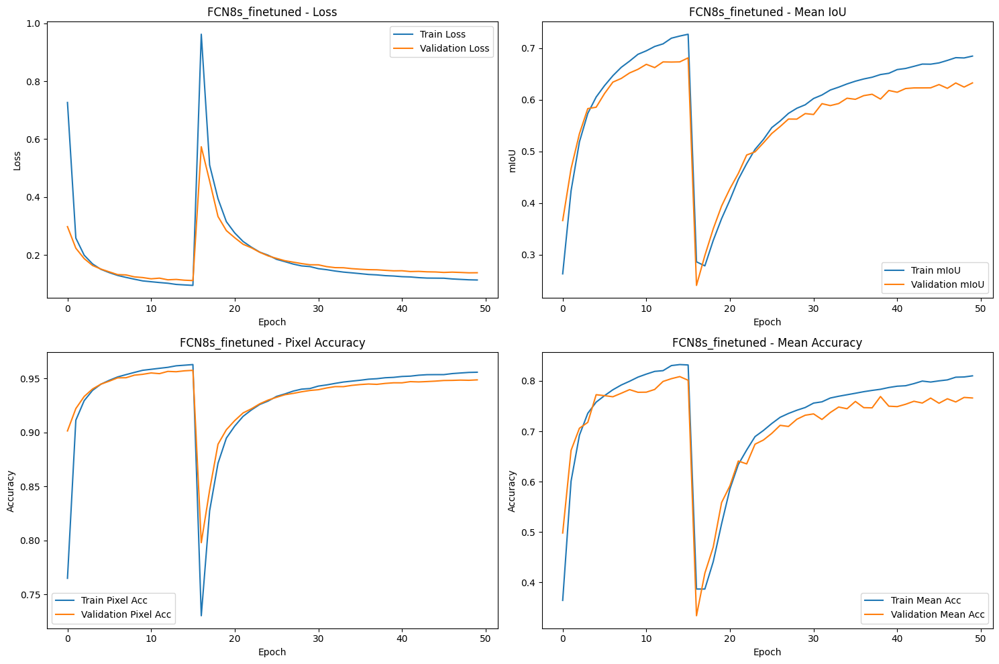

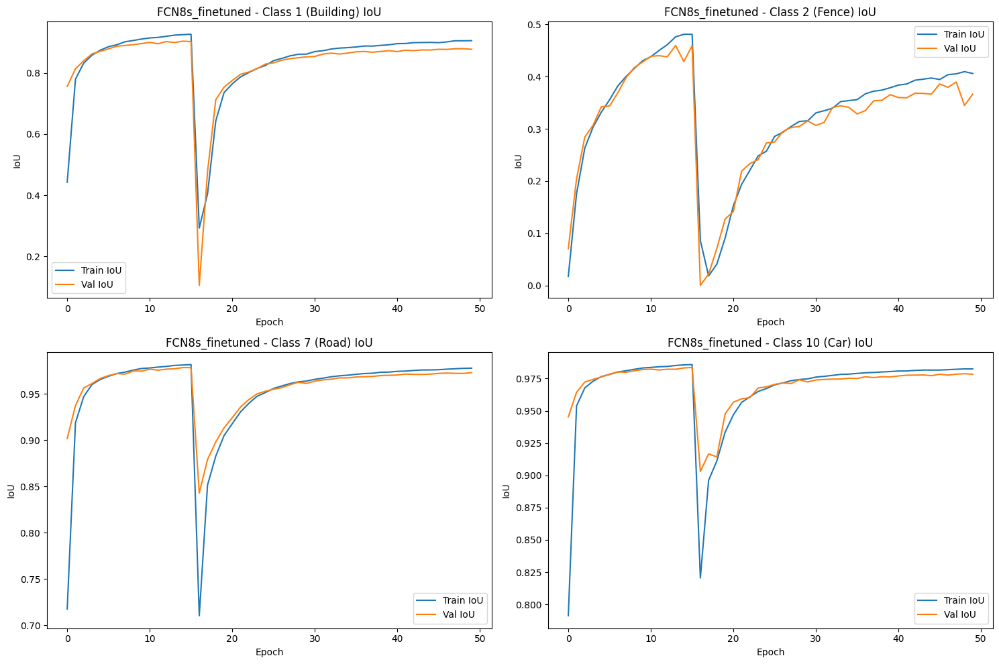

Evaluating FCN8s_finetuned on test set...


Evaluating: 100%|██████████| 32/32 [00:20<00:00,  1.57it/s]


Test Results:
Loss: 0.1432
Pixel Accuracy: 0.9483
Mean Accuracy: 0.7230
Mean IoU: 0.5985
Average Inference Time: 0.0026s per batch, 0.16ms per image

Per-class IoU:
Class 1 (Building): IoU=0.8248
Class 2 (Fence): IoU=0.3197
Class 3 (Other): IoU=0.4413
Class 4 (Pedestrian): IoU=0.0071
Class 5 (Pole): IoU=0.3322
Class 6 (Roadline): IoU=0.7692
Class 7 (Road): IoU=0.9722
Class 8 (Sidewalk): IoU=0.8874
Class 9 (Vegetation): IoU=0.7995
Class 10 (Car): IoU=0.9760
Class 11 (Wall): IoU=0.5145
Class 12 (Traffic sign): IoU=0.3384


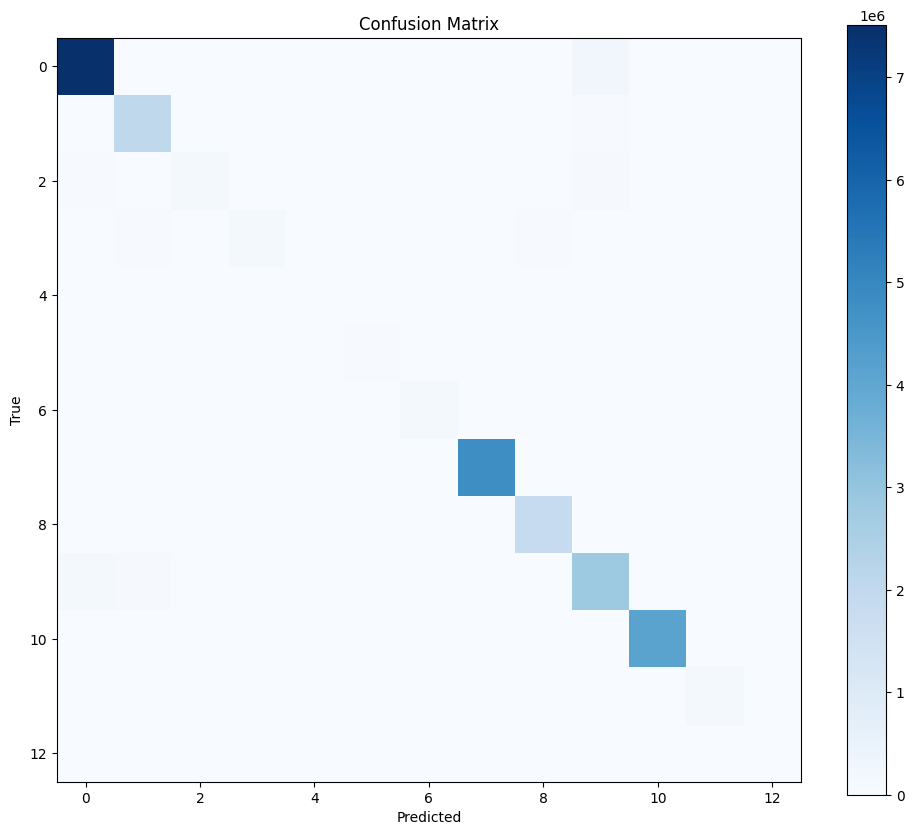

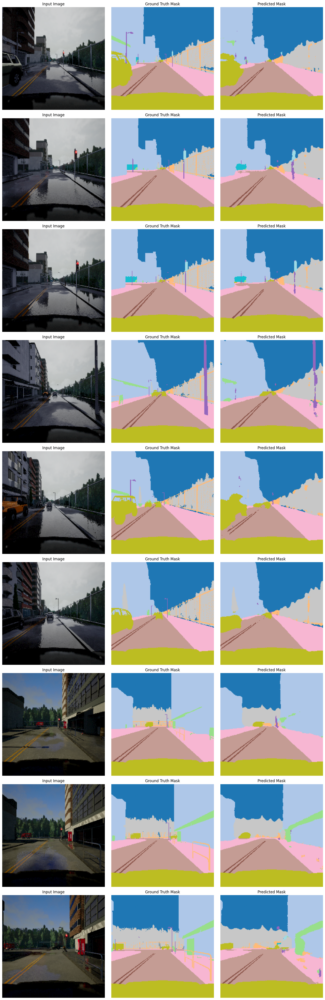


Results Summary:
Model                Test Loss  mIoU       Pixel Acc  Mean Acc   Inference 
----------------------------------------------------------------------------------------------------
FCN32s_frozen        0.2138     0.5111     0.9218     0.6610     0.20ms    
FCN16s_frozen        0.1969     0.5173     0.9259     0.6580     0.13ms    
FCN8s_frozen         0.1623     0.5621     0.9386     0.6808     0.15ms    
FCN32s_finetuned     0.1897     0.5392     0.9300     0.6740     0.13ms    
FCN16s_finetuned     0.1307     0.6416     0.9533     0.7513     0.13ms    
FCN8s_finetuned      0.1432     0.5985     0.9483     0.7230     0.16ms    
Successfully completed training and evaluation


In [ ]:

# Run with error handling
try:
    print("Starting FCN training and evaluation")
    results = train_and_evaluate_models()
    print("Successfully completed training and evaluation")
except Exception as e:
    import traceback
    print(f"Error occurred: {e}")
    print(traceback.format_exc())




Using MPS device


/var/folders/9s/y0c_yj6d7c1fm05rdc4dnn7c0000gn/T/ipykernel_92483/3440561392.py:394: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path

Successfully loaded FCN32s_frozen
Successfully loaded FCN16s_frozen
Successfully loaded FCN8s_frozen
Successfully loaded FCN32s_finetuned
Successfully loaded FCN16s_finetuned
Successfully loaded FCN8s_finetuned
Comparing 6 models


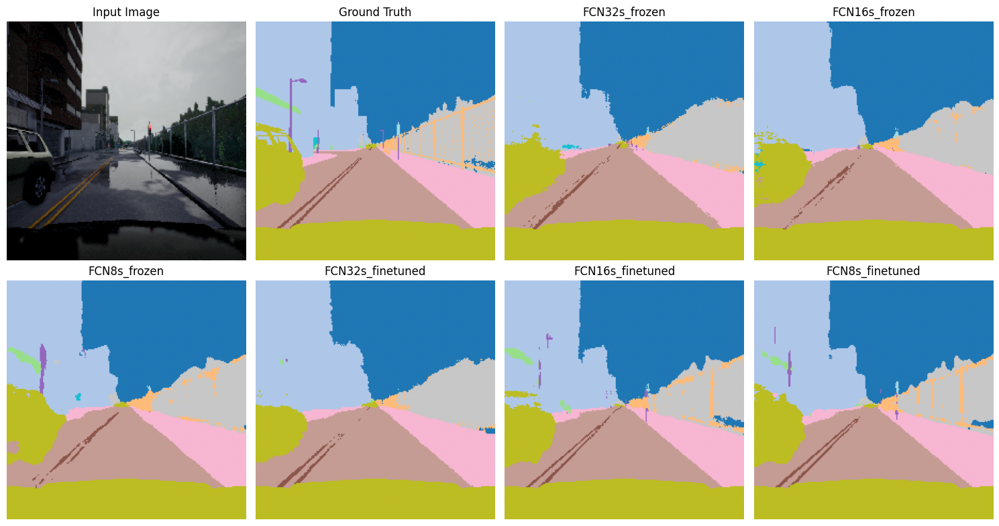

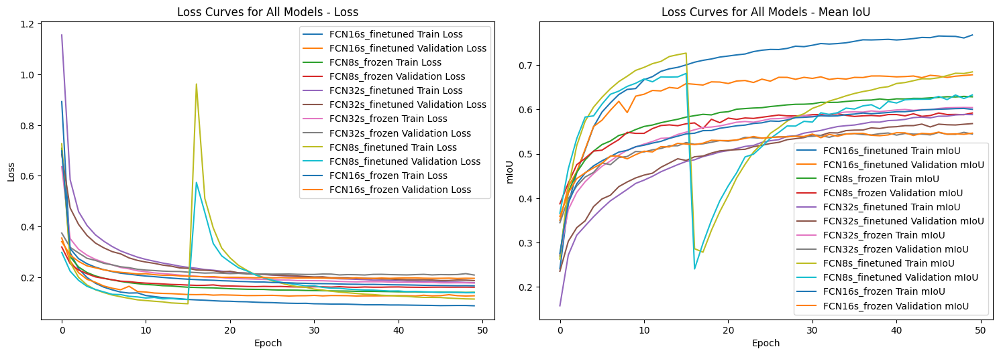

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image

# Define constants
NUM_CLASSES = 13
IMAGE_SIZE = 224
BATCH_SIZE = 16

# Define device
if torch.cuda.is_available():
    DEVICE = torch.device("cuda")
    print(f"Using CUDA device: {torch.cuda.get_device_name(0)}")
elif torch.backends.mps.is_available():
    DEVICE = torch.device("mps")
    print(f"Using MPS device")
else:
    DEVICE = torch.device("cpu")
    print(f"Using CPU")

# Define class names
class_names = [
    "Unlabeled", "Building", "Fence", "Other", "Pedestrian", "Pole",
    "Roadline", "Road", "Sidewalk", "Vegetation", "Car", "Wall", "Traffic sign"
]

# Create a custom dataset class
class SegmentationDataset(Dataset):
    def __init__(self, images_dir, masks_dir, transform=None):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.transform = transform
        self.images = sorted(os.listdir(images_dir))
        
    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        img_name = self.images[idx]
        image_path = os.path.join(self.images_dir, img_name)
        mask_path = os.path.join(self.masks_dir, img_name)
        
        image = Image.open(image_path).convert("RGB")
        mask = Image.open(mask_path)
        
        # Extract the first channel if the mask has multiple channels
        mask_np = np.array(mask)
        if len(mask_np.shape) > 2:
            mask_np = mask_np[:, :, 0]
        
        mask = Image.fromarray(mask_np)
        
        if self.transform:
            image = self.transform(image)
            # Convert mask to tensor manually
            mask = torch.from_numpy(np.array(mask)).long()
        
        return image, mask

# Define transformations
test_transform = transforms.Compose([
    transforms.Resize((IMAGE_SIZE, IMAGE_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Model definitions
class FCN32s(nn.Module):
    def __init__(self, num_classes=NUM_CLASSES):
        super().__init__()
        # We only need the forward pass for prediction
        from torchvision.models import vgg16
        vgg_model = vgg16(weights=None)
        
        # Extract feature layers from VGG16
        self.features = vgg_model.features
        
        # FCN-32s specific layers
        self.classifier = nn.Sequential(
            nn.Conv2d(512, 4096, kernel_size=7, padding=3),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, 4096, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, num_classes, kernel_size=1)
        )
        
        # Upsampling (32x)
        self.upsampling = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=64, stride=32, padding=16)
    
    def forward(self, x):
        # Original input size
        input_size = x.size()[2:]
        
        # Get features
        features = self.features(x)
        
        # Apply classifier
        out = self.classifier(features)
        
        # Upsample to original size
        out = self.upsampling(out)
        
        # Crop to match input size exactly
        import torch.nn.functional as F
        out = F.interpolate(out, size=input_size, mode='bilinear', align_corners=False)
        
        return out

class FCN16s(nn.Module):
    def __init__(self, num_classes=NUM_CLASSES):
        super().__init__()
        from torchvision.models import vgg16
        vgg_model = vgg16(weights=None)
        
        # Extract feature layers from VGG16 and separate pool4
        self.features_low = nn.Sequential(*list(vgg_model.features.children())[:24])  # Before pool4
        self.features_high = nn.Sequential(*list(vgg_model.features.children())[24:])  # After pool4
        
        # FCN-16s specific layers
        self.classifier = nn.Sequential(
            nn.Conv2d(512, 4096, kernel_size=7, padding=3),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, 4096, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, num_classes, kernel_size=1)
        )
        
        # Score pool4
        self.score_pool4 = nn.Conv2d(512, num_classes, kernel_size=1)
        
        # Upsampling (2x)
        self.upsample_2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
        
        # Upsampling (16x)
        self.upsample_16x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=32, stride=16, padding=8)
    
    def forward(self, x):
        # Original input size
        input_size = x.size()[2:]
        
        # Get features from lower part (before pool4)
        pool4_features = self.features_low(x)
        
        # Get features from higher part (after pool4)
        conv5_features = self.features_high(pool4_features)
        
        # Score from conv5
        score_conv5 = self.classifier(conv5_features)
        
        # Upsample conv5 score
        score_conv5_up = self.upsample_2x(score_conv5)
        
        # Score from pool4
        score_pool4 = self.score_pool4(pool4_features)
        
        # Crop score_pool4 to match score_conv5_up dimensions
        score_pool4_crop = score_pool4[:, :, :score_conv5_up.size()[2], :score_conv5_up.size()[3]]
        
        # Fuse scores
        fused_scores = score_conv5_up + score_pool4_crop
        
        # Upsample fused scores to original size
        out = self.upsample_16x(fused_scores)
        
        # Crop to match input size exactly
        import torch.nn.functional as F
        out = F.interpolate(out, size=input_size, mode='bilinear', align_corners=False)
        
        return out

class FCN8s(nn.Module):
    def __init__(self, num_classes=NUM_CLASSES):
        super().__init__()
        from torchvision.models import vgg16
        vgg_model = vgg16(weights=None)
        
        # Extract feature layers from VGG16 and separate pool3, pool4
        self.features_pool3 = nn.Sequential(*list(vgg_model.features.children())[:17])  # Before pool3
        self.features_pool4 = nn.Sequential(*list(vgg_model.features.children())[17:24])  # Between pool3 and pool4
        self.features_pool5 = nn.Sequential(*list(vgg_model.features.children())[24:])  # After pool4
        
        # FCN-8s specific layers
        self.classifier = nn.Sequential(
            nn.Conv2d(512, 4096, kernel_size=7, padding=3),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, 4096, kernel_size=1),
            nn.ReLU(inplace=True),
            nn.Dropout2d(),
            nn.Conv2d(4096, num_classes, kernel_size=1)
        )
        
        # Score layers for pool3 and pool4
        self.score_pool4 = nn.Conv2d(512, num_classes, kernel_size=1)
        self.score_pool3 = nn.Conv2d(256, num_classes, kernel_size=1)
        
        # Upsampling layers
        self.upsample_2x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=4, stride=2, padding=1)
        self.upsample_8x = nn.ConvTranspose2d(num_classes, num_classes, kernel_size=16, stride=8, padding=4)
    
    def forward(self, x):
        # Original input size
        input_size = x.size()[2:]
        
        # Get features from different pools
        pool3_features = self.features_pool3(x)
        pool4_features = self.features_pool4(pool3_features)
        conv5_features = self.features_pool5(pool4_features)
        
        # Score from conv5
        score_conv5 = self.classifier(conv5_features)
        
        # Upsample conv5 score (2x)
        score_conv5_up = self.upsample_2x(score_conv5)
        
        # Score from pool4
        score_pool4 = self.score_pool4(pool4_features)
        
        # Crop score_pool4 to match score_conv5_up dimensions
        score_pool4_crop = score_pool4[:, :, :score_conv5_up.size()[2], :score_conv5_up.size()[3]]
        
        # Fuse scores from conv5 and pool4
        fused_score_4 = score_conv5_up + score_pool4_crop
        
        # Upsample fused score (2x)
        fused_score_4_up = self.upsample_2x(fused_score_4)
        
        # Score from pool3
        score_pool3 = self.score_pool3(pool3_features)
        
        # Crop score_pool3 to match fused_score_4_up dimensions
        score_pool3_crop = score_pool3[:, :, :fused_score_4_up.size()[2], :fused_score_4_up.size()[3]]
        
        # Fuse scores from conv5+pool4 and pool3
        fused_score_3 = fused_score_4_up + score_pool3_crop
        
        # Upsample to original size (8x)
        out = self.upsample_8x(fused_score_3)
        
        # Crop to match input size exactly
        import torch.nn.functional as F
        out = F.interpolate(out, size=input_size, mode='bilinear', align_corners=False)
        
        return out

def compare_model_predictions(models, test_loader, class_names):
    """Compare predictions from different models side by side"""
    # Get a single batch from test loader
    images, masks = next(iter(test_loader))
    
    # Use only the first image
    image = images[0:1].to(DEVICE)
    mask = masks[0:1].to(DEVICE)
    
    # Generate predictions for each model
    predictions = {}
    for model_name, model in models.items():
        model.eval()
        with torch.no_grad():
            output = model(image)
            pred = torch.argmax(output, dim=1)
            predictions[model_name] = pred[0].cpu()
    
    # Visualize
    plt.figure(figsize=(15, 8))
    
    # Original image
    ax = plt.subplot(2, 4, 1)
    img = image[0].cpu().permute(1, 2, 0).numpy()
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    img = std * img + mean
    img = np.clip(img, 0, 1)
    plt.imshow(img)
    plt.title("Input Image")
    plt.axis('off')
    
    # Ground truth
    ax = plt.subplot(2, 4, 2)
    colors = plt.cm.tab20(np.linspace(0, 1, len(class_names)))
    custom_cmap = plt.cm.colors.ListedColormap(colors)
    plt.imshow(custom_cmap(mask[0].cpu()))
    plt.title("Ground Truth")
    plt.axis('off')
    
    # Each model's prediction
    pos = 3
    for model_name, pred in predictions.items():
        ax = plt.subplot(2, 4, pos)
        plt.imshow(custom_cmap(pred))
        plt.title(model_name)
        plt.axis('off')
        pos += 1
    
    plt.tight_layout()
    plt.savefig("model_comparison.png")
    plt.show()


import pandas as pd
def load_csv_files(models_dir):
    history = {}
    for model_name in os.listdir(models_dir):
        if model_name.endswith("_training_log.csv"):
            model_path = os.path.join(models_dir, model_name)
            df = pd.read_csv(model_path)
            history[model_name[:-len("_training_log.csv")]] = {
                'train_loss': df['train_loss'].values,
                'val_loss': df['val_loss'].values,
                'train_miou': df['train_miou'].values,
                'val_miou': df['val_miou'].values
            }
    return history

# following function function call the above load csv funciton and then plots loss curves
def plot_loss_curves(models_dir, title):
    history = load_csv_files(models_dir)
    
    plt.figure(figsize=(15, 10))
    
    # Plot loss
    plt.subplot(2, 2, 1)
    for model_name, hist in history.items():
        plt.plot(hist['train_loss'], label=f'{model_name} Train Loss')
        plt.plot(hist['val_loss'], label=f'{model_name} Validation Loss')
    plt.title(f'{title} - Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    # Plot mIoU
    plt.subplot(2, 2, 2)
    for model_name, hist in history.items():
        plt.plot(hist['train_miou'], label=f'{model_name} Train mIoU')
        plt.plot(hist['val_miou'], label=f'{model_name} Validation mIoU')
    plt.title(f'{title} - Mean IoU')
    plt.xlabel('Epoch')
    plt.ylabel('mIoU')
    plt.legend()
    
    plt.tight_layout()
    plt.savefig(f"{title}_learning_curves.png")
    plt.show()

# Main execution
def main():

    dataset_path = "dataset_224"
    
    # Create test dataset
    test_images_dir = os.path.join(dataset_path, "test", "images")
    test_masks_dir = os.path.join(dataset_path, "test", "labels")
    test_dataset = SegmentationDataset(test_images_dir, test_masks_dir, transform=test_transform)
    
    # Create test dataloader
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)
    
    # Path to saved models 
    models_dir = "results" 
    
    # Model configurations to load
    model_configs = [
        {"name": "FCN32s_frozen", "class": FCN32s},
        {"name": "FCN16s_frozen", "class": FCN16s},
        {"name": "FCN8s_frozen", "class": FCN8s},
        {"name": "FCN32s_finetuned", "class": FCN32s},
        {"name": "FCN16s_finetuned", "class": FCN16s},
        {"name": "FCN8s_finetuned", "class": FCN8s},
    ]
    
    # Load models
    loaded_models = {}
    for config in model_configs:
        model_name = config["name"]
        model_class = config["class"]
        model_path = os.path.join(models_dir, f"{model_name}_best.pth")
        
        if os.path.exists(model_path):
            try:
                model = model_class()
                model.load_state_dict(torch.load(model_path, map_location=DEVICE))
                model.to(DEVICE)
                loaded_models[model_name] = model
                print(f"Successfully loaded {model_name}")
            except Exception as e:
                print(f"Error loading {model_name}: {e}")
        else:
            print(f"Model file not found: {model_path}")
    
    # Generate comparison visualization if any models were loaded
    if loaded_models:
        print(f"Comparing {len(loaded_models)} models")
        compare_model_predictions(loaded_models, test_loader, class_names)
        # Plot loss curves for all models
        plot_loss_curves(models_dir, "Loss Curves for All Models")
    else:
        print("No models were loaded successfully.")

if __name__ == "__main__":
    main()

# FCN Architectures Performance Analysis

## Architectural Differences: FCN-32s, FCN-16s, and FCN-8s

### FCN-32s

- **Architecture**: Utilizes only the final layer of VGG16 (pool5) followed by convolutionalization of fully connected layers and a single 32x upsampling step to restore original image dimensions.
- **Upsampling Factor**: Single 32x upsampling from the coarsest feature map.
- **Receptive Field**: Largest receptive field but coarsest spatial resolution.
- **Skip Connections**: None.

### FCN-16s

- **Architecture**: Combines the final layer predictions with features from pool4 layer (middle layer of VGG16) to incorporate more spatial information.
- **Upsampling Process**: 2x upsampling of final layer predictions, addition of pool4 features, then 16x upsampling.
- **Receptive Field**: Slightly reduced compared to FCN-32s but with added mid-level spatial information.
- **Skip Connections**: One skip connection from pool4.

### FCN-8s

- **Architecture**: Incorporates features from both pool4 and pool3 layers, integrating even finer spatial details.
- **Upsampling Process**: Staged upsampling - 2x upsampling of the final layer, adding pool4 features, another 2x upsampling, adding pool3 features, and finally an 8x upsampling.
- **Receptive Field**: Smallest receptive field but richest spatial detail.
- **Skip Connections**: Two skip connections from pool4 and pool3.

## Performance Analysis Based on Results

### Overall Metrics Comparison

| Model | Test Loss | mIoU | Pixel Accuracy | Mean Accuracy | Inference Time |
|-------|-----------|------|----------------|---------------|----------------|
| FCN32s_frozen | 0.2138 | 0.5111 | 0.9218 | 0.6610 | 0.20ms |
| FCN16s_frozen | 0.1969 | 0.5173 | 0.9259 | 0.6580 | 0.13ms |
| FCN8s_frozen | 0.1623 | 0.5621 | 0.9386 | 0.6808 | 0.15ms |
| FCN32s_finetuned | 0.1897 | 0.5392 | 0.9300 | 0.6740 | 0.13ms |
| FCN16s_finetuned | 0.1307 | 0.6416 | 0.9533 | 0.7513 | 0.13ms |
| FCN8s_finetuned | 0.1432 | 0.5985 | 0.9483 | 0.7230 | 0.16ms |

### Skip Connection Impact (Frozen Backbone)

When using a frozen VGG16 backbone, we observe a clear progressive improvement with added skip connections:

- **FCN-32s → FCN-16s**: Small improvement (mIoU +0.0062, +1.2%)
- **FCN-16s → FCN-8s**: Substantial improvement (mIoU +0.0448, +8.7%)
- **FCN-32s → FCN-8s**: Overall significant improvement (mIoU +0.0510, +10.0%)

This demonstrates that integrating finer spatial details through skip connections significantly enhances segmentation quality, particularly for boundary delineation, without requiring backbone fine-tuning.

### Fine-tuning Impact on Each Architecture

Fine-tuning the backbone provides varying degrees of improvement:

- **FCN-32s**: Modest improvement (mIoU +0.0281, +5.5%)
- **FCN-16s**: Dramatic improvement (mIoU +0.1243, +24.0%)
- **FCN-8s**: Moderate improvement (mIoU +0.0364, +6.5%)

The FCN-16s architecture benefits most dramatically from fine-tuning, suggesting it strikes an optimal balance between high-level semantic information and mid-level spatial details when the backbone is allowed to adapt to the segmentation task.

### Per-Class Performance Analysis

#### Fine-grained Structures

Structures requiring precise boundary localization show clear improvement patterns:

- **Poles** (Class 5):
  - FCN32s_frozen: 0.1157
  - FCN16s_frozen: 0.1908 (+65%)
  - FCN8s_frozen: 0.2930 (+153%)
  - FCN16s_finetuned: 0.4190 (+262% vs. FCN32s_frozen)

- **Roadlines** (Class 6):
  - FCN32s_frozen: 0.3449
  - FCN16s_frozen: 0.3014 (-13%)
  - FCN8s_frozen: 0.4281 (+24%)
  - FCN16s_finetuned: 0.8139 (+136% vs. FCN32s_frozen)

Fine-tuned FCN-16s excels specifically at roadlines, achieving a remarkable 8x higher IoU than the base model, demonstrating the critical importance of adaptable mid-level features for linear structures.

#### Large Objects

Large, regular objects already achieve high performance with basic architectures:

- **Road** (Class 7): All models exceed 0.93 IoU, with fine-tuned models reaching 0.97+
- **Car** (Class 10): All models exceed 0.96 IoU, with fine-tuned models reaching 0.98

The diminishing returns on these classes suggest that even simple FCN architectures can effectively segment large, uniform regions.

#### Small Objects and Challenging Classes

Some classes remain difficult across all architectures:

- **Pedestrian** (Class 4): IoU < 0.025 across all models
- **Traffic Sign** (Class 12): Best performance with FCN16s_finetuned (0.4184)

These results indicate that even advanced FCN architectures struggle with very small objects or classes with high intra-class variation.

### Inference Efficiency

All models demonstrate remarkable efficiency:

- **Range**: 0.13ms - 0.20ms per image
- **Most Efficient**: Tie between FCN16s_frozen and FCN32s_finetuned (0.13ms)
- **Least Efficient**: FCN32s_frozen (0.20ms)

The minimal variation in inference times (within 0.07ms) suggests that the architectural differences have negligible impact on computational requirements, making higher-performing models practical for real-time applications.

## Conclusions

1. **Optimal Architecture**: FCN-16s with fine-tuning provides the best overall performance (mIoU 0.6416), surpassing both simpler and more complex architectures, suggesting it achieves an optimal balance of semantic and spatial information.

2. **Skip Connection Value**: Skip connections consistently improve segmentation quality, with a clear progression from FCN-32s to FCN-8s when using a frozen backbone, validating the original FCN paper's central thesis.

3. **Diminishing Returns**: The unexpectedly lower performance of FCN-8s_finetuned compared to FCN-16s_finetuned suggests potential overfitting or optimization challenges when combining multiple skip connections with backbone fine-tuning.

4. **Fine-tuning Impact**: Backbone fine-tuning substantially improves performance for all architectures, with the most dramatic effect on FCN-16s, highlighting the importance of task-specific feature adaptation.

5. **Class-Specific Considerations**: Architecture selection should consider the specific objects being segmented - FCN-8s excels at detailed boundaries with a frozen backbone, while FCN-16s with fine-tuning provides the best overall performance across class types.

6. **Practical Applications**: Given the minimal inference time differences, selection should prioritize segmentation quality, with FCN-16s_finetuned being the clear recommendation for most urban scene segmentation tasks based on this experiment.




# Comparison of Frozen vs. Fine-tuned Backbone Performance

## Key Performance Metrics

| Model | Frozen mIoU | Fine-tuned mIoU | Improvement |
|-------|-------------|-----------------|------------|
| FCN-32s | 0.5111 | 0.5392 | +5.5% |
| FCN-16s | 0.5173 | 0.6416 | +24.0% |
| FCN-8s | 0.5621 | 0.5985 | +6.5% |

## Impact of Fine-tuning

- **Consistent Improvement**: Fine-tuning improves performance across all architectures
- **Architecture-Specific Benefits**: FCN-16s shows the most dramatic improvement (+24.0%), suggesting it represents an optimal balance point
- **Diminishing Returns**: The benefit of fine-tuning decreases when moving from FCN-16s to FCN-8s

## Class-Specific Observations

- **Fine Structures**: Roadlines see dramatic improvements with fine-tuning (FCN-16s: 0.3014 → 0.8139, +170%)
- **Small Objects**: Poles benefit significantly from fine-tuning in FCN-16s (0.1908 → 0.4190, +120%)
- **Large Objects**: Already well-segmented classes like Road show minimal gains (FCN-16s: 0.9351 → 0.9781, +4.6%)
- **Inconsistent Classes**: Traffic signs show mixed results, with some architectures performing worse after fine-tuning

## Conclusion

Fine-tuning consistently improves segmentation performance, with FCN-16s benefiting most dramatically. The improvements are particularly significant for challenging classes like poles and roadlines, while already well-segmented classes see modest gains. For optimal performance in urban scene segmentation, FCN-16s with fine-tuning represents the best architecture choice, offering a 24% improvement in mIoU over its frozen counterpart without significant inference time penalties.